<a href="https://colab.research.google.com/github/yingzibu/a_inhibitor_design/blob/main/examples/experiments/RNN/LSTM_VAE_with_classifier.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# https://github.com/bayeslabs/genmol/blob/master/genmol/vae/data.py

# https://github.com/aspuru-guzik-group/selfies/blob/master/examples/vae_example/chemistry_vae.py

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
! pip install PyTDC --quiet
! pip install selfies  --quiet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 107.7/107.7 kB 2.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 29.4/29.4 MB 62.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 31.3 MB/s eta 0:00:00


In [1]:
from tdc.generation import MolGen
import selfies as sf
from tqdm import tqdm
from torch.nn.utils.rnn import pack_sequence
from torch.utils.data import DataLoader

data = MolGen(name = 'ZINC')
split = data.get_split()
train = split['train']
valid = split['valid']
test = split['test']
len(test)

Found local copy...
Loading...
Done!


49891

In [2]:
from tdc import Oracle
qed = Oracle(name='QED')
sa = Oracle(name='SA')
qed('CCC'), sa('CCC')

Found local copy...


(0.3854706587740357, 1.7549570386349824)

In [3]:
import pandas as pd

def convert_with_qed_sa(train):
    smi_list = train['smiles'].tolist()
    smile_list = []
    qed_list = []
    sa_list = []
    for i, smi in tqdm(enumerate(smi_list), total=len(smi_list),
                       desc='cal QED/SA, delete invalid'):
        try:
            qed_ = qed(smi)
            sa_ = sa(smi)
            smile_list.append(smi)
            qed_list.append(qed_)
            sa_list.append(sa_)
        except: pass

    df = pd.DataFrame()
    df['smiles'] = pd.DataFrame(smile_list)
    df['qed'] = pd.DataFrame(qed_list)
    df['sa'] = pd.DataFrame(sa_list)
    df = df.reset_index(drop=True)
    return df

# def convert_with_qed_sa(train): ######SA may not be calculated, use another one
#     smile_list = train['smiles'].tolist()
#     qed_list = qed(smile_list)
#     sa_list = sa(smile_list)

#     df = pd.DataFrame()
#     df['smiles'] = pd.DataFrame(smile_list)
#     df['qed'] = pd.DataFrame(qed_list)
#     df['sa'] = pd.DataFrame(sa_list)
#     df = df.reset_index(drop=True)
#     return df

from torch.nn.utils.rnn import pack_sequence, pad_sequence
from torch.utils.data import DataLoader
from torch.utils.data import DataLoader, Dataset

class dataset(Dataset):
    def __init__(self, df, device):
        super(dataset, self).__init__()

        self.df = df
        self.device = device
        self.len = len(df)

    def __getitem__(self, idx):
        label = [self.df['qed'][idx], self.df['sa'][idx]]

        label = torch.tensor(label, dtype=torch.float32).to(self.device)

        smi = self.df['smiles'][idx]
        tensor = string2tensor(smi, device=self.device)
        # x_padded = pad_sequence(tensor, batch_first=True, padding_value=c2i['<pad>'])

        return [tensor, label]
        # tensor = [string2tensor(string)]

    def __len__(self): return self.len


def my_collate(batch):
    # batch contains a list of tuples of structure (sequence, target)
    data = [item[0] for item in batch]
    data = pad_sequence(data, batch_first=True, padding_value=c2i['<pad>'])
    # targets = [item[1] for item in batch]
    targets = [item[1] for item in batch]
    targets = torch.stack(targets)
    return (data, targets)

def gen_loader(train:pd.DataFrame):
    df = convert_with_qed_sa(train)

    loader = DataLoader(dataset(df, device=device), batch_size=n_batch,
                        shuffle=True, num_workers=n_workers,
                        collate_fn=my_collate)
    return loader


# loader = DataLoader(dataset(df, device=device),
#                       batch_size=n_batch,
#                       shuffle=True, num_workers=n_workers,
#                       collate_fn=my_collate)

In [4]:
# params = {'batch_size': n_batch, 'shuffle': True,
#           'drop_last': False, 'num_workers': n_workers}
# def pad_collate(batch):
#     lengths = [len(x) for x in batch[0]]
#     batch_tensor = [torch.tensor(x, dtype=torch.long) for x in batch[0]]
#     x_padded = pad_sequence(batch_tensor, batch_first=True,
#                             padding_value=c2i['<pad>'])

#     return x_padded, lengths

# train_loader = DataLoader(a, **params)


In [4]:
def get_dataloader(model, train_data, collate_fn=None, shuffle=True):
    if collate_fn is None:
        collate_fn = get_collate_fn(model)
        # print(collate_fn)
        # print('here?')
    return DataLoader(train_data, batch_size=n_batch, shuffle=shuffle,
                      num_workers=n_workers, collate_fn=collate_fn)

def get_collate_fn(model):
    device = get_collate_device(model)

    def collate(train_data):
        # print(type(train_data)) # dataloader
        train_data.sort(key=len, reverse=True)
        # for i in train_data:
        #     print(i)
            # break
        tensors = [string2tensor(string, device=device) for string in train_data]
        return tensors

    return collate

In [5]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
import os
def visual_latent_space(loader, model, file_name=None):
    """
    Random select mol_num of molecules from test,
    visualize latent space using PCA.
    Used during training to see whether 𝑧 ∼ N(0,𝐼)
    """
    model.eval()
    for idx, (i, j) in enumerate(loader):
        _, mu, _ = model.forward_encoder(i)
        mu_cpu = mu.cpu()
        j_cpu = j.cpu()
        del i
        del j
        del mu
        if idx == 0:
            new_mu = mu_cpu
            new_label = j_cpu
        else:
            new_mu = torch.cat([new_mu, mu_cpu], dim=0)
            new_label = torch.cat([new_label, j_cpu], dim=0)

    mus = new_mu.cpu().detach().numpy()
    labels = new_label.cpu().detach().numpy()
    del new_mu
    del new_label
    # print(new_mu.shape, new_label.shape)

    # do pca and normalize
    Z_pca = PCA(n_components=2).fit_transform(mus)
    Z_pca = MinMaxScaler().fit_transform(Z_pca)
    df = pd.DataFrame(np.transpose((Z_pca[:,0],Z_pca[:,1])))
    df.columns = ['x','y']
    props = pd.DataFrame(labels, columns=['QED', 'SA'])
    df['QED'] = props['QED']
    df['SA'] = props['SA']
    for prop_opt in ['QED', 'SA']:
        df[prop_opt]= props[prop_opt]

        plt.scatter(x=df['x'], y=df['y'], c=df[prop_opt],
                    cmap= 'viridis', marker='.',
                    s=10,alpha=0.5, edgecolors='none')
        cbar = plt.colorbar()
        cbar.solids.set_edgecolor("face")
        # draw()
        plt.title(prop_opt)
        plt.xlabel('PC 1')
        plt.ylabel('PC 2')
        if file_name != None:
            if not os.path.exists(f'{prop_opt}'): os.makedirs(f"{prop_opt}")
            plt.savefig(f"{prop_opt}/{file_name}.png")

        plt.show()



In [7]:
# mol_num = 500
# model = VAE(vocab,vector).to(device)
# device = 'cuda'
# loader = gen_loader(test.sample(n=mol_num, random_state=1))
# visual_latent_space(loader, model, file_name='test')

In [6]:
import torch
chars = set()
for string in train['smiles']:
    chars.update(string)
all_sys =  ['<pad>', '<bos>', '<eos>', '<unk>'] + sorted(list(chars))
vocab = all_sys
c2i = {c: i for i, c in enumerate(all_sys)}
i2c = {i: c for i, c in enumerate(all_sys)}
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
vector = torch.eye(len(c2i))

def char2id(char):
    if char not in c2i:
        return c2i['<unk>']
    else:
        return c2i[char]


def id2char(id):
    if id not in i2c:
        return i2c[c2i['<unk>']]
    else:
        return i2c[id]

def string2ids(string,add_bos=False, add_eos=False):
    ids = [char2id(c) for c in string]
    if add_bos:
        ids = [c2i['<bos>']] + ids
    if add_eos:
        ids = ids + [c2i['<eos>']]
    return ids
def ids2string(ids, rem_bos=True, rem_eos=True):
    # print(ids)
    if isinstance(ids[0], list): ids = ids[0]
    if len(ids) == 0:
        return ''
    if rem_bos and ids[0] == c2i['<bos>']:
        ids = ids[1:]
    # delete <eos>
    if rem_eos:
        for i, id in enumerate(ids):
            # print(i, id)
            if id == c2i['<eos>']:
                ids = ids[:i]
                break

    # if rem_eos and ids[-1] == c2i['<eos>']:
    #     ids = ids[:-1]

    string = ''.join([id2char(id) for id in ids])
    return string

def string2tensor(string, device='model'):
    ids = string2ids(string, add_bos=True, add_eos=True)
    tensor = torch.tensor(ids, dtype=torch.long,device=device if device == 'model' else device)
    return tensor

# tensor = [string2tensor(string, device=device) for string in train['smiles']]


vector = torch.eye(len(c2i))  # (alphabet_len, alphabet_len)

In [7]:
# ids2string(l)

In [7]:
# -*- coding: utf-8 -*-
import torch
import torch.nn as nn
import torch.nn.functional as F

q_bidir = True
q_d_h = 256
q_n_layers = 1
q_dropout = 0.5
d_n_layers = 3
d_dropout = 0
d_z = 128 * 2 ############################################
d_d_h = 512
# from data import *

###########for classifier#################
h_dims = [128, 64]
out_dim = 2
dims_classifier = [d_z, h_dims, out_dim]
pred_loss_percent = 0.5
MASK = -100 # if there is no label info


class Regressor(nn.Module):
    """
    simple regression, for prediction using
    latent space of dim [batch_size, z_dim]
    """
    def __init__(self, dims):
        """
        :param dims [in_dim, h_dims, out_dim]
            in_dim: input dim
            h_dims: a list of hidden dims
            out_dim: output dim
        """
        super(Regressor, self).__init__()
        [in_dim, h_dims, out_dim] = dims
        self.dims = dims

        neurons = [in_dim, *h_dims]
        linear_layers = [nn.Linear(
            neurons[i-1], neurons[i]
            ) for i in range(1, len(neurons))]

        self.hidden = nn.ModuleList(linear_layers)
        self.final = nn.Linear(h_dims[-1], out_dim)

    def forward(self, x, y, loss_func=nn.MSELoss()):
        # print('classifier in x dim:', x.shape) [bs, h_dim]
        for layer in self.hidden:
            x = F.relu(layer(x))
            # print(x.shape) [batch_size, h_dim[-1]]
        x = self.final(x)
        mask = y == MASK
        # print(x.shape) # [bs, y_dim]
        # loss_func = nn.MSELoss()
        classify_loss  = loss_func(x[~mask], y[~mask])
        return x, classify_loss

    # def loss_function(self): return nn.MSELoss()

class VAE(nn.Module):
    def __init__(self,vocab,vector):
        super().__init__()
        self.vocabulary = vocab
        self.vector = vector

        n_vocab, d_emb = len(vocab), vector.size(1)
        self.x_emb = nn.Embedding(n_vocab, d_emb, c2i['<pad>'])
        self.x_emb.weight.data.copy_(vector)

        #ENCODER

        self.encoder_rnn = nn.GRU(d_emb,q_d_h,num_layers=q_n_layers,
                batch_first=True,dropout=q_dropout if q_n_layers > 1 else 0,
                bidirectional=q_bidir)
        q_d_last = q_d_h * (2 if q_bidir else 1)
        self.q_mu = nn.Linear(q_d_last, d_z)
        self.q_logvar = nn.Linear(q_d_last, d_z)



        # Decoder
        self.decoder_rnn = nn.GRU(d_emb + d_z,d_d_h,num_layers=d_n_layers,batch_first=True,dropout=d_dropout if d_n_layers > 1 else 0)
        self.decoder_latent = nn.Linear(d_z, d_d_h)
        self.decoder_fullyc = nn.Linear(d_d_h, n_vocab)

        # Classifier
        self.classifier = Regressor(dims_classifier)

        # Grouping the model's parameters
        self.encoder = nn.ModuleList([self.encoder_rnn,self.q_mu,self.q_logvar])
        self.decoder = nn.ModuleList([self.decoder_rnn,self.decoder_latent,self.decoder_fullyc])
        self.vae = nn.ModuleList([self.x_emb,self.encoder,self.decoder, self.classifier])



    @property
    def device(self):
        return next(self.parameters()).device

    def string2tensor(self, string, device='model'):
        ids = string2ids(string, add_bos=True, add_eos=True)
        tensor = torch.tensor(ids, dtype=torch.long,
                              device=self.device if device == 'model' else device)
        return tensor

    def tensor2string(self, tensor):
        ids = tensor.tolist()
        string = ids2string(ids, rem_bos=True, rem_eos=True)
        return string

    def forward(self,x, y=None):
        z, mu, kl_loss = self.forward_encoder(x)
        if y != None: y_hat, classify_loss = self.classifier(mu, y)
        else: classify_loss = torch.tensor([0]).to(self.device)
        _, recon_loss = self.forward_decoder(x, z)
        # print("forward")
        return kl_loss, recon_loss, classify_loss

    def reconstruct(self, x):
        z, _, _ = self.forward_encoder(x)
        x, _ = self.forward_decoder(x, z)
        del z
        return x

    def reconstruct_mu(self, x):
        _, mu, _ = self.forward_encoder(x)
        x, _ = self.forward_decoder(x, mu)
        del mu
        return x

    def reparam(self, mu, logvar):
        eps = torch.randn_like(mu)
        z = mu + (logvar / 2).exp() * eps
        kl_loss = 0.5 * (logvar.exp() + mu ** 2 - 1 - logvar).sum(1).mean()
        return z,  kl_loss


    def forward_encoder(self, x):
        x = [self.x_emb(i_x) for i_x in x]
        x = nn.utils.rnn.pack_sequence(x)
        _, h = self.encoder_rnn(x, None)
        h = h[-(1 + int(self.encoder_rnn.bidirectional)):]
        h = torch.cat(h.split(1), dim=-1).squeeze(0)
        mu, logvar = self.q_mu(h), self.q_logvar(h)
        z, kl_loss = self.reparam(mu, logvar)
        # eps = torch.randn_like(mu)
        # z = mu + (logvar / 2).exp() * eps
        # kl_loss = 0.5 * (logvar.exp() + mu ** 2 - 1 - logvar).sum(1).mean()
        del x
        del h
        del logvar

        return z, mu, kl_loss

    def forward_decoder(self,x, z):
        lengths = [len(i_x) for i_x in x]
        x = nn.utils.rnn.pad_sequence(x, batch_first=True, padding_value= c2i['<pad>'])
        x_emb = self.x_emb(x)
        z_0 = z.unsqueeze(1).repeat(1, x_emb.size(1), 1)
        x_input = torch.cat([x_emb, z_0], dim=-1)
        x_input = nn.utils.rnn.pack_padded_sequence(x_input, lengths, batch_first=True)
        h_0 = self.decoder_latent(z)
        h_0 = h_0.unsqueeze(0).repeat(self.decoder_rnn.num_layers, 1, 1)
        output, _ = self.decoder_rnn(x_input, h_0)
        output, _ = nn.utils.rnn.pad_packed_sequence(output, batch_first=True)
        y = self.decoder_fullyc(output)

        recon_loss = F.cross_entropy(y[:, :-1].contiguous().view(-1, y.size(-1)),
                                    x[:, 1:].contiguous().view(-1),
                                     ignore_index= c2i['<pad>'])
        return y, recon_loss


    def sample_z_prior(self,n_batch):
        return torch.randn(n_batch,self.q_mu.out_features,
                           device= self.x_emb.weight.device)

    def sample(self,n_batch, max_len=100, z=None, temp=1.0):
        with torch.no_grad():
            if z is None: z = self.sample_z_prior(n_batch)

            z = z.to(self.device)
            z_0 = z.unsqueeze(1)
            h = self.decoder_latent(z)
            h = h.unsqueeze(0).repeat(self.decoder_rnn.num_layers, 1, 1)
            w = torch.tensor(c2i['<bos>'], device=self.device).repeat(n_batch)
            x = torch.tensor([c2i['<pad>']], device=device).repeat(n_batch, max_len)
            x[:, 0] = c2i['<bos>']
            end_pads = torch.tensor([max_len], device=self.device).repeat(n_batch)
            eos_mask = torch.zeros(n_batch, dtype=torch.uint8, device=self.device)

            for i in range(1, max_len):
                x_emb = self.x_emb(w).unsqueeze(1)
                x_input = torch.cat([x_emb, z_0], dim=-1)

                o, h = self.decoder_rnn(x_input, h)
                y = self.decoder_fullyc(o.squeeze(1))
                y = F.softmax(y / temp, dim=-1)

                w = torch.multinomial(y, 1)[:, 0]
                x[~eos_mask, i] = w[~eos_mask]
                i_eos_mask = ~eos_mask & (w == c2i['<eos>'])
                end_pads[i_eos_mask] = i + 1
                eos_mask = eos_mask | i_eos_mask

                new_x = []
                for i in range(x.size(0)):
                    new_x.append(x[i, :end_pads[i]])

        return [self.tensor2string(i_x) for i_x in new_x]


In [8]:
# -*- coding: utf-8 -*-
from torch.optim.lr_scheduler import _LRScheduler
import torch.optim as optim
from torch.utils.data import DataLoader
from torch.nn.utils import clip_grad_norm_
import math
import numpy as np
from collections import UserList, defaultdict
n_last = 1000
n_batch = 512
kl_start = 0
kl_w_start = 0.0
kl_w_end = 1.0 * 0.5 ###############################
n_epoch = 50
n_workers = 0

clip_grad  = 50
lr_start = 0.003
lr_n_period = 50
lr_n_mult = 1
lr_end = 3 * 1e-4
lr_n_restarts = 1 ###############################

# from data import *

def _n_epoch():
    return sum(lr_n_period * (lr_n_mult ** i) for i in range(lr_n_restarts))


def recon_test(model):
    fed = 'Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1'
    test_smiles = [fed]
    te = [string2tensor(string, device=device) for string in test_smiles]

    y = model.reconstruct(te)
    y_mu = model.reconstruct_mu(te)

    temp = 1
    y = F.softmax(y / temp, dim=-1)
    y = torch.argmax(y, dim=-1)
    l = y.cpu().detach().tolist()

    y_mu = torch.argmax(F.softmax(y_mu/temp, dim=-1), dim=-1)
    l_mu = y_mu.cpu().detach().tolist()
    del te
    del y
    del y_mu

    # print('true: ', model.string2tensor(fed))
    # print('pred with noise:', l)
    # print('pred with mu:   ', l_mu)
    smi_recon = [ids2string(ids, rem_bos=True, rem_eos=True) for ids in l]
    smi_recon_mu = [ids2string(ids, rem_bos=True, rem_eos=True) for ids in l_mu]
    for i, j in zip(smi_recon, smi_recon_mu):
        # print(i)
        print('fed smi    :', fed)
        print('pred_z  smi:', i)
        print('pred_mu smi:', j)
        try:
            mol = m(i)
            if mol != None: display(mol)
            else: print('pred_z  mol is none, cannot recon')
        except: print('invalid pred smi from z, cannot recon')
        try:
            mol = m(j)
            if mol != None: display(mol)
            else: print('pred_mu mol is none, cannot recon')
        except: print('invalid pred smi from mu, cannot recon')

def _train_epoch(model, epoch, train_loader, kl_weight, optimizer=None):
    if optimizer is None:
        model.eval()
    else:
        model.train()

    kl_loss_values = CircularBuffer(n_last)
    recon_loss_values = CircularBuffer(n_last)
    loss_values = CircularBuffer(n_last)
    classifier_loss_values = CircularBuffer(n_last)
    for i, batch in tqdm(enumerate(train_loader), total=len(train_loader)):
        if len(batch) == 2: x, label = batch
        else: x, label = batch, None
        # input_batch = tuple(data.to(device) for data in x)

    #forward
        kl_loss, recon_loss, classifier_loss = model(x, label)
        del x
        del label
        del batch
        loss = kl_weight * kl_loss + recon_loss + \
                pred_loss_percent * classifier_loss

    #backward
        if optimizer is not None:
            optimizer.zero_grad()
            loss.backward()
            clip_grad_norm_(get_optim_params(model), clip_grad)
            optimizer.step()

        kl_loss_values.add(kl_loss.item())
        recon_loss_values.add(recon_loss.item())
        classifier_loss_values.add(classifier_loss.item())
        loss_values.add(loss.item())
        lr = (optimizer.param_groups[0]['lr'] if optimizer is not None else None)

    #update train_loader
        kl_loss_value = kl_loss_values.mean()
        recon_loss_value = recon_loss_values.mean()
        classifier_loss_value = classifier_loss_values.mean()
        loss_value = loss_values.mean()
        postfix = [f'loss={loss_value:.5f}',f'(kl={kl_loss_value:.5f}',
                   f'recon={recon_loss_value:.5f})',
                   f'classify={classifier_loss_value:.5f}',
                   f'klw={kl_weight:.5f} lr={lr:.5f}']
        if i % (len(train_loader)/3) == 0 and i!= 0:
            print(f'Epoch {epoch}: {i}/{len(train_loader)} |', postfix)
    postfix = {'epoch': epoch,'kl_weight': kl_weight,'lr': lr,
               'kl_loss': kl_loss_value,'recon_loss': recon_loss_value,
               'loss': loss_value,'mode': 'Eval' \
               if optimizer is None else 'Train'}
    sample_smis = sample.take_samples(model, n_batch)
    valid_rate = visual_mols(sample_smis)

    recon_test(model)
    # print(postfix)
    return postfix, valid_rate


def _train(model, train_loader, val_loader=None, logger=None):
    optimizer = optim.Adam(get_optim_params(model),lr= lr_start)

    lr_annealer = CosineAnnealingLRWithRestart(optimizer)
    valid_rate_best = 0
    model.zero_grad()
    for epoch in range(n_epoch):

        kl_annealer = KLAnnealer(n_epoch)
        kl_weight = kl_annealer(epoch)
        postfix, valid_rate = _train_epoch(model, epoch, train_loader, kl_weight, optimizer)

        mol_num = 20000
        if mol_num > len(test): loader = gen_loader(test)
        else: loader = gen_loader(test.sample(n=mol_num, random_state=1))
        visual_latent_space(loader, model, f"{epoch}")
        del loader

        # visual_latent_space(loader, model, f"{epoch}")
        if valid_rate > valid_rate_best:
            valid_rate_best = valid_rate
            if valid_rate > 0.5:
                print('#'*20)
                print('save model ckpt.pt')
                torch.save(model.state_dict(), 'ckpt.pt')

                # print("visual latent space")
                # mol_num = 20000
                # loader = gen_loader(test.sample(n=mol_num, random_state=1))
                # visual_latent_space(loader, model, f"{epoch}")
                # del loader

        elif valid_rate < 0.75 * valid_rate_best:
            print('valid rate drop, early stop')
            break
        lr_annealer.step()

def fit(model, train_data, val_data=None, classifier=None):
    logger = Logger() if False is not None else None
    if classifier == None:

        train_loader = get_dataloader(model, train_data, shuffle=True)

        val_loader = None if val_data is None else get_dataloader(model, val_data, shuffle=False)
    else:
        train_loader = train_data
        val_loader = val_data

    _train(model, train_loader, val_loader, logger)
    return model

# def fit_(model, train_loader)


def get_collate_device(model):
    return model.device



def get_optim_params(model):
    return (p for p in model.parameters() if p.requires_grad)

class KLAnnealer:
    def __init__(self,n_epoch):
        self.i_start = kl_start
        self.w_start = kl_w_start
        self.w_max = kl_w_end
        self.n_epoch = n_epoch

        self.inc = (self.w_max - self.w_start) / (self.n_epoch - self.i_start)

    def __call__(self, i):
        k = (i - self.i_start) if i >= self.i_start else 0
        return self.w_start + k * self.inc


class CosineAnnealingLRWithRestart(_LRScheduler):
    def __init__(self , optimizer):
        self.n_period = lr_n_period
        self.n_mult = lr_n_mult
        self.lr_end = lr_end

        self.current_epoch = 0
        self.t_end = self.n_period

        # Also calls first epoch
        super().__init__(optimizer, -1)

    def get_lr(self):
        return [self.lr_end + (base_lr - self.lr_end) *
                (1 + math.cos(math.pi * self.current_epoch / self.t_end)) / 2
                for base_lr in self.base_lrs]

    def step(self, epoch=None):
        if epoch is None:
            epoch = self.last_epoch + 1
        self.last_epoch = epoch
        self.current_epoch += 1

        for param_group, lr in zip(self.optimizer.param_groups, self.get_lr()):
            param_group['lr'] = lr

        if self.current_epoch == self.t_end:
            self.current_epoch = 0
            self.t_end = self.n_mult * self.t_end


class CircularBuffer:
    def __init__(self, size):
        self.max_size = size
        self.data = np.zeros(self.max_size)
        self.size = 0
        self.pointer = -1

    def add(self, element):
        self.size = min(self.size + 1, self.max_size)
        self.pointer = (self.pointer + 1) % self.max_size
        self.data[self.pointer] = element
        return element

    def last(self):
        assert self.pointer != -1, "Can't get an element from an empty buffer!"
        return self.data[self.pointer]

    def mean(self):
        return self.data.mean()


class Logger(UserList):
    def __init__(self, data=None):
        super().__init__()
        self.sdata = defaultdict(list)
        for step in (data or []):
            self.append(step)

    def __getitem__(self, key):
        if isinstance(key, int):
            return self.data[key]
        elif isinstance(key, slice):
            return Logger(self.data[key])
        else:
            ldata = self.sdata[key]
            if isinstance(ldata[0], dict):
                return Logger(ldata)
            else:
                return ldata

    def append(self, step_dict):
        super().append(step_dict)
        for k, v in step_dict.items():
            self.sdata[k].append(v)

In [10]:
# from tqdm import tqdm
import pandas as pd
n_samples = 3000
n_jobs = 1
max_len = 100

class sample():
    def take_samples(model,n_batch, max_len=max_len, n_samples=n_samples):
        n = n_samples
        samples = []
        with tqdm(total=n_samples, desc='Generating samples') as T:
            while n > 0:
                current_samples = model.sample(min(n, n_batch), max_len)
                samples.extend(current_samples)
                n -= len(current_samples)
                T.update(len(current_samples))
        samples = pd.DataFrame(samples, columns=['SMILES'])
        return samples

from IPython.display import display
from rdkit import Chem
from rdkit import RDLogger
RDLogger.DisableLog('rdApp.*')

m = Chem.MolFromSmiles
def visual_mols(sample_smis, return_valid_rate=True):

    valid_smis = []
    for i in sample_smis.SMILES:
        try:
            mol = m(i)
            if mol != None: valid_smis.append(i)
        except: pass
    valid_rate = len(valid_smis) / len(sample_smis)
    unique_smis = [*set(valid_smis)]
    unique_rate = len(unique_smis) / len(sample_smis)

    print(f'valid {valid_rate*100:.3f}%  |  unique {unique_rate*100:.3f}%')

    from rdkit.Chem.Draw import IPythonConsole, MolsToGridImage

    MAX_GRID = 16
    img = MolsToGridImage(
        [m(smi) for smi in unique_smis[:MAX_GRID]],
        molsPerRow=int(math.sqrt(MAX_GRID)),
        subImgSize=(250, 150),  returnPNG=False)
    display(img)
    if return_valid_rate: return valid_rate
    else:  # could be used to visualize latent space
        return pd.DataFrame(unique_smis, columns=['smiles'])

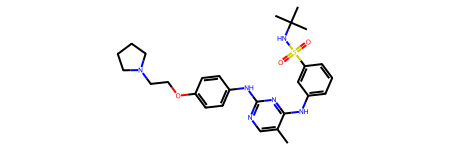

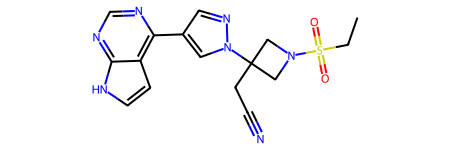

(None, None)

In [25]:

# mol_num = 5000
# model = VAE(vocab,vector).to(device)

# loader = gen_loader(test.sample(n=mol_num, random_state=1))
# visual_latent_space(loader, model)
# del loader

If need classifier, use gen_loader to build train_loader, otherwise, just use pd.dataframe['smiles']

cal QED/SA, delete invalid: 100%|██████████| 174618/174618 [07:04<00:00, 410.88it/s]


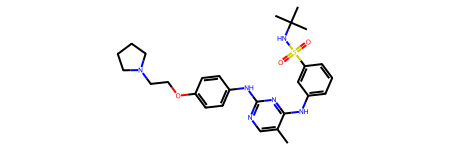

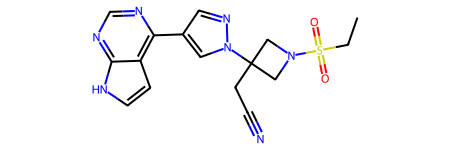

(None, None)

In [13]:
train_loader = gen_loader(train)

fed = 'Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1'
bar = 'CCS(=O)(=O)N1CC(C1)(CC#N)N2C=C(C=N2)C3=C4C=CNC4=NC=N3'
display(m(fed)), display(m(bar))


 34%|███▍      | 116/342 [00:17<00:34,  6.49it/s]

Epoch 0: 114/342 | ['loss=0.32493', '(kl=58.61129', 'recon=0.29721)', 'classify=0.05544', 'klw=0.00000 lr=0.00300']


 67%|██████▋   | 230/342 [00:35<00:17,  6.52it/s]

Epoch 0: 228/342 | ['loss=0.54445', '(kl=133.28794', 'recon=0.51264)', 'classify=0.06362', 'klw=0.00000 lr=0.00300']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 404.76it/s]

valid 4.000%  |  unique 1.000%


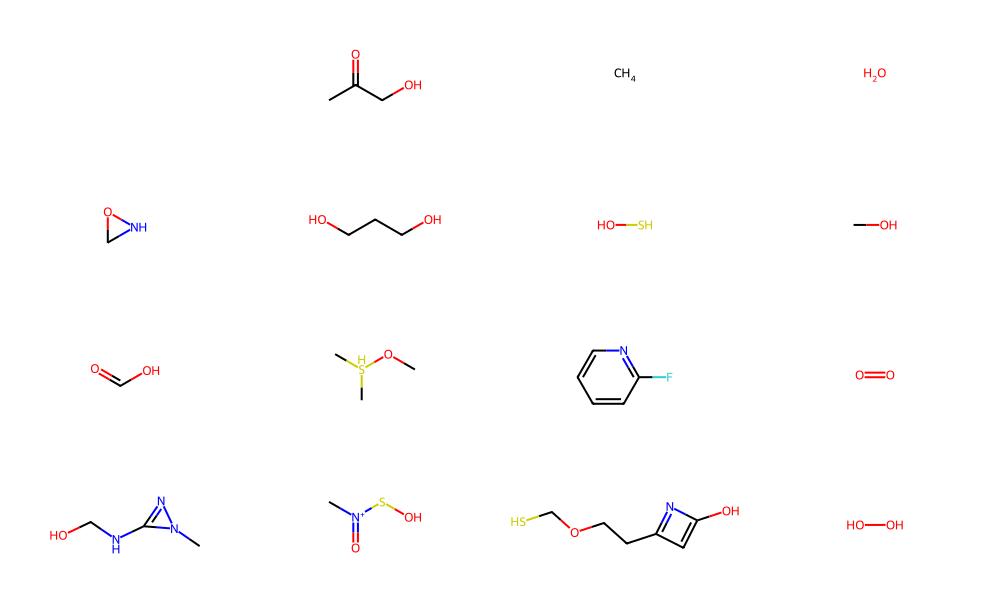

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: Cc1ccc(Cc(CC1cc(((C1)N(=O)N=O)N((=)(C)C(C(1ccc(C2(CCCCC(CCCCC
pred_mu smi: Cc1ccc(Cc(CC1cc(((C1)N(=O)N=O)N((=)(C)C(C(1ccc(C2(CCCCC(CCCCC
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 408.09it/s]


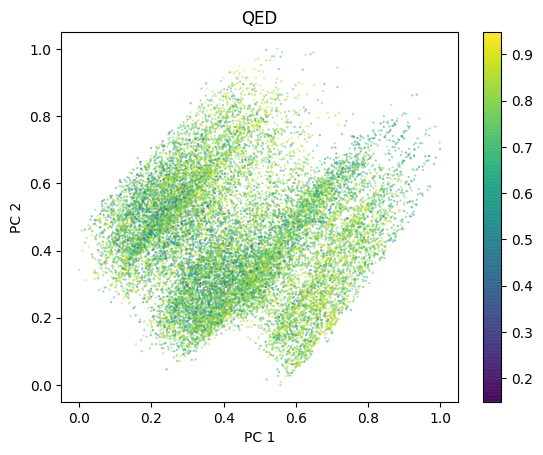

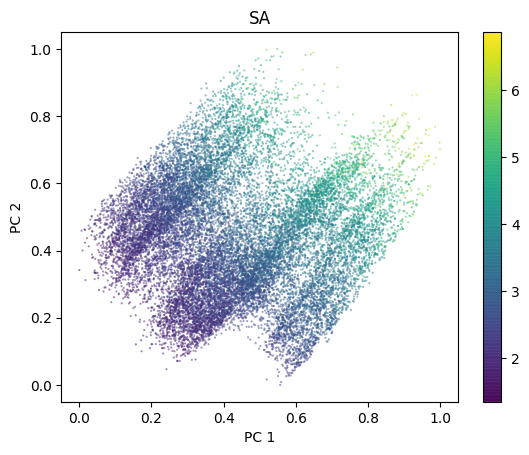

 34%|███▍      | 116/342 [00:18<00:35,  6.31it/s]

Epoch 1: 114/342 | ['loss=0.14607', '(kl=2.17400', 'recon=0.11847)', 'classify=0.01170', 'klw=0.01000 lr=0.00299']


 67%|██████▋   | 230/342 [00:35<00:17,  6.53it/s]

Epoch 1: 228/342 | ['loss=0.24062', '(kl=2.43784', 'recon=0.20790)', 'classify=0.01670', 'klw=0.01000 lr=0.00299']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 403.63it/s]


valid 31.867%  |  unique 31.867%


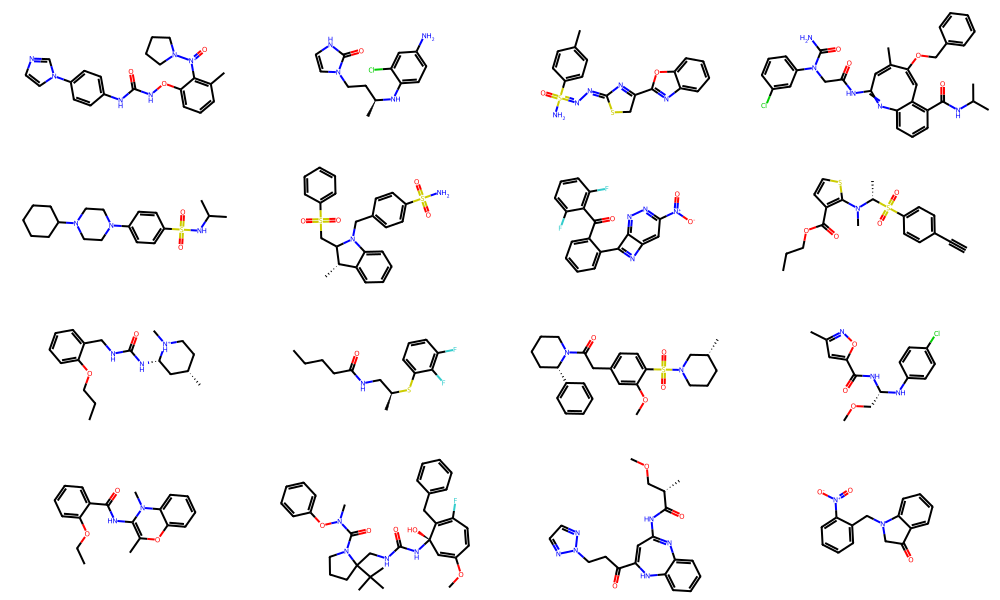

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: Cc1ncc(N22nC1ccc((N2)N(=O)(=O)c((C)(C)CCc11ccccC22CCC(O(C(OCC
pred_mu smi: Cc1ccc(C22CC1ncc((N2)N(=O)(=O)c(CC)(C)CCc11ccccC22CCCCO(CCOCC
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 404.63it/s]


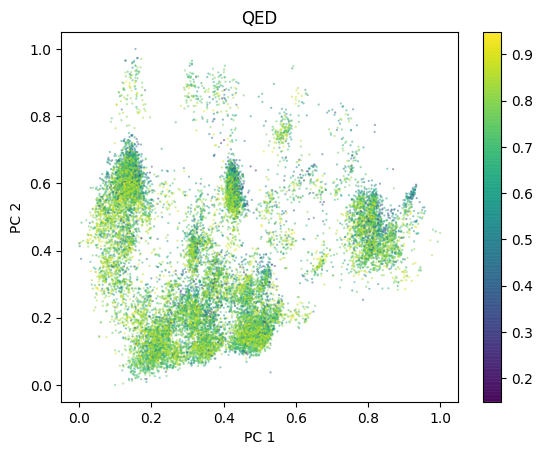

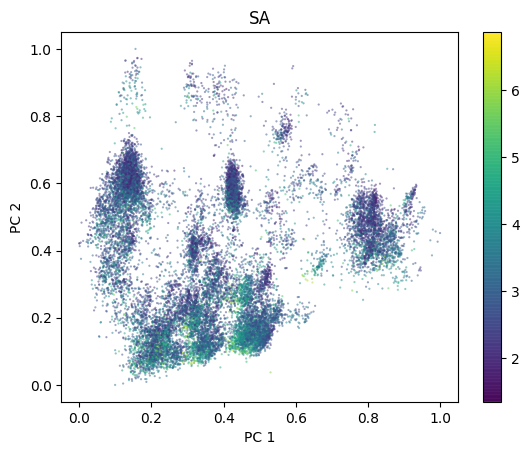

 34%|███▍      | 116/342 [00:18<00:35,  6.38it/s]

Epoch 2: 114/342 | ['loss=0.08190', '(kl=0.11396', 'recon=0.07779)', 'classify=0.00367', 'klw=0.02000 lr=0.00298']


 67%|██████▋   | 230/342 [00:35<00:17,  6.43it/s]

Epoch 2: 228/342 | ['loss=0.15896', '(kl=0.18352', 'recon=0.15203)', 'classify=0.00653', 'klw=0.02000 lr=0.00298']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 388.22it/s]


valid 59.167%  |  unique 59.167%


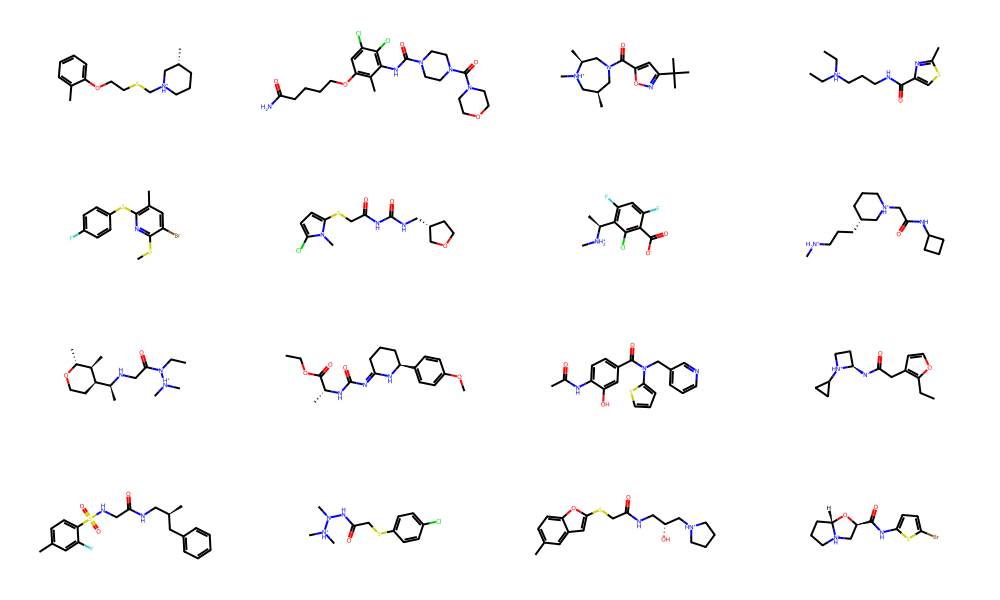

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: Cc1ccc(C22CC1ccc((C2)N(=O)(=O)c1CC)CC)C
pred_mu smi: Cc1ccc(C22CC1ccc((C2)N(=O)(=O)c11C)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 405.58it/s]


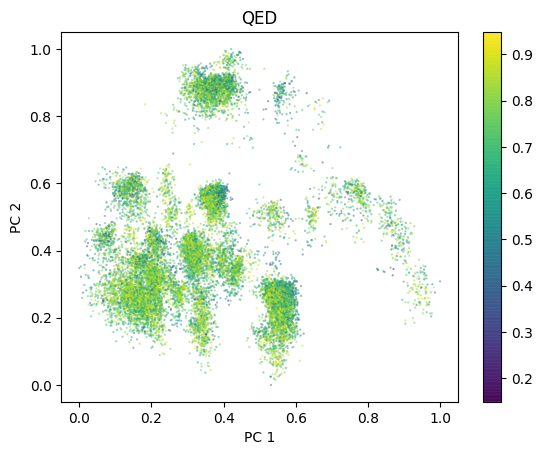

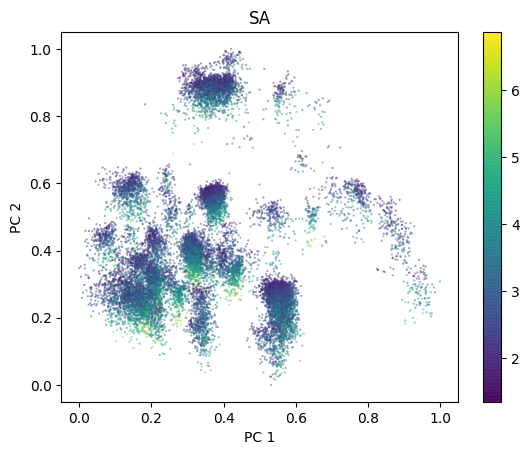

####################
save model ckpt.pt


 34%|███▎      | 115/342 [00:17<00:35,  6.42it/s]

Epoch 3: 114/342 | ['loss=0.07453', '(kl=0.02631', 'recon=0.07249)', 'classify=0.00250', 'klw=0.03000 lr=0.00296']


 67%|██████▋   | 230/342 [00:35<00:17,  6.50it/s]

Epoch 3: 228/342 | ['loss=0.14659', '(kl=0.03784', 'recon=0.14302)', 'classify=0.00487', 'klw=0.03000 lr=0.00296']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 385.71it/s]


valid 57.033%  |  unique 57.033%


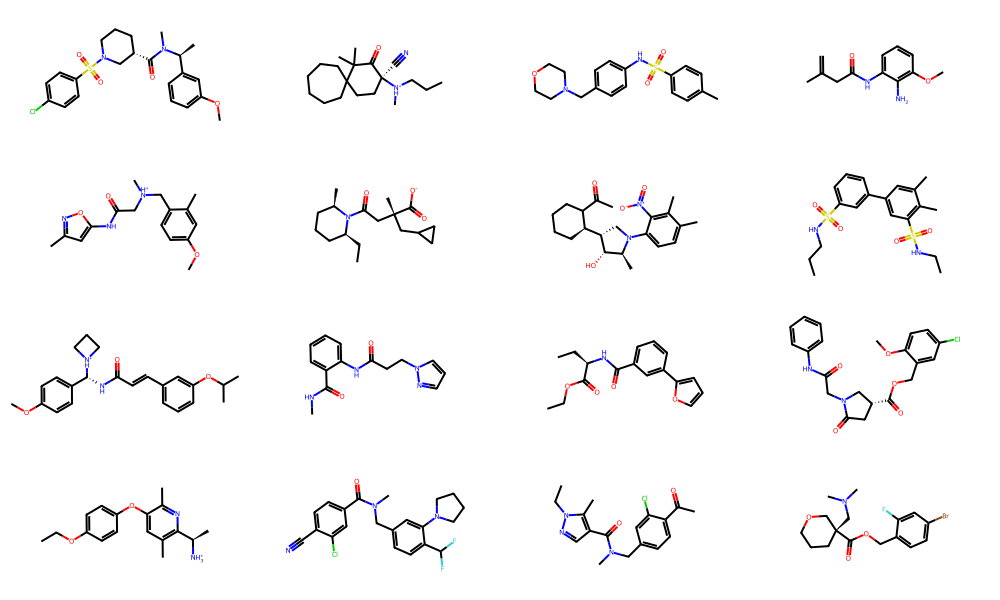

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C2(CC1ccc((C2)N(=O)(=O)cCc=)(C)C
pred_mu smi: CC1ccc(C2(CC1ccc((C2)[(=O)(=O)cCC=)(C)C1c11ccccC2(CCCCO(CCOCC=C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 403.68it/s]


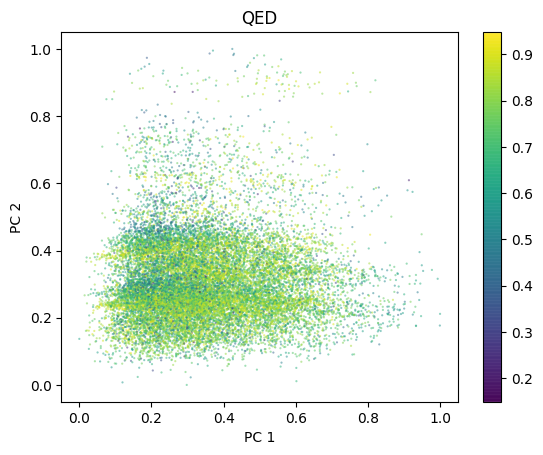

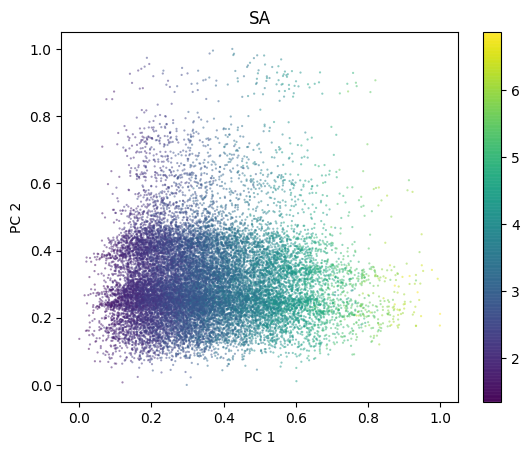

 34%|███▍      | 116/342 [00:18<00:35,  6.45it/s]

Epoch 4: 114/342 | ['loss=0.07112', '(kl=0.00672', 'recon=0.06980)', 'classify=0.00210', 'klw=0.04000 lr=0.00293']


 67%|██████▋   | 230/342 [00:36<00:20,  5.53it/s]

Epoch 4: 228/342 | ['loss=0.14047', '(kl=0.01189', 'recon=0.13798)', 'classify=0.00404', 'klw=0.04000 lr=0.00293']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 386.07it/s]


valid 73.033%  |  unique 73.033%


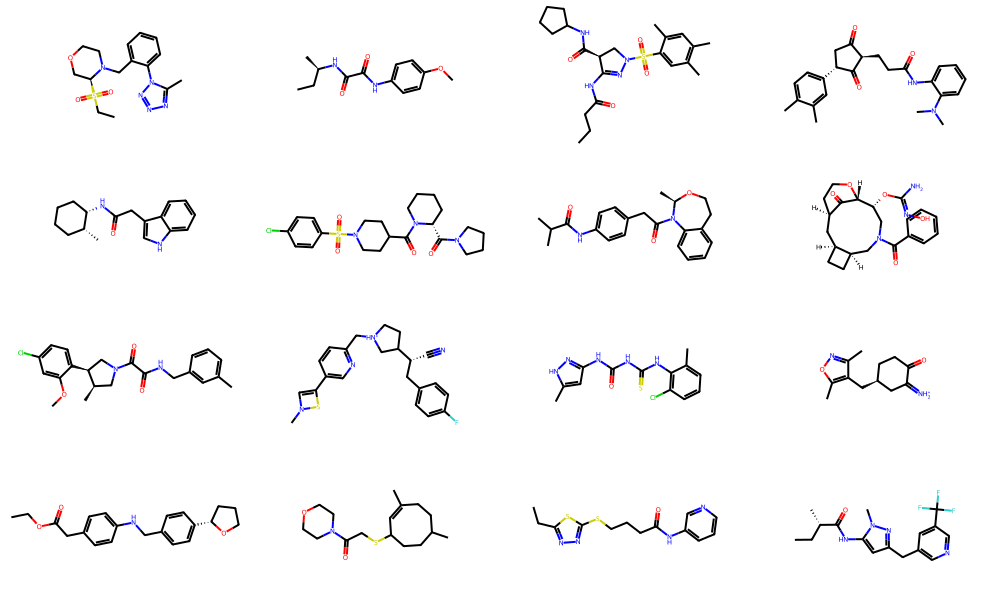

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22[C1ccc((C2)C(=O)(=O)c1CC)(C)C
pred_mu smi: CC1ccc(C22[C1ccc((C2)C(=O)(=O)c1C=)(C)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 401.52it/s]


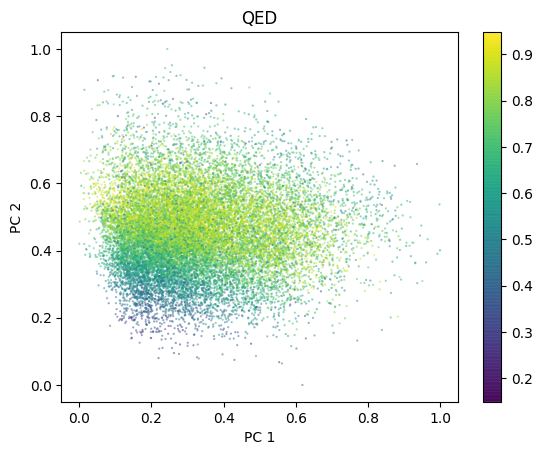

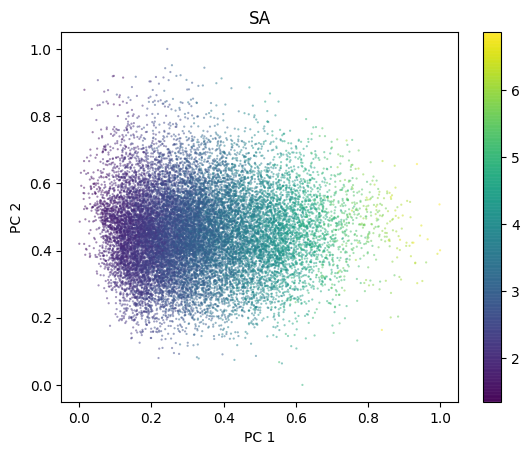

####################
save model ckpt.pt


 34%|███▍      | 116/342 [00:18<00:35,  6.32it/s]

Epoch 5: 114/342 | ['loss=0.06941', '(kl=0.00471', 'recon=0.06818)', 'classify=0.00199', 'klw=0.05000 lr=0.00291']


 67%|██████▋   | 230/342 [00:36<00:17,  6.39it/s]

Epoch 5: 228/342 | ['loss=0.13734', '(kl=0.00812', 'recon=0.13515)', 'classify=0.00358', 'klw=0.05000 lr=0.00291']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 397.29it/s]


valid 69.367%  |  unique 69.367%


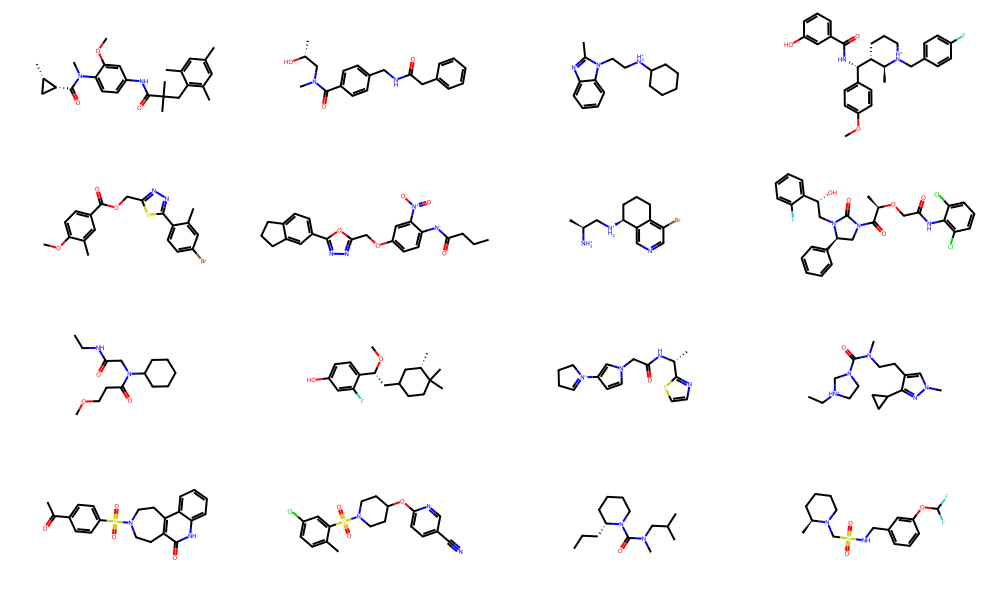

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C2([C1ccc((C2)[(=O)(=O)c(cC)(C)C
pred_mu smi: CC1ccc(C2([C1ccc((C2=[(=O)(=O)c(1C)(C)C[c(1ccccF2c
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 402.31it/s]


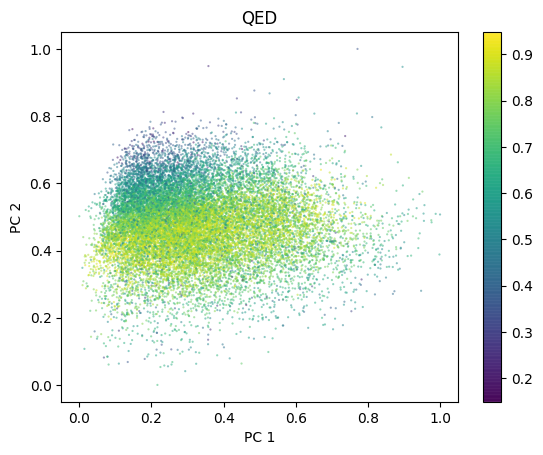

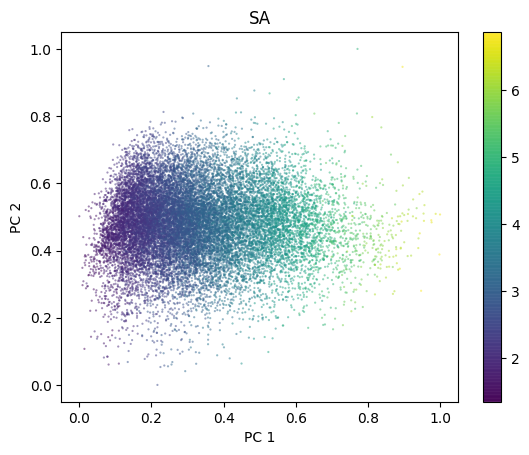

 34%|███▍      | 116/342 [00:18<00:35,  6.35it/s]

Epoch 6: 114/342 | ['loss=0.06793', '(kl=0.00296', 'recon=0.06692)', 'classify=0.00166', 'klw=0.06000 lr=0.00287']


 67%|██████▋   | 230/342 [00:36<00:18,  6.17it/s]

Epoch 6: 228/342 | ['loss=0.13494', '(kl=0.00561', 'recon=0.13304)', 'classify=0.00313', 'klw=0.06000 lr=0.00287']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 398.34it/s]


valid 74.000%  |  unique 74.000%


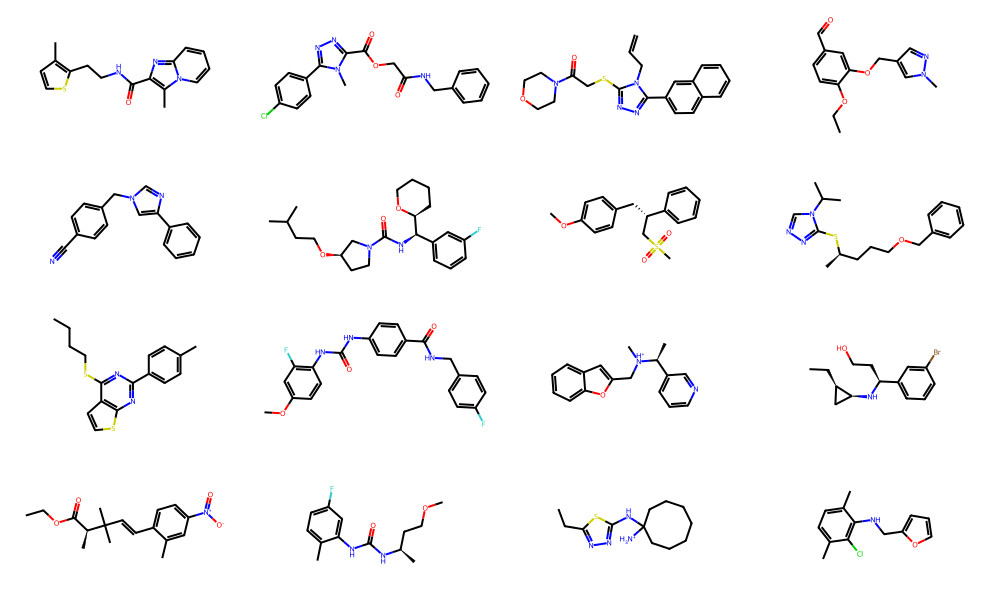

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22CC1ccc((C2=[(=O)(=O)cC1C)(C)C
pred_mu smi: CC1ccc(C22CC1ccc((C2)[(=O)(=O)c11C)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:50<00:00, 399.37it/s]


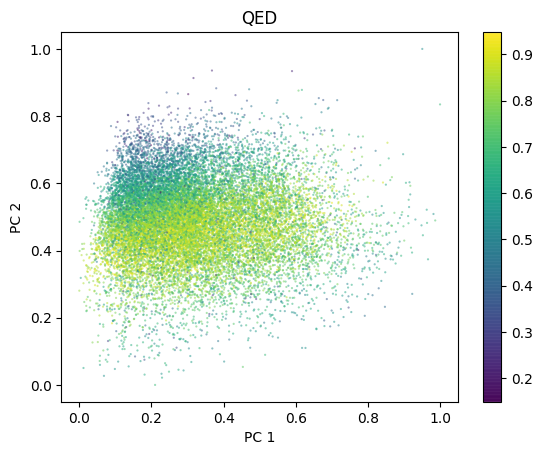

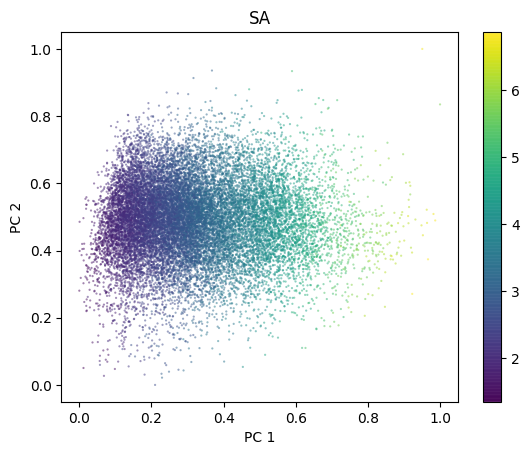

####################
save model ckpt.pt


 34%|███▍      | 116/342 [00:18<00:36,  6.26it/s]

Epoch 7: 114/342 | ['loss=0.06729', '(kl=0.00233', 'recon=0.06641)', 'classify=0.00143', 'klw=0.07000 lr=0.00283']


 67%|██████▋   | 230/342 [00:36<00:17,  6.43it/s]

Epoch 7: 228/342 | ['loss=0.13348', '(kl=0.00443', 'recon=0.13177)', 'classify=0.00279', 'klw=0.07000 lr=0.00283']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 399.80it/s]


valid 80.467%  |  unique 80.467%


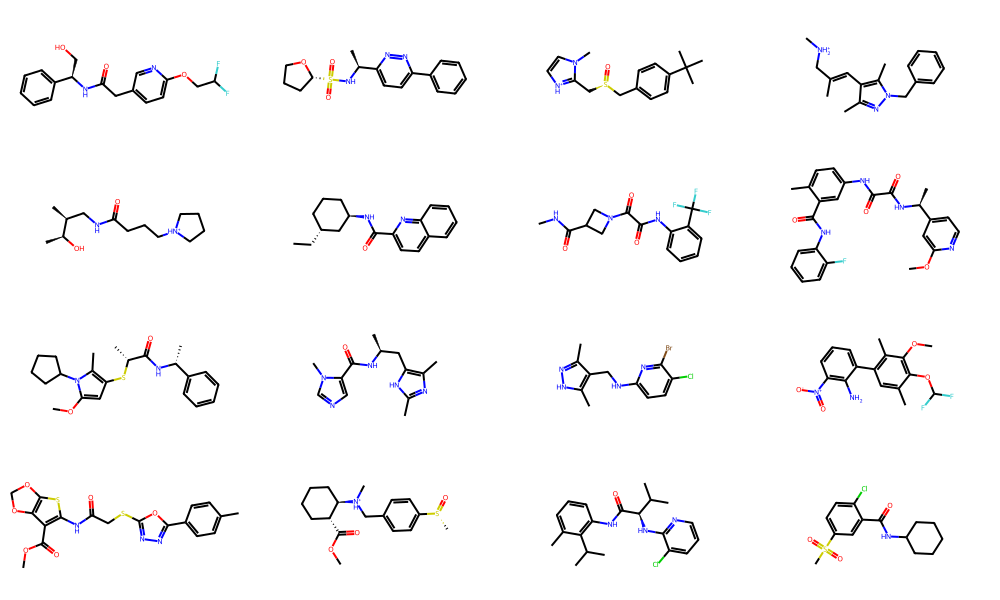

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(Cc(CC1ccc((C2)[[=O)(=O)c1(C)CC)C
pred_mu smi: CC1ccc(Cc2CC1ccc((C2)[(=O)(=O)c1cC)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 401.10it/s]


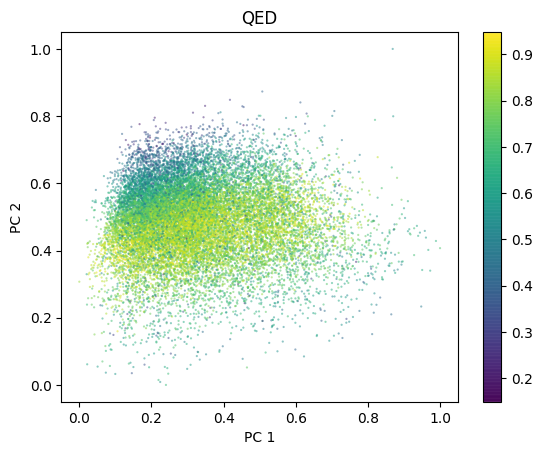

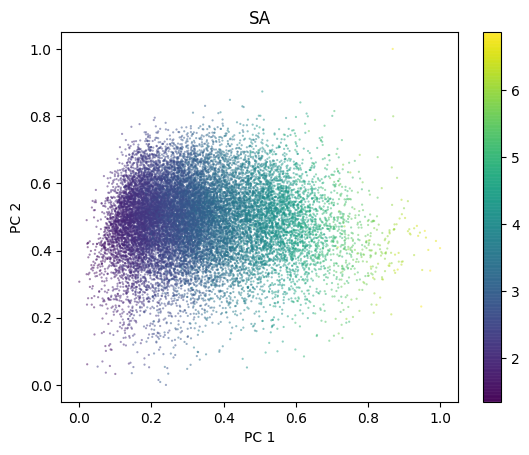

####################
save model ckpt.pt


 34%|███▍      | 116/342 [00:18<00:35,  6.28it/s]

Epoch 8: 114/342 | ['loss=0.06683', '(kl=0.00195', 'recon=0.06601)', 'classify=0.00133', 'klw=0.08000 lr=0.00279']


 67%|██████▋   | 230/342 [00:36<00:17,  6.45it/s]

Epoch 8: 228/342 | ['loss=0.13287', '(kl=0.00367', 'recon=0.13128)', 'classify=0.00260', 'klw=0.08000 lr=0.00279']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 401.87it/s]


valid 77.967%  |  unique 77.967%


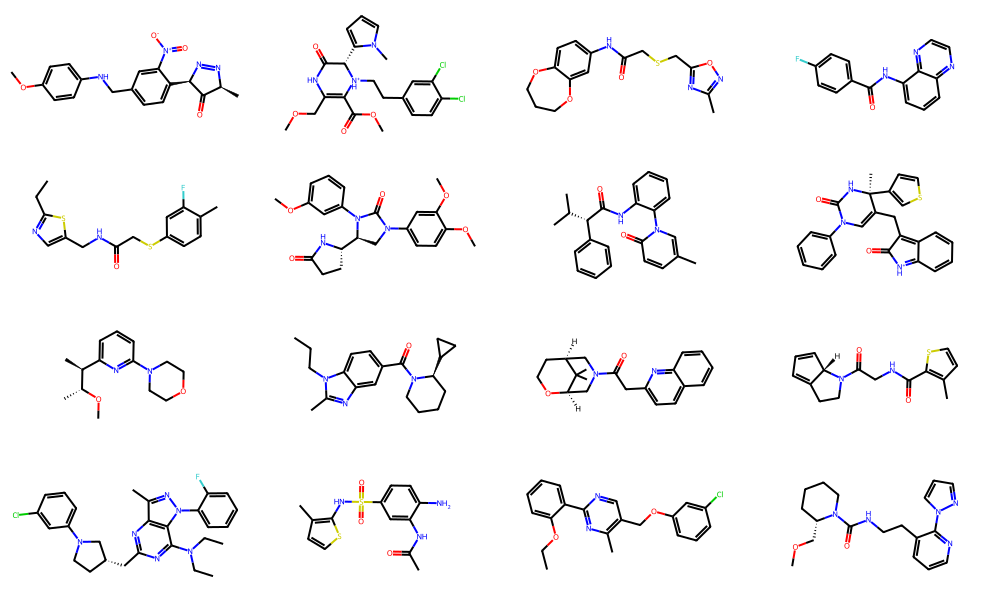

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22[C1ccc((C2nn(=O)(=O)c11C)(C)C
pred_mu smi: CC1ccc(C22[C1ccc((C2NN(=O)(=O)c11C)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:50<00:00, 399.96it/s]


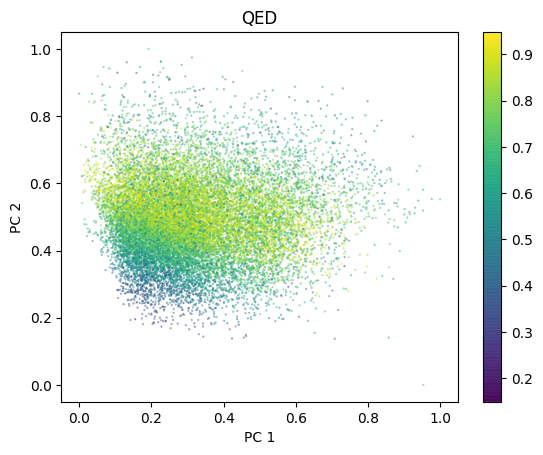

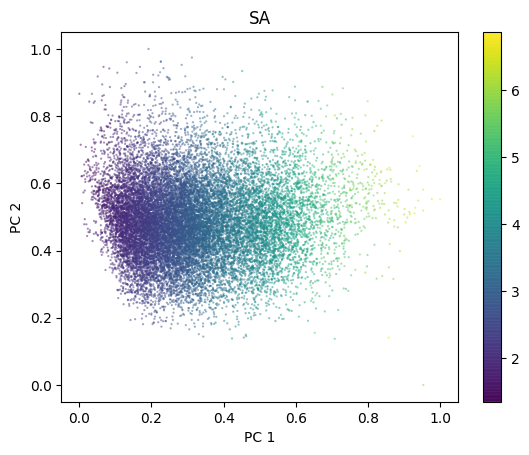

 34%|███▍      | 116/342 [00:18<00:36,  6.28it/s]

Epoch 9: 114/342 | ['loss=0.06641', '(kl=0.00229', 'recon=0.06543)', 'classify=0.00155', 'klw=0.09000 lr=0.00274']


 67%|██████▋   | 230/342 [00:36<00:17,  6.29it/s]

Epoch 9: 228/342 | ['loss=0.13179', '(kl=0.00373', 'recon=0.13016)', 'classify=0.00260', 'klw=0.09000 lr=0.00274']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 403.44it/s]


valid 82.400%  |  unique 82.400%


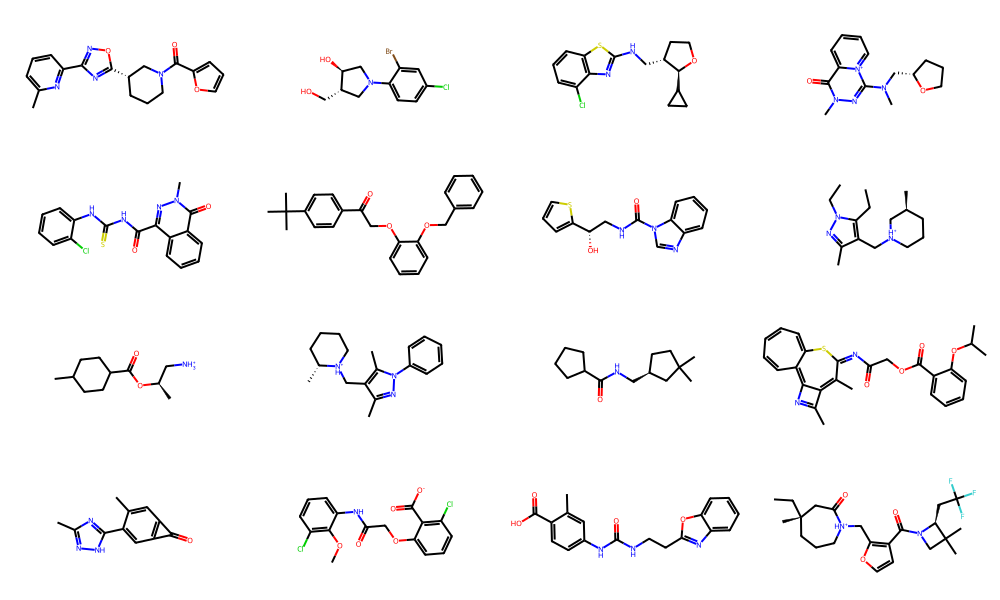

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(Cn(CC1ccc(cC2)C(CO)(=O)cC1C)CC)C
pred_mu smi: CC1ccc(C22CC1ccc(cC2)[(=O)(=O)cC1C)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 403.39it/s]


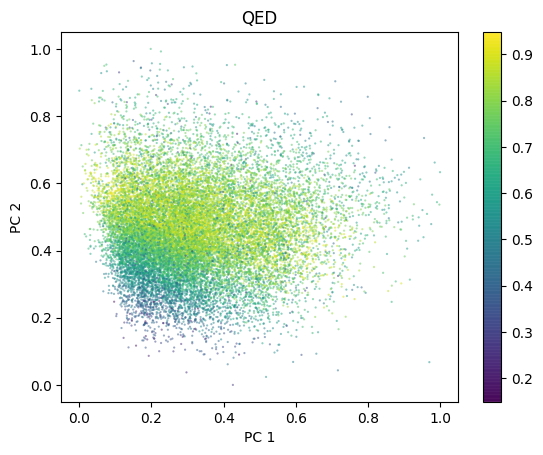

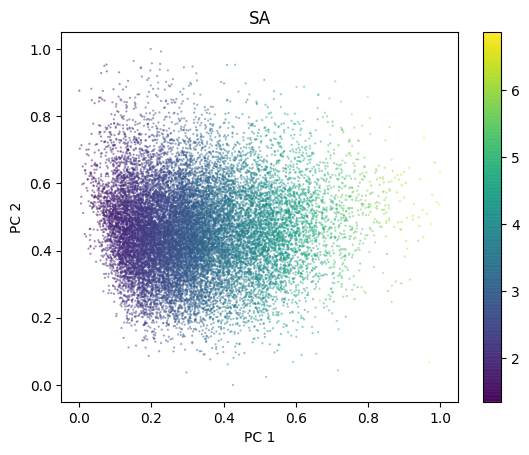

####################
save model ckpt.pt


 34%|███▍      | 116/342 [00:18<00:36,  6.25it/s]

Epoch 10: 114/342 | ['loss=0.06639', '(kl=0.00185', 'recon=0.06545)', 'classify=0.00153', 'klw=0.10000 lr=0.00269']


 67%|██████▋   | 230/342 [00:36<00:17,  6.51it/s]

Epoch 10: 228/342 | ['loss=0.13138', '(kl=0.00313', 'recon=0.12981)', 'classify=0.00253', 'klw=0.10000 lr=0.00269']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 404.84it/s]


valid 79.333%  |  unique 79.333%


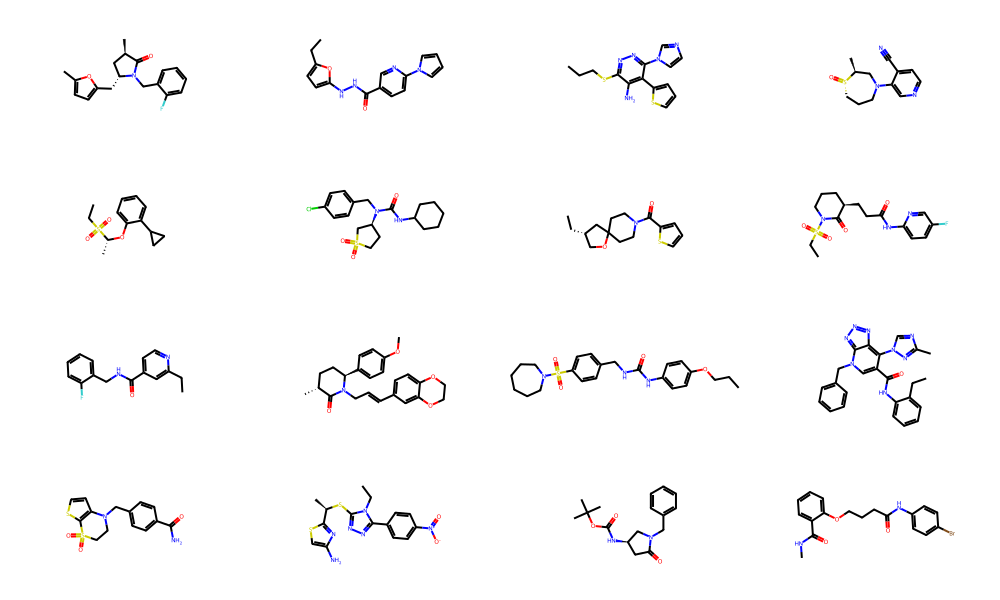

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C2([C1ccc((C2)N(=O)(=O)cCcC)(C)C
pred_mu smi: CC1ccc(C22[C1ccc((C2N[(=O)(=O)cCcC)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:50<00:00, 399.90it/s]


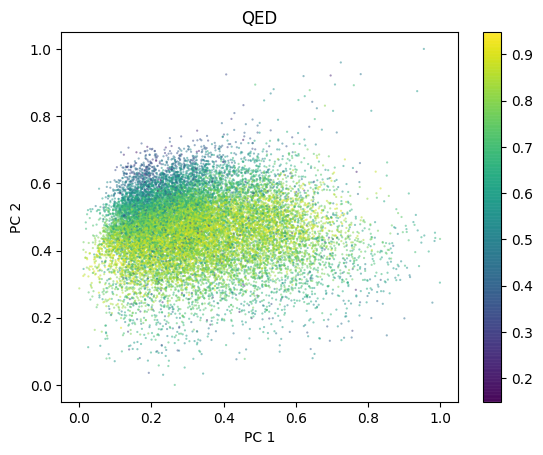

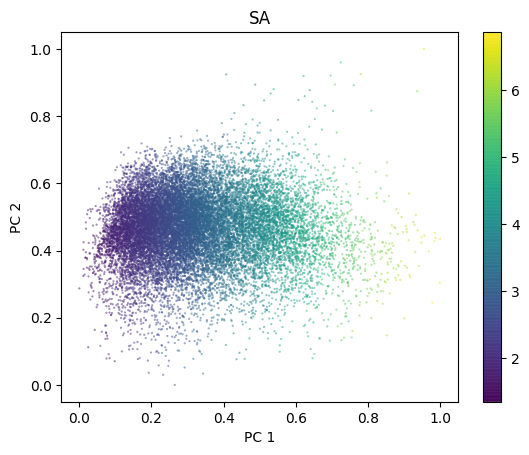

 34%|███▍      | 116/342 [00:18<00:34,  6.46it/s]

Epoch 11: 114/342 | ['loss=0.06586', '(kl=0.00122', 'recon=0.06520)', 'classify=0.00106', 'klw=0.11000 lr=0.00263']


 67%|██████▋   | 230/342 [00:36<00:17,  6.38it/s]

Epoch 11: 228/342 | ['loss=0.13072', '(kl=0.00224', 'recon=0.12946)', 'classify=0.00203', 'klw=0.11000 lr=0.00263']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 403.64it/s]


valid 80.367%  |  unique 80.367%


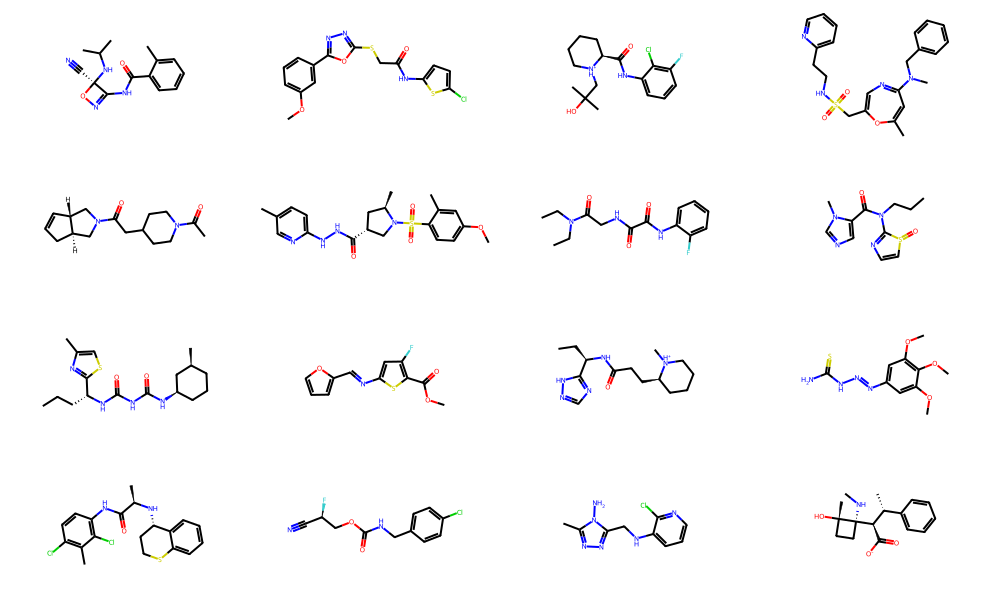

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22CC1ccc((C2)C(=O)(=O)c((C)(C)C
pred_mu smi: CC1ccc(C22CC1ccc((C2)[(=O)(=O)c1(C)(C)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 401.95it/s]


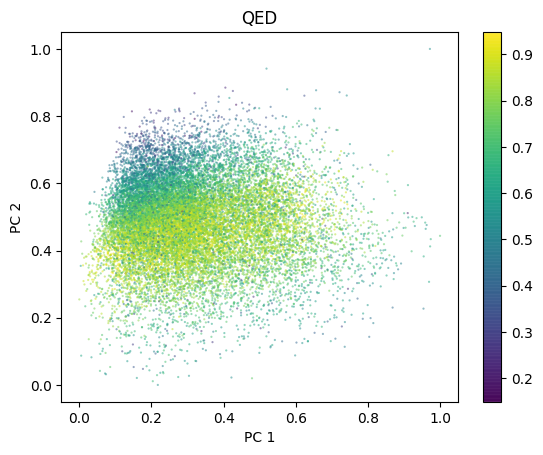

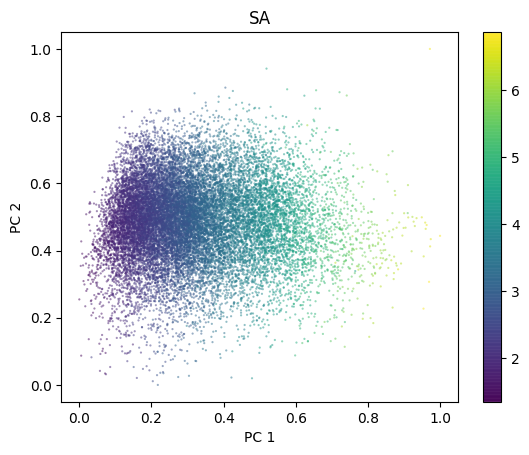

 34%|███▍      | 116/342 [00:18<00:35,  6.30it/s]

Epoch 12: 114/342 | ['loss=0.11832', '(kl=0.15576', 'recon=0.06519)', 'classify=0.06887', 'klw=0.12000 lr=0.00257']


 67%|██████▋   | 230/342 [00:36<00:17,  6.42it/s]

Epoch 12: 228/342 | ['loss=0.18747', '(kl=0.16902', 'recon=0.12934)', 'classify=0.07570', 'klw=0.12000 lr=0.00257']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 402.23it/s]


valid 80.400%  |  unique 80.400%


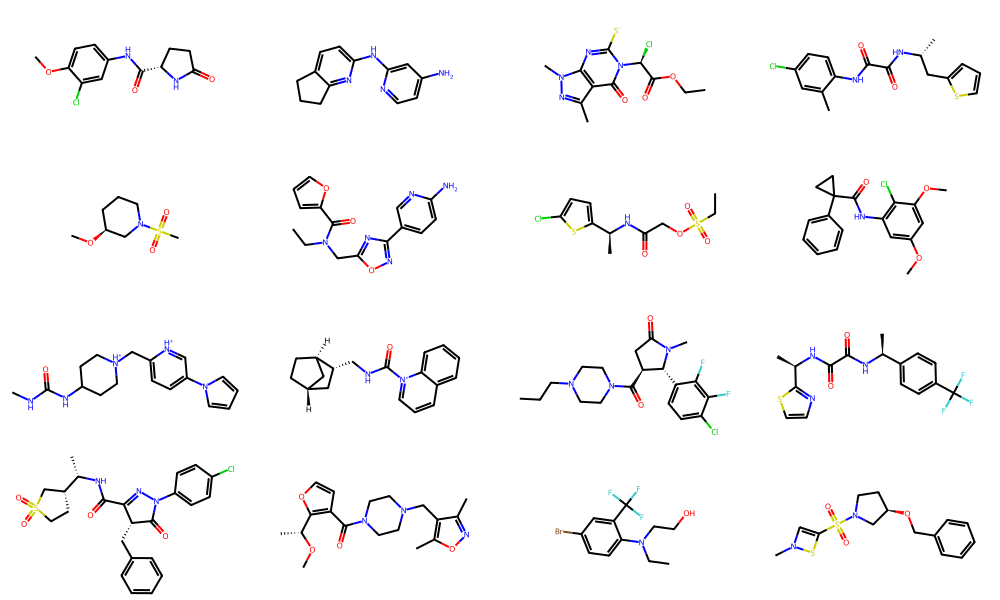

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22[C1ccc((C2)N(=O)(=O)N[CC)CC)C
pred_mu smi: CC1ccc(C22[C1ccc((C2)[(=O)(=O)c1(C)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 401.76it/s]


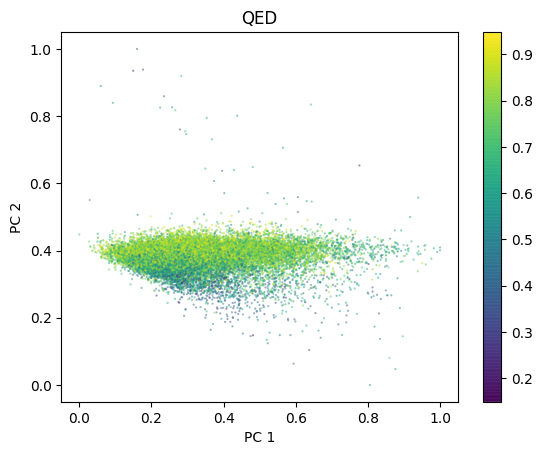

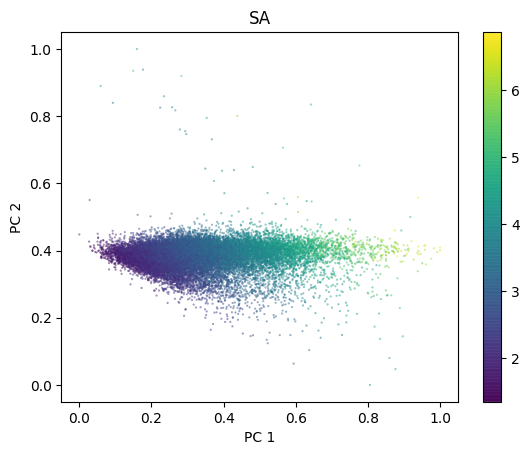

 34%|███▍      | 116/342 [00:18<00:36,  6.13it/s]

Epoch 13: 114/342 | ['loss=0.06692', '(kl=0.00493', 'recon=0.06470)', 'classify=0.00316', 'klw=0.13000 lr=0.00251']


 67%|██████▋   | 230/342 [00:36<00:17,  6.27it/s]

Epoch 13: 228/342 | ['loss=0.13269', '(kl=0.00834', 'recon=0.12853)', 'classify=0.00614', 'klw=0.13000 lr=0.00251']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 402.05it/s]


valid 80.533%  |  unique 80.533%


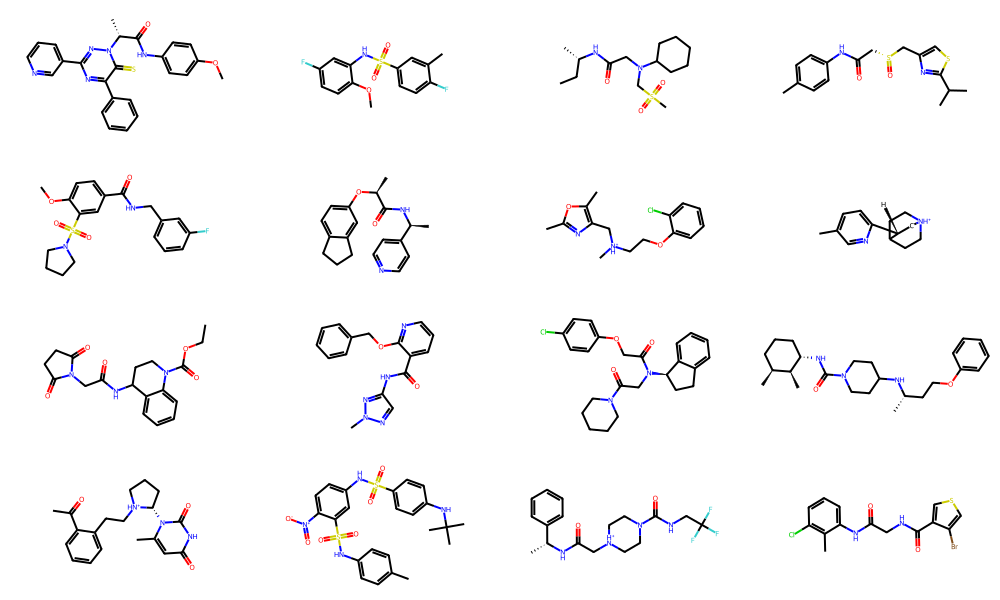

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(N2(CC1ccc((C2)[(=O)(=O)c1cC)(C)C
pred_mu smi: CC1ccc(C22CC1ccc((C2)[(=O)(=O)c1cC)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 401.89it/s]


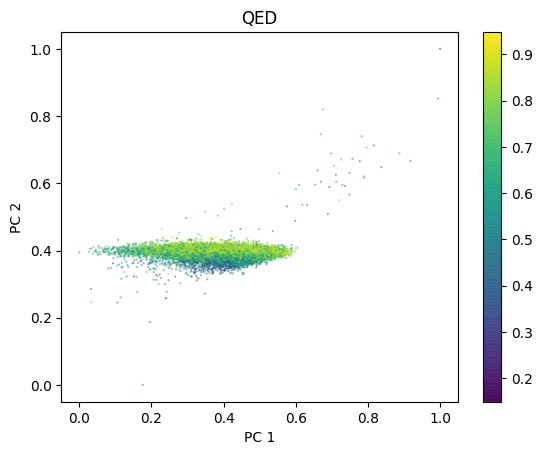

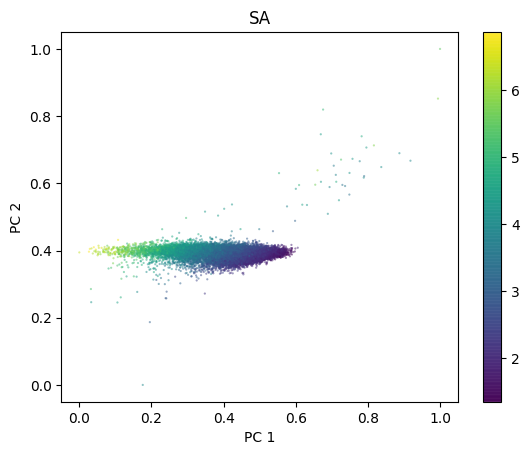

 34%|███▍      | 116/342 [00:18<00:35,  6.28it/s]

Epoch 14: 114/342 | ['loss=0.06666', '(kl=0.00353', 'recon=0.06450)', 'classify=0.00333', 'klw=0.14000 lr=0.00244']


 67%|██████▋   | 230/342 [00:35<00:18,  5.97it/s]

Epoch 14: 228/342 | ['loss=0.13192', '(kl=0.00616', 'recon=0.12815)', 'classify=0.00580', 'klw=0.14000 lr=0.00244']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 399.53it/s]


valid 79.700%  |  unique 79.700%


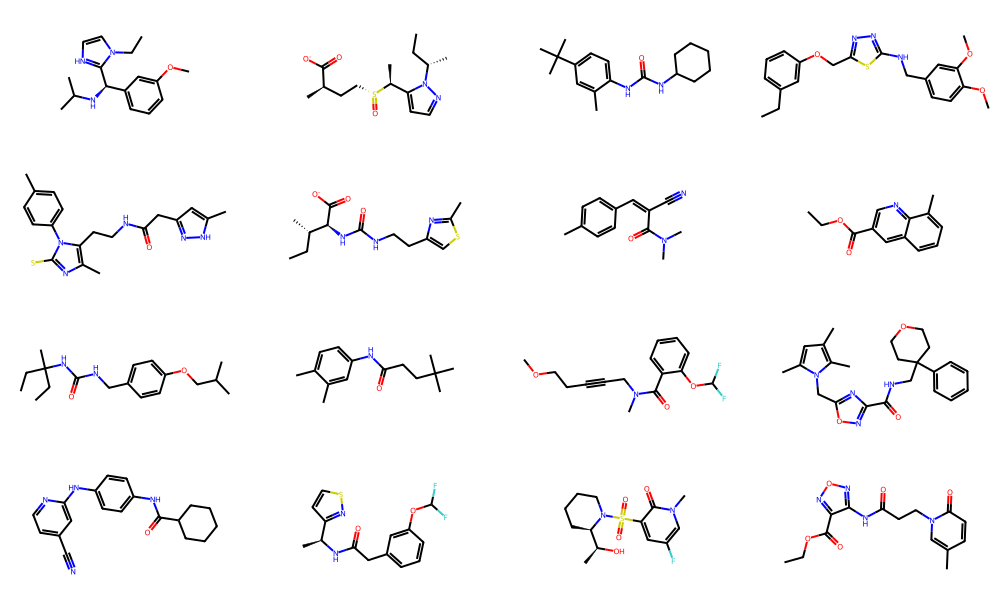

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(Cc2CC1ccc((C2)N(=O)(=O)c11C)(C)C
pred_mu smi: CC1ccc(C22CC1ccc((C2)C(=O)(=O)c11C)(C)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:50<00:00, 397.74it/s]


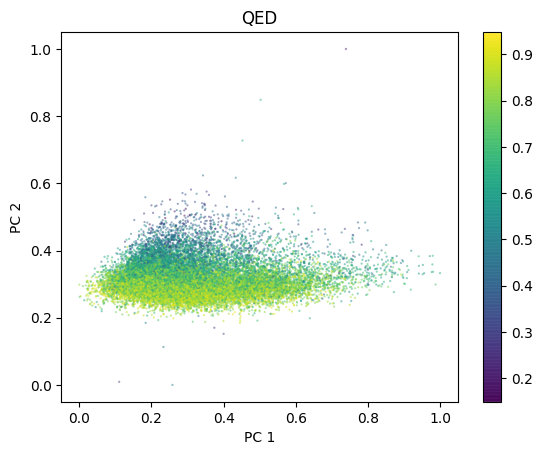

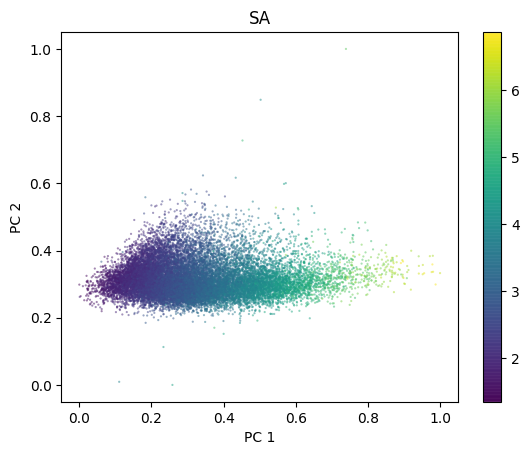

 34%|███▍      | 116/342 [00:18<00:34,  6.49it/s]

Epoch 15: 114/342 | ['loss=0.06599', '(kl=0.00194', 'recon=0.06441)', 'classify=0.00257', 'klw=0.15000 lr=0.00237']


 67%|██████▋   | 230/342 [00:36<00:18,  6.21it/s]

Epoch 15: 228/342 | ['loss=0.13069', '(kl=0.00348', 'recon=0.12789)', 'classify=0.00454', 'klw=0.15000 lr=0.00237']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 401.88it/s]


valid 81.667%  |  unique 81.667%


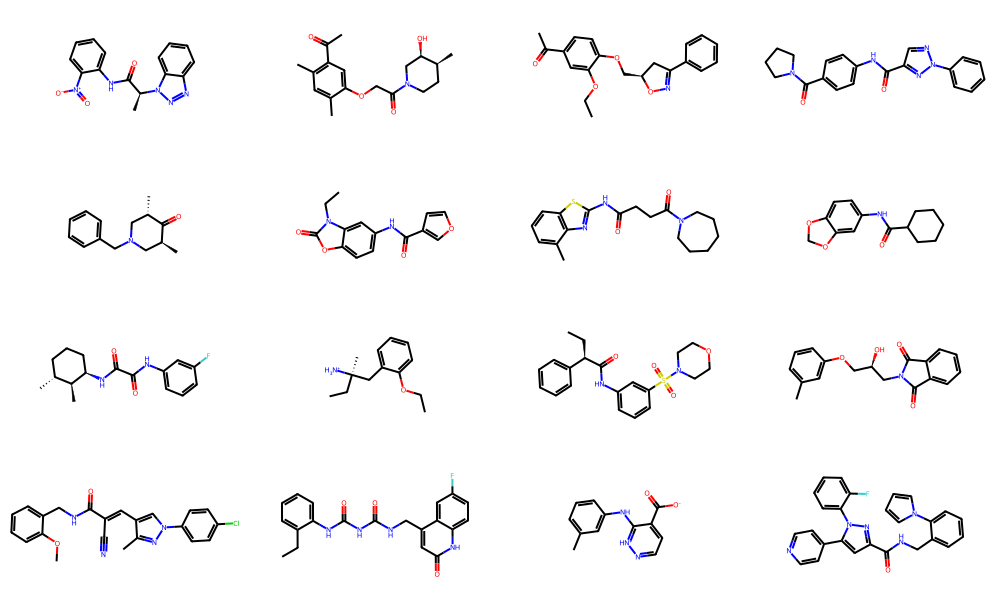

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22CC1ccc(cC2)c(=O)(=O)cccC)CC)C
pred_mu smi: CC1ccc(C22[C1ccc(cC2)[(=O)(=O)c1cC)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 400.93it/s]


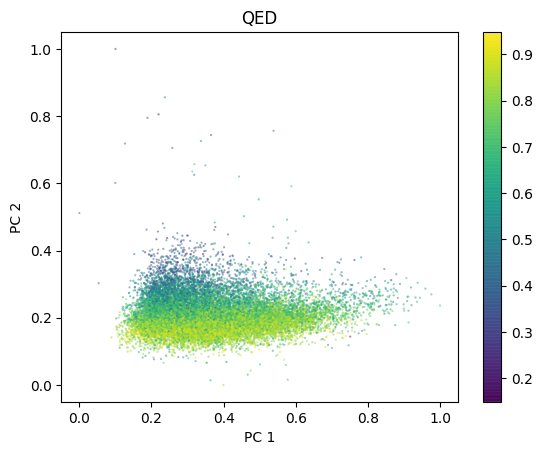

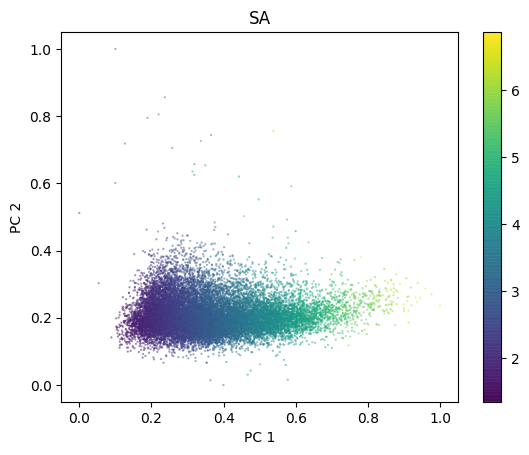

 34%|███▍      | 116/342 [00:18<00:34,  6.48it/s]

Epoch 16: 114/342 | ['loss=0.06546', '(kl=0.00175', 'recon=0.06400)', 'classify=0.00236', 'klw=0.16000 lr=0.00230']


 67%|██████▋   | 230/342 [00:36<00:17,  6.37it/s]

Epoch 16: 228/342 | ['loss=0.12987', '(kl=0.00303', 'recon=0.12744)', 'classify=0.00390', 'klw=0.16000 lr=0.00230']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 401.20it/s]


valid 83.767%  |  unique 83.767%


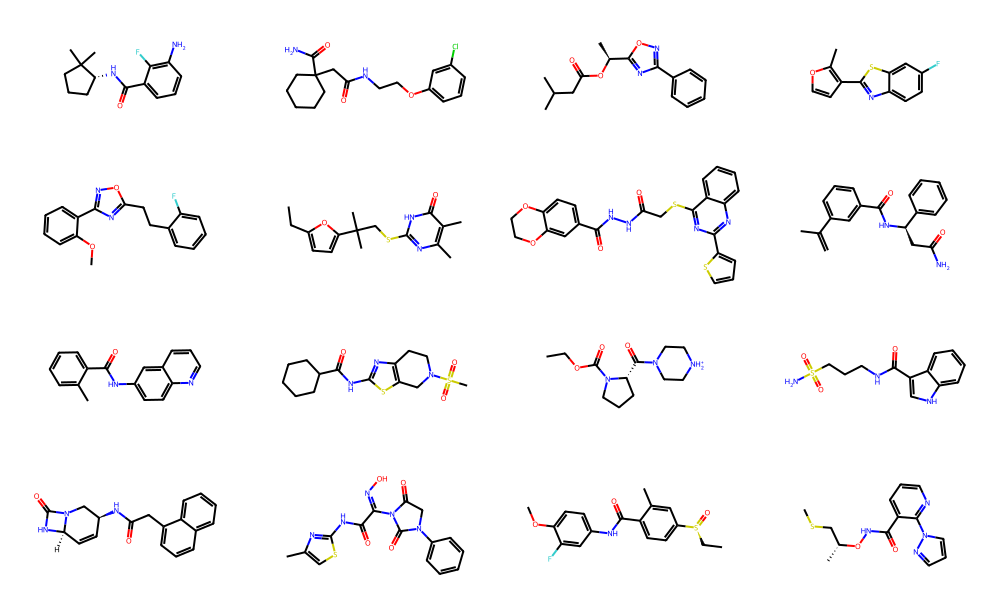

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22[C1ccc((C2)[(=O)(=O)cccC)CC)C
pred_mu smi: CC1ccc(C22CC1ccc((C2)C(=O)(=O)cCcC)CC)C)c11ccccC2cCOCC(1CCOC1=C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:50<00:00, 399.00it/s]


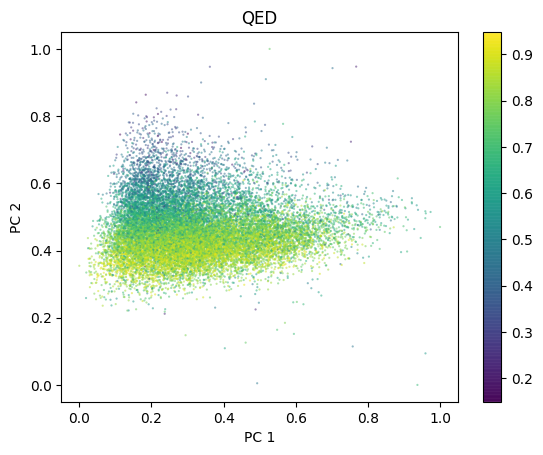

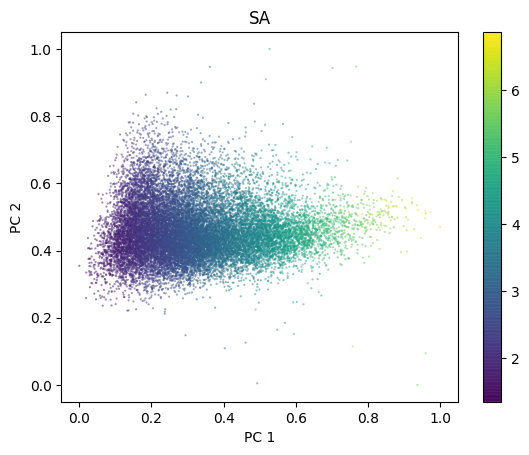

####################
save model ckpt.pt


 34%|███▍      | 116/342 [00:18<00:35,  6.41it/s]

Epoch 17: 114/342 | ['loss=0.06465', '(kl=0.00107', 'recon=0.06379)', 'classify=0.00136', 'klw=0.17000 lr=0.00222']


 67%|██████▋   | 230/342 [00:36<00:17,  6.52it/s]

Epoch 17: 228/342 | ['loss=0.12850', '(kl=0.00206', 'recon=0.12679)', 'classify=0.00272', 'klw=0.17000 lr=0.00222']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 396.45it/s]


valid 83.300%  |  unique 83.300%


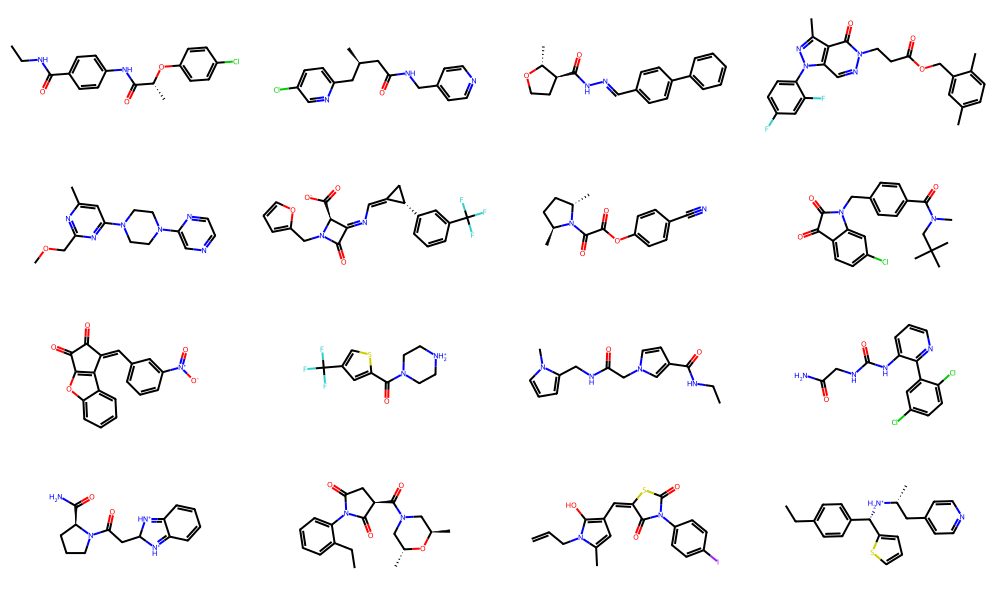

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(Cc(CC1ccc((C2N[(=O)(=O)cCCC)(C)C
pred_mu smi: CC1ccc(C2(CC1ccc((C2)[(=O)(=O)cCCC)(C)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:50<00:00, 399.95it/s]


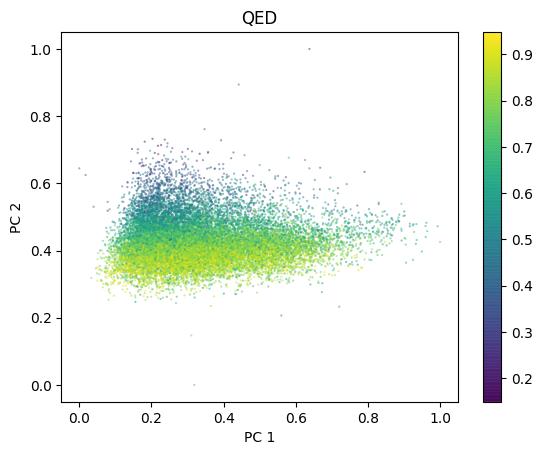

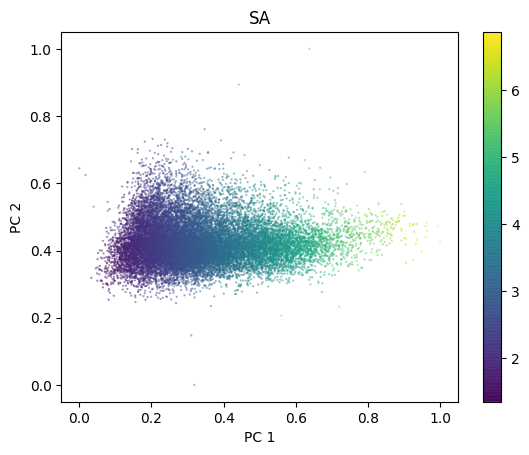

 34%|███▍      | 116/342 [00:18<00:35,  6.36it/s]

Epoch 18: 114/342 | ['loss=0.06503', '(kl=0.00145', 'recon=0.06380)', 'classify=0.00194', 'klw=0.18000 lr=0.00215']


 67%|██████▋   | 230/342 [00:36<00:17,  6.37it/s]

Epoch 18: 228/342 | ['loss=0.12869', '(kl=0.00247', 'recon=0.12667)', 'classify=0.00316', 'klw=0.18000 lr=0.00215']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 381.81it/s]


valid 84.567%  |  unique 84.567%


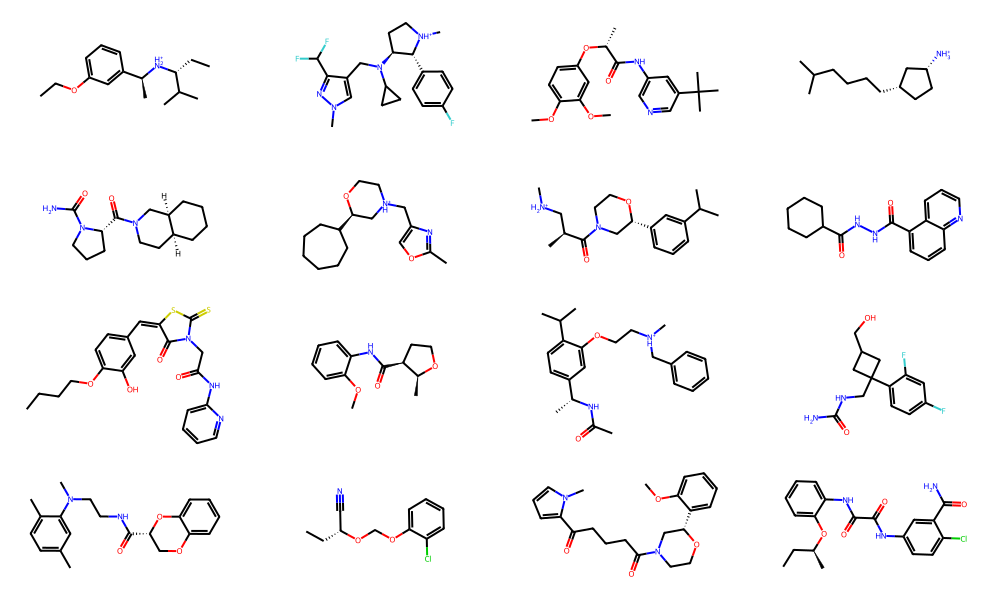

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22[C1ccc((C2=NC=O)(=O)NCcC)CC)C
pred_mu smi: CC1ccc(C22CC1ccc((C2NC(=O)(=O)c(cC)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 401.36it/s]


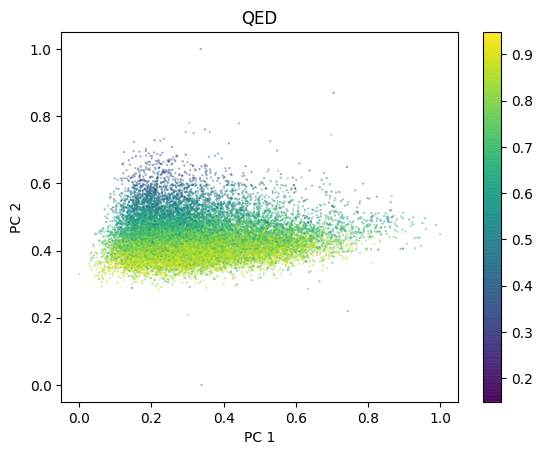

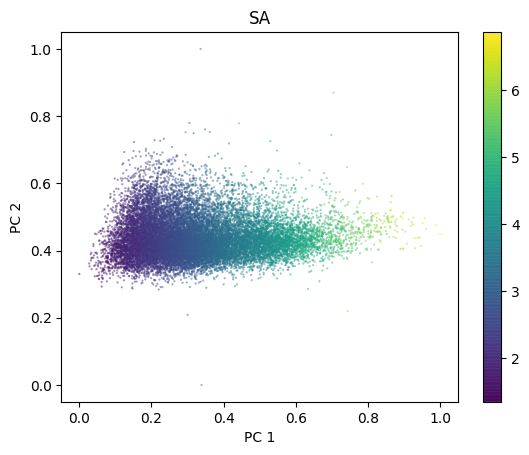

####################
save model ckpt.pt


 34%|███▍      | 116/342 [00:18<00:34,  6.51it/s]

Epoch 19: 114/342 | ['loss=0.06430', '(kl=0.00098', 'recon=0.06349)', 'classify=0.00124', 'klw=0.19000 lr=0.00207']


 67%|██████▋   | 230/342 [00:36<00:17,  6.45it/s]

Epoch 19: 228/342 | ['loss=0.12747', '(kl=0.00184', 'recon=0.12594)', 'classify=0.00236', 'klw=0.19000 lr=0.00207']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 379.82it/s]


valid 85.667%  |  unique 85.667%


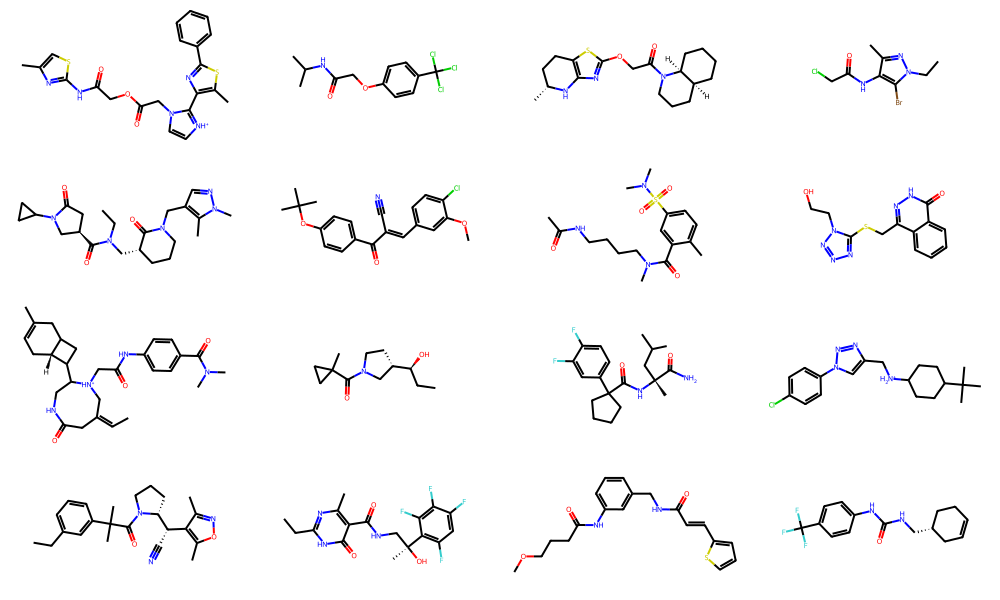

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C2(CC1ccc((C2)[(CO)(=O)c11C)CC)C
pred_mu smi: CC1ccc(C2(CC1ccc((C2)[(=O)(=O)cCcC)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 403.60it/s]


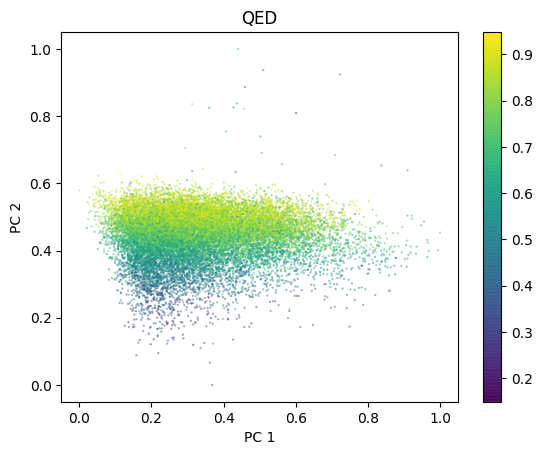

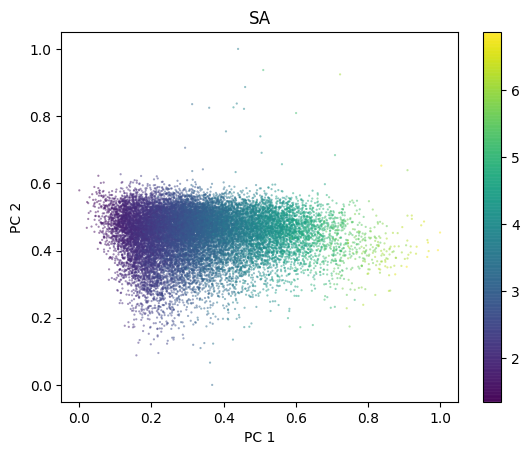

####################
save model ckpt.pt


 34%|███▍      | 116/342 [00:18<00:35,  6.42it/s]

Epoch 20: 114/342 | ['loss=0.06385', '(kl=0.00095', 'recon=0.06298)', 'classify=0.00135', 'klw=0.20000 lr=0.00199']


 67%|██████▋   | 230/342 [00:36<00:17,  6.53it/s]

Epoch 20: 228/342 | ['loss=0.12658', '(kl=0.00177', 'recon=0.12500)', 'classify=0.00246', 'klw=0.20000 lr=0.00199']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 381.69it/s]


valid 81.100%  |  unique 81.100%


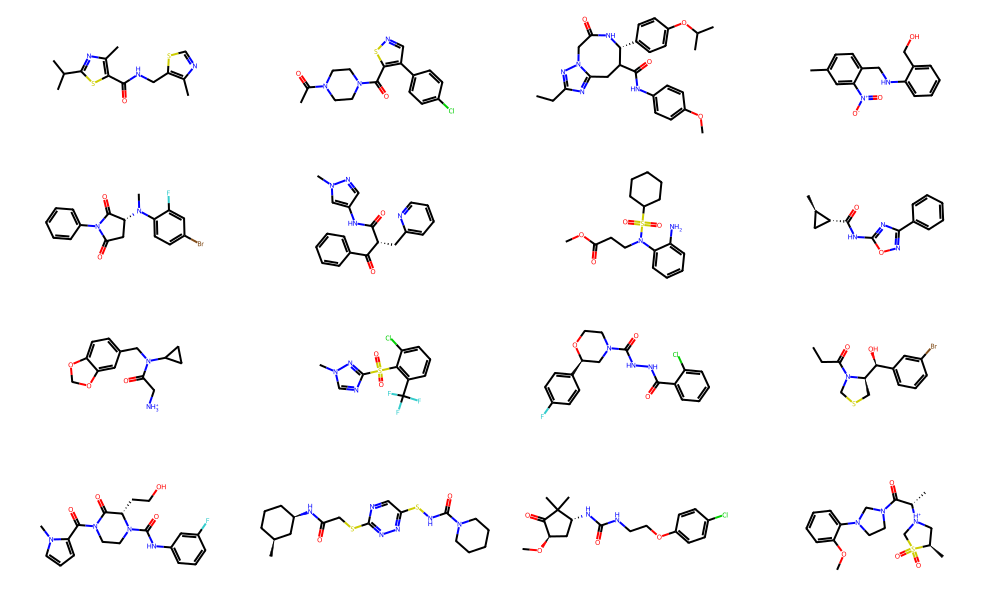

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22CC1ccc((C2N[(=O)(=O)c11C)CC)C
pred_mu smi: CC1ccc(C22CC1ncc((C2N[(=O)(=O)c11C)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 400.80it/s]


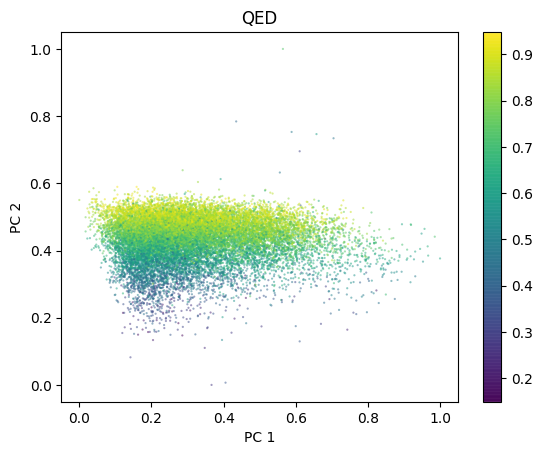

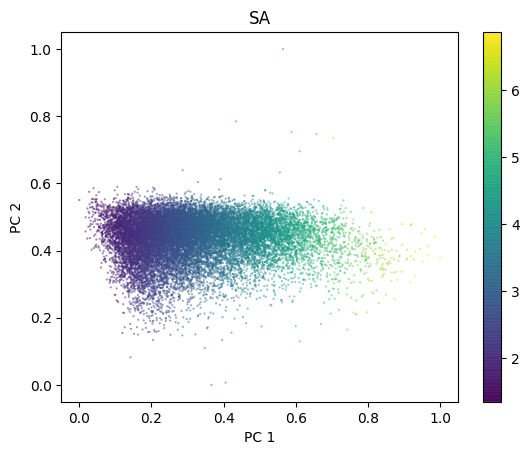

 34%|███▍      | 116/342 [00:18<00:34,  6.51it/s]

Epoch 21: 114/342 | ['loss=0.06325', '(kl=0.00077', 'recon=0.06254)', 'classify=0.00110', 'klw=0.21000 lr=0.00190']


 67%|██████▋   | 230/342 [00:36<00:17,  6.29it/s]

Epoch 21: 228/342 | ['loss=0.12575', '(kl=0.00153', 'recon=0.12433)', 'classify=0.00221', 'klw=0.21000 lr=0.00190']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 392.37it/s]


valid 84.967%  |  unique 84.967%


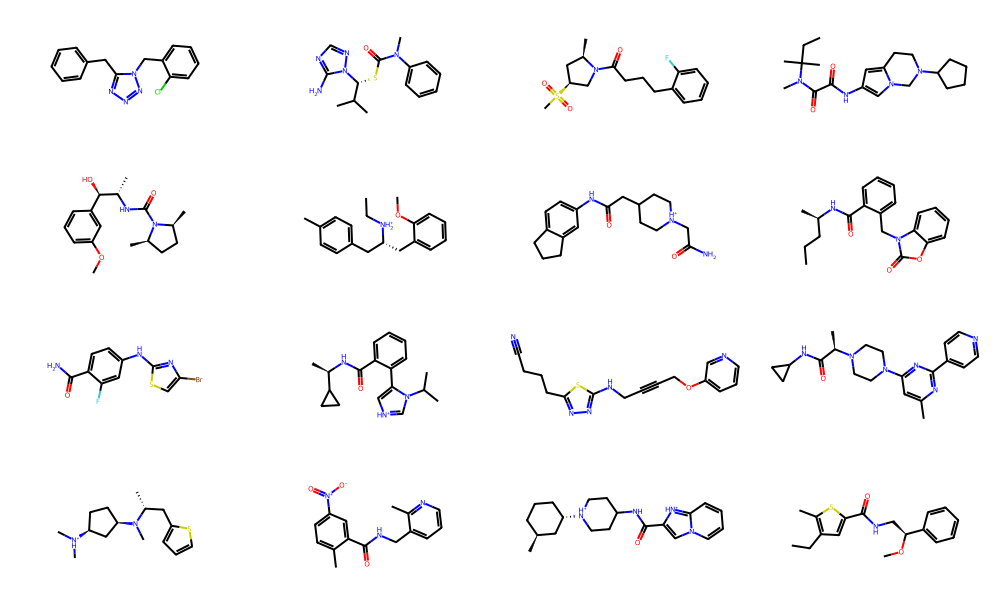

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22[C1ccc(cC2)[(=O)(=O)c1cC)CC)C
pred_mu smi: CC1ccc(C22CC1ncc(cC2)[C=O)(=O)c(1C)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 400.05it/s]


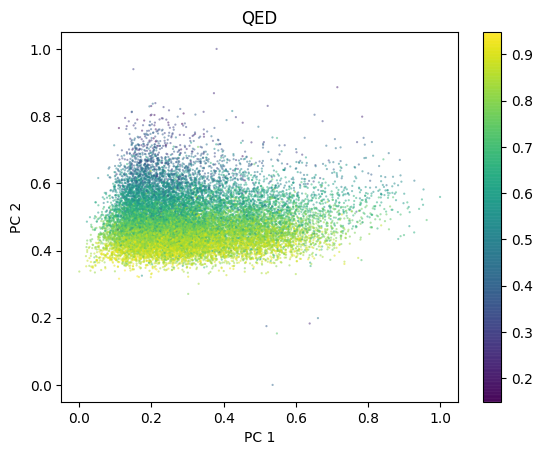

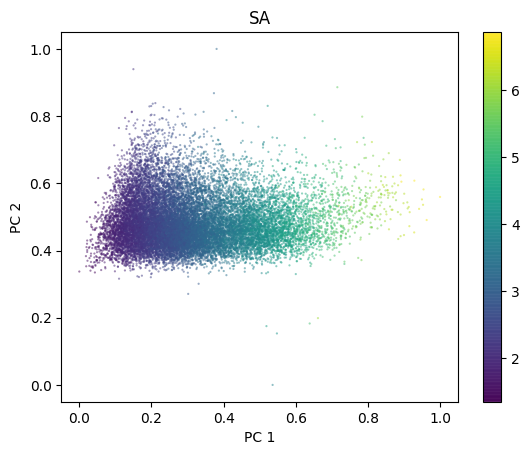

 34%|███▍      | 116/342 [00:18<00:37,  6.04it/s]

Epoch 22: 114/342 | ['loss=0.06290', '(kl=0.00074', 'recon=0.06223)', 'classify=0.00102', 'klw=0.22000 lr=0.00182']


 67%|██████▋   | 230/342 [00:36<00:17,  6.22it/s]

Epoch 22: 228/342 | ['loss=0.12617', '(kl=0.00143', 'recon=0.12486)', 'classify=0.00199', 'klw=0.22000 lr=0.00182']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 398.20it/s]


valid 86.000%  |  unique 86.000%


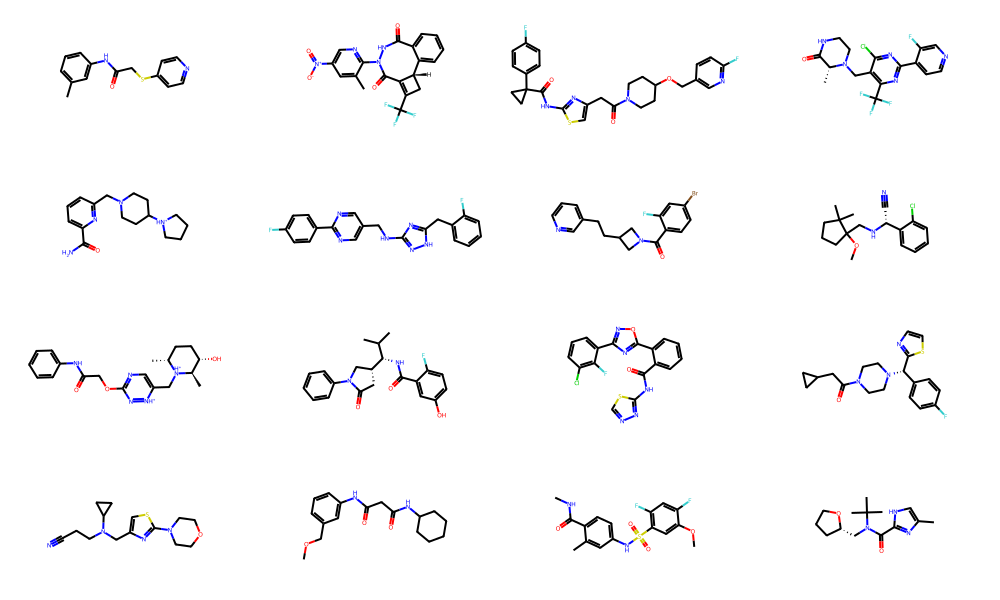

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22[C2ccc((C2N[(=O)(=O)cCcC)(C)C
pred_mu smi: CC1ccc(C22CC2ccc((C2=O(=O)(=O)c1cC)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:50<00:00, 399.11it/s]


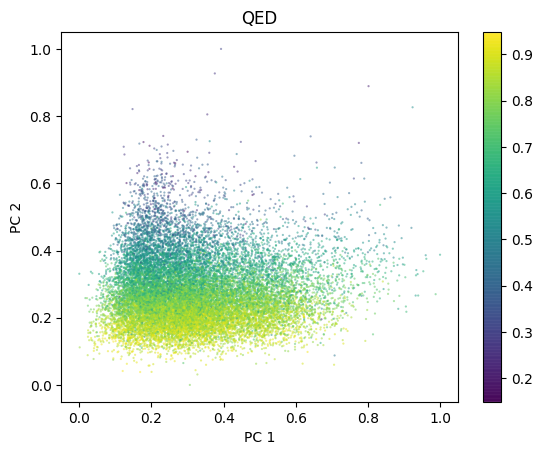

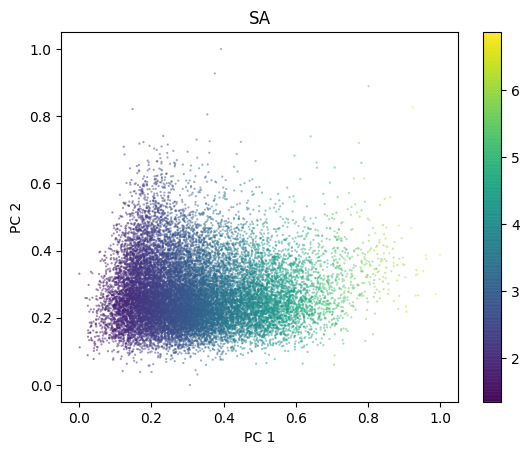

####################
save model ckpt.pt


 34%|███▍      | 116/342 [00:18<00:35,  6.33it/s]

Epoch 23: 114/342 | ['loss=0.06271', '(kl=0.00065', 'recon=0.06207)', 'classify=0.00097', 'klw=0.23000 lr=0.00173']


 67%|██████▋   | 230/342 [00:36<00:17,  6.30it/s]

Epoch 23: 228/342 | ['loss=0.12452', '(kl=0.00122', 'recon=0.12330)', 'classify=0.00188', 'klw=0.23000 lr=0.00173']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 403.01it/s]


valid 86.967%  |  unique 86.967%


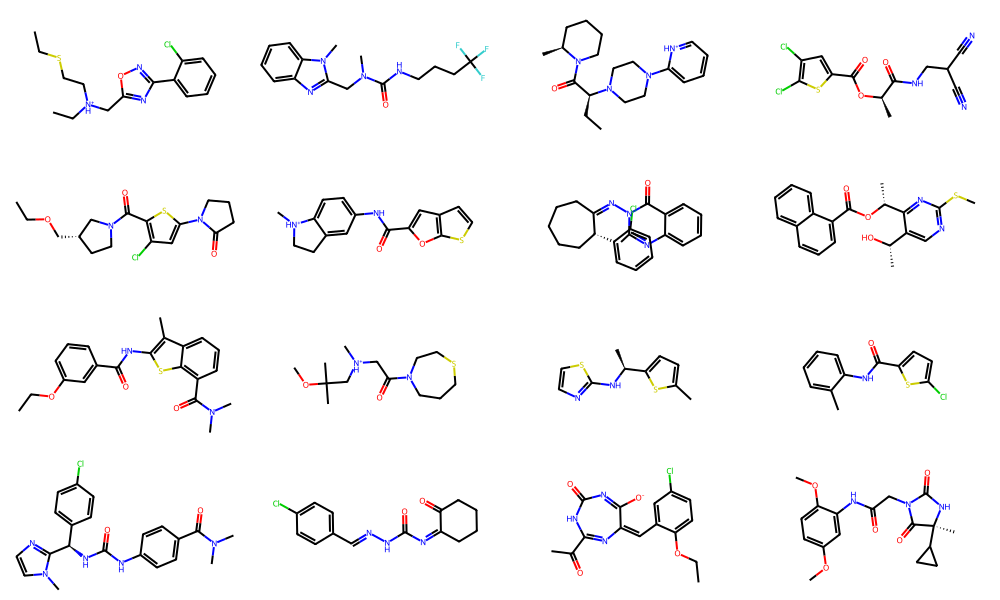

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22[C1ccc((C2)[c=O)(=O)cCcC)CC)C
pred_mu smi: CC1ccc(C(2[C1ccc((C2)[(=O)(=O)cCcC)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 400.41it/s]


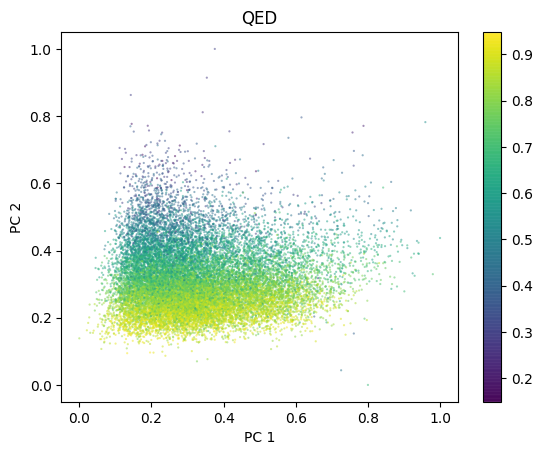

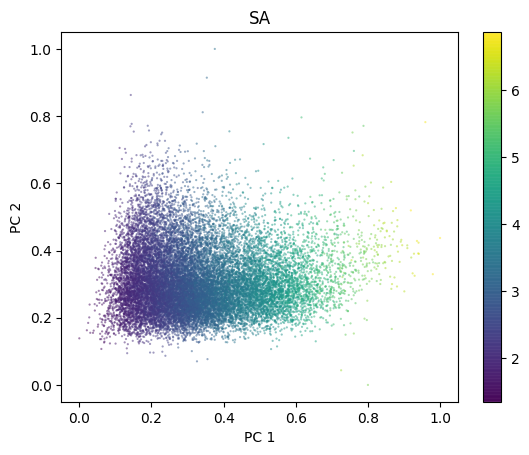

####################
save model ckpt.pt


 34%|███▍      | 116/342 [00:18<00:36,  6.26it/s]

Epoch 24: 114/342 | ['loss=0.06202', '(kl=0.00057', 'recon=0.06144)', 'classify=0.00088', 'klw=0.24000 lr=0.00165']


 67%|██████▋   | 230/342 [00:36<00:17,  6.32it/s]

Epoch 24: 228/342 | ['loss=0.12354', '(kl=0.00111', 'recon=0.12241)', 'classify=0.00172', 'klw=0.24000 lr=0.00165']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 393.61it/s]


valid 86.667%  |  unique 86.667%


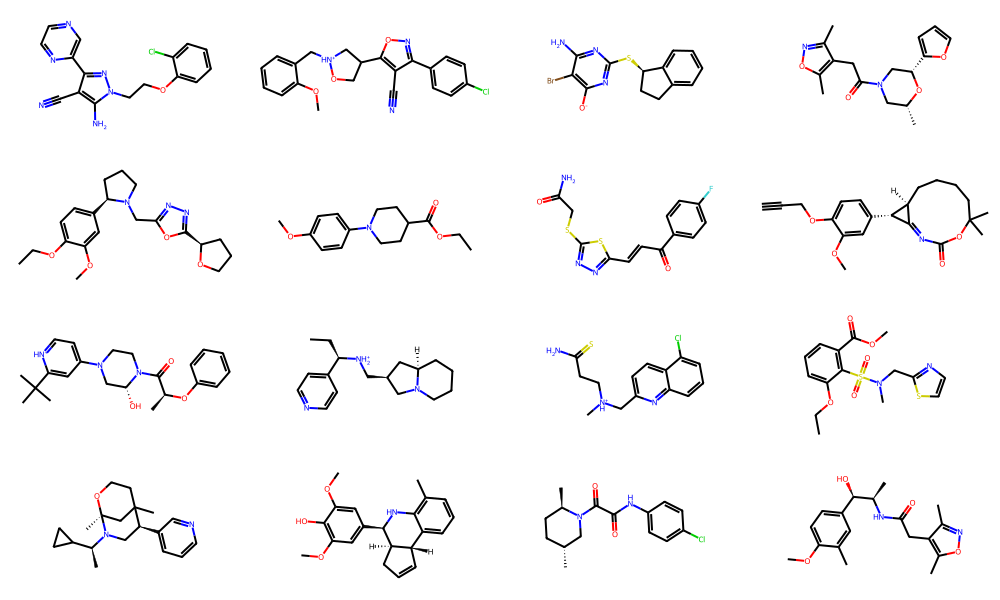

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22CC2ccc((C2O[(=O)(=O)c11C)CC)C
pred_mu smi: CC1ccc(C22CC1ccc((C2=[(=O)(=O)c11C)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:50<00:00, 398.49it/s]


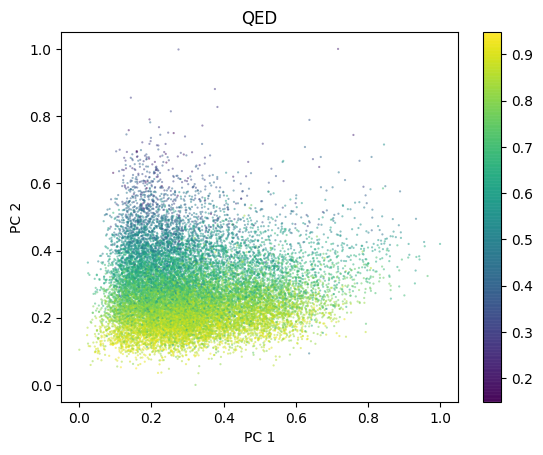

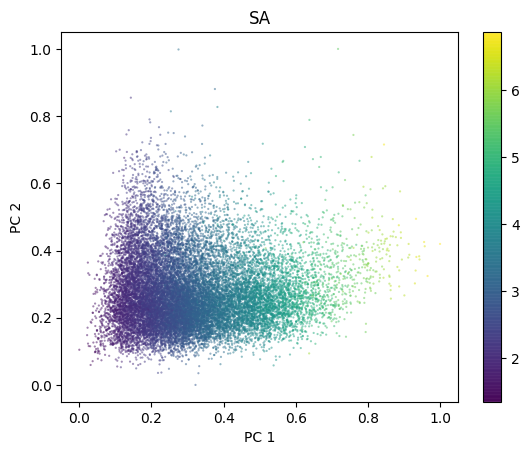

 34%|███▍      | 116/342 [00:18<00:36,  6.19it/s]

Epoch 25: 114/342 | ['loss=0.06187', '(kl=0.00061', 'recon=0.06124)', 'classify=0.00096', 'klw=0.25000 lr=0.00157']


 67%|██████▋   | 230/342 [00:36<00:17,  6.54it/s]

Epoch 25: 228/342 | ['loss=0.12292', '(kl=0.00112', 'recon=0.12175)', 'classify=0.00178', 'klw=0.25000 lr=0.00157']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 390.22it/s]


valid 85.533%  |  unique 85.500%


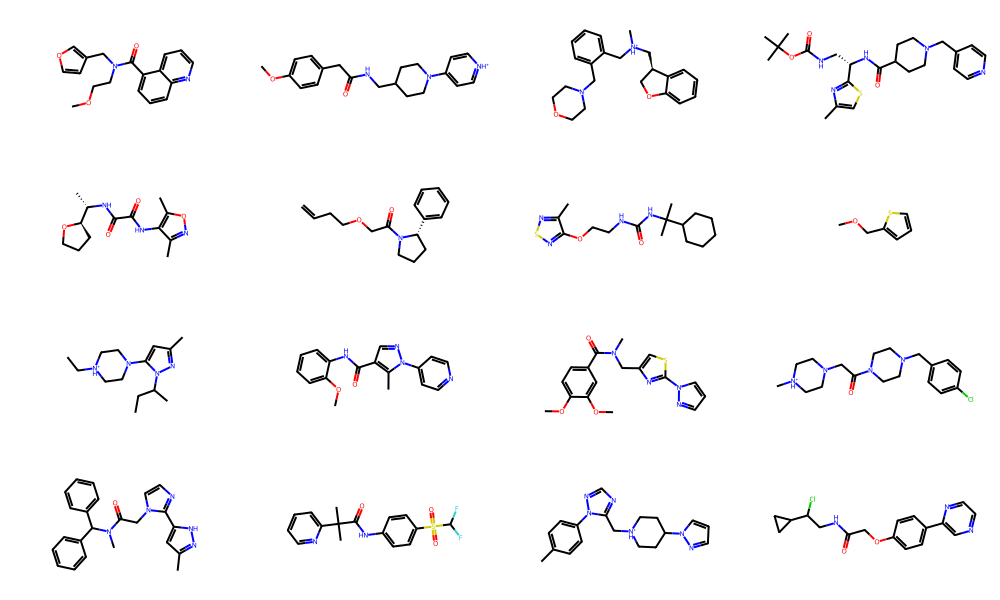

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22[C1ncc((C2C[(=O)(=O)c1cC)CC)C
pred_mu smi: CC1ccc(Cc2CC1ccc((C2)C(=O)(=O)c1(N)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:50<00:00, 396.40it/s]


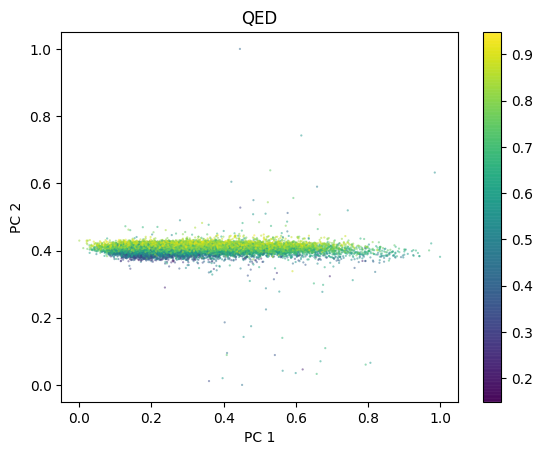

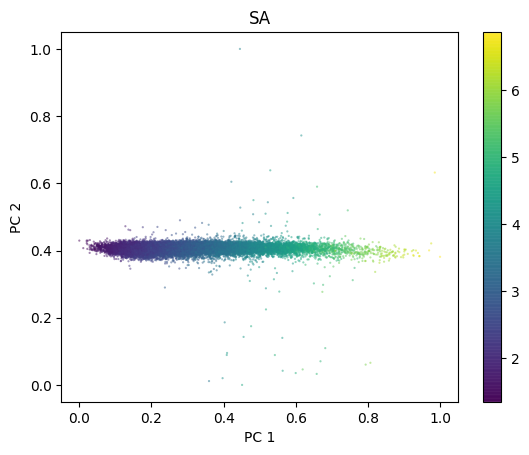

 34%|███▍      | 116/342 [00:18<00:36,  6.18it/s]

Epoch 26: 114/342 | ['loss=0.06185', '(kl=0.00067', 'recon=0.06122)', 'classify=0.00092', 'klw=0.26000 lr=0.00148']


 67%|██████▋   | 230/342 [00:36<00:17,  6.34it/s]

Epoch 26: 228/342 | ['loss=0.12281', '(kl=0.00114', 'recon=0.12169)', 'classify=0.00164', 'klw=0.26000 lr=0.00148']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 390.14it/s]


valid 84.533%  |  unique 84.533%


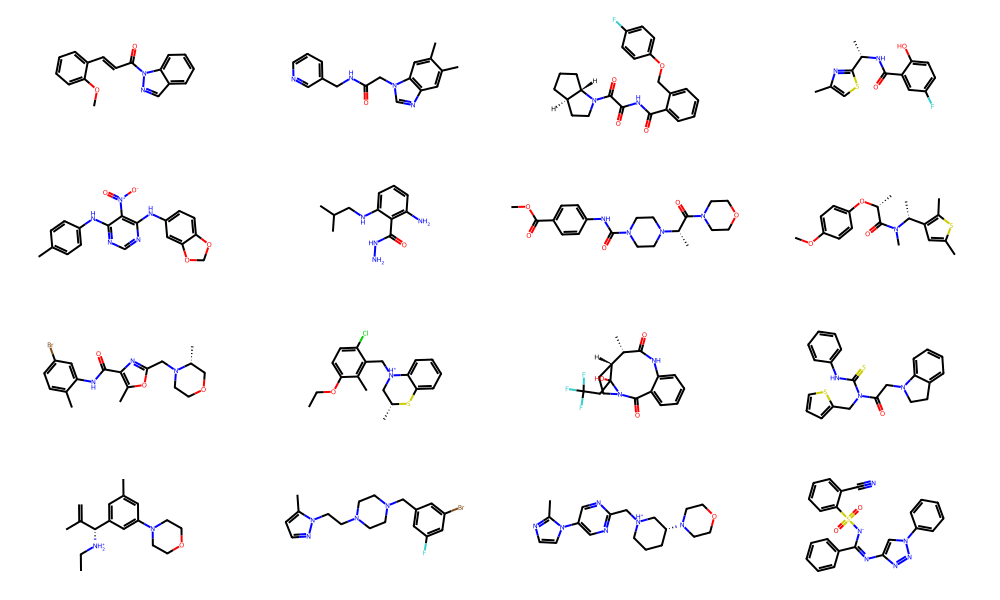

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22CC1ccc((C2)[(=O)(=O)c1cC)(C)C
pred_mu smi: CC1ccc(C22CC1ccc((C2)[(=O)(=O)c1cC)(C)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:50<00:00, 394.91it/s]


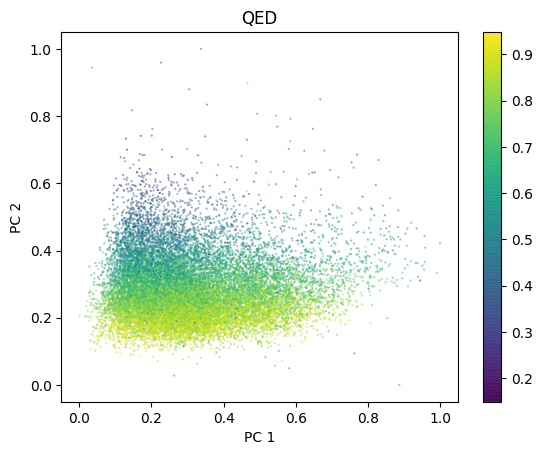

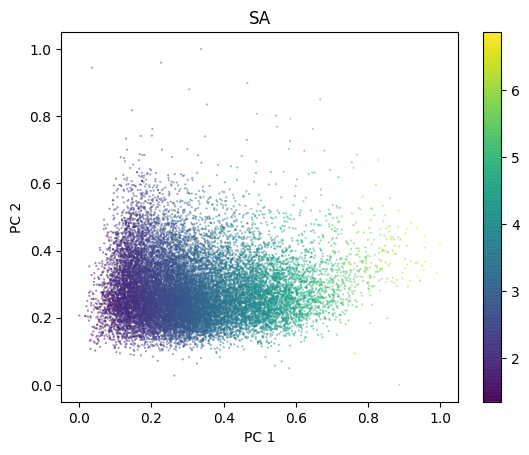

 34%|███▍      | 116/342 [00:18<00:36,  6.26it/s]

Epoch 27: 114/342 | ['loss=0.06138', '(kl=0.00070', 'recon=0.06062)', 'classify=0.00115', 'klw=0.27000 lr=0.00140']


 67%|██████▋   | 230/342 [00:36<00:17,  6.33it/s]

Epoch 27: 228/342 | ['loss=0.12174', '(kl=0.00114', 'recon=0.12049)', 'classify=0.00188', 'klw=0.27000 lr=0.00140']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 394.03it/s]


valid 89.067%  |  unique 89.067%


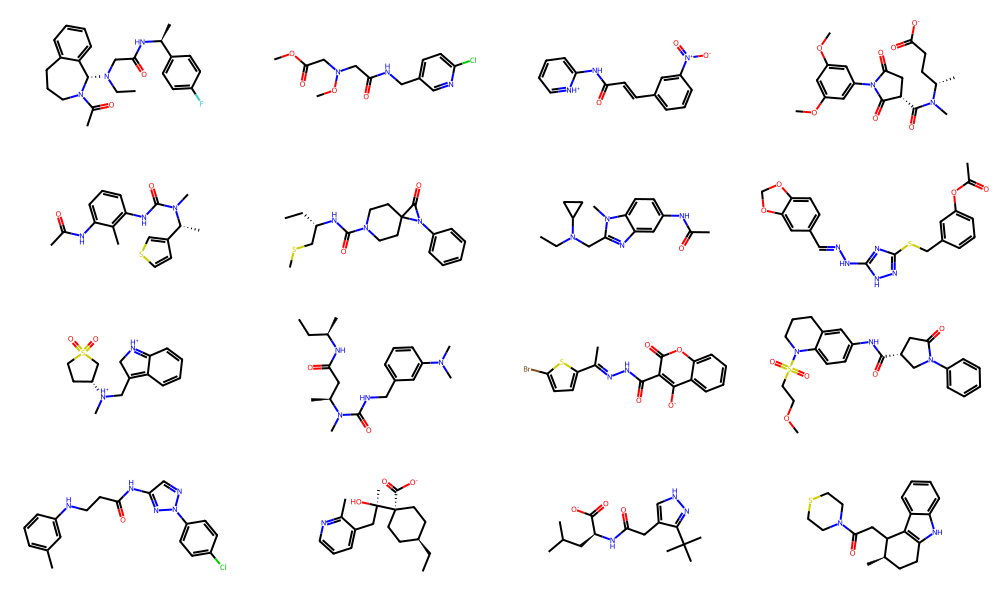

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22[C1ccc((C2)[(=O)(=O)c11C)CC)C
pred_mu smi: CC1ccc(C22CC1ccc((C2)[(=O)(=O)c1cC)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:50<00:00, 396.35it/s]


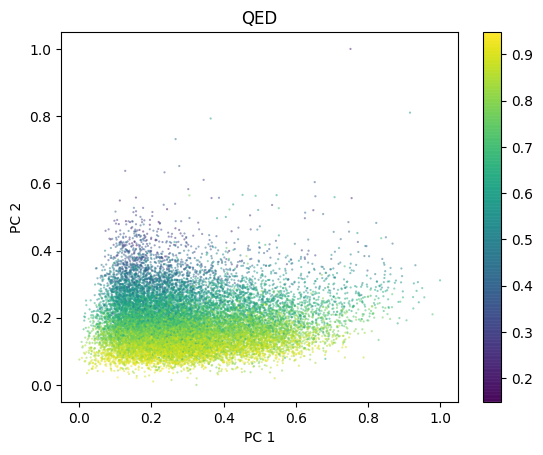

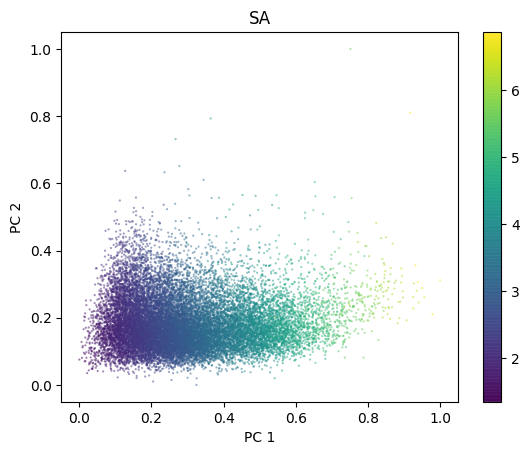

####################
save model ckpt.pt


 34%|███▍      | 116/342 [00:18<00:37,  6.04it/s]

Epoch 28: 114/342 | ['loss=0.06076', '(kl=0.00052', 'recon=0.06017)', 'classify=0.00090', 'klw=0.28000 lr=0.00131']


 67%|██████▋   | 230/342 [00:37<00:17,  6.23it/s]

Epoch 28: 228/342 | ['loss=0.12099', '(kl=0.00098', 'recon=0.11991)', 'classify=0.00162', 'klw=0.28000 lr=0.00131']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 393.32it/s]


valid 87.300%  |  unique 87.300%


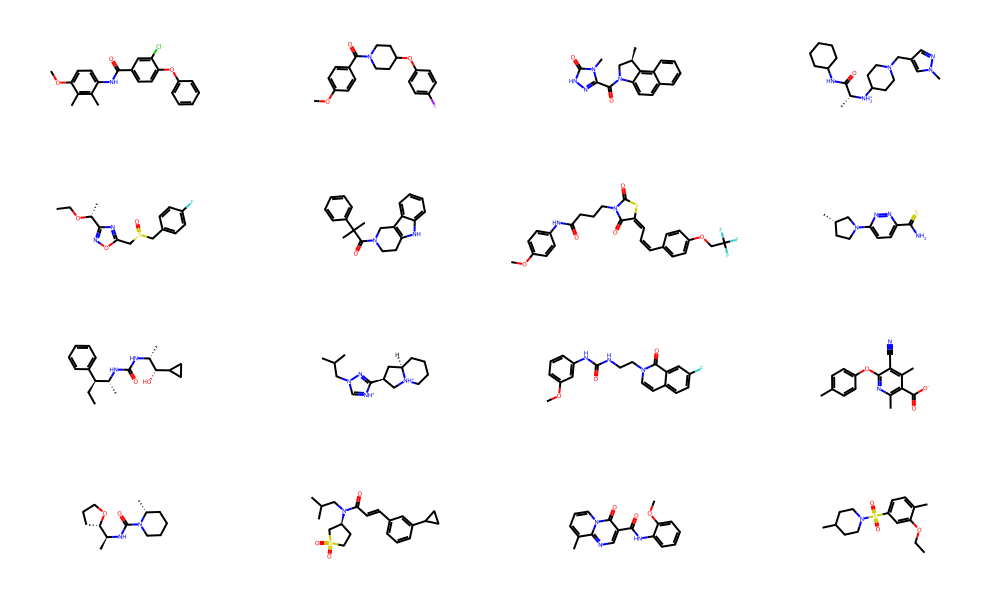

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22CC2ccc((C2)[(=O)(=O)c1cC)CC)C
pred_mu smi: CC1ccc(C22CC2ccc((C2)[(=O)(=O)c1cC)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:50<00:00, 398.31it/s]


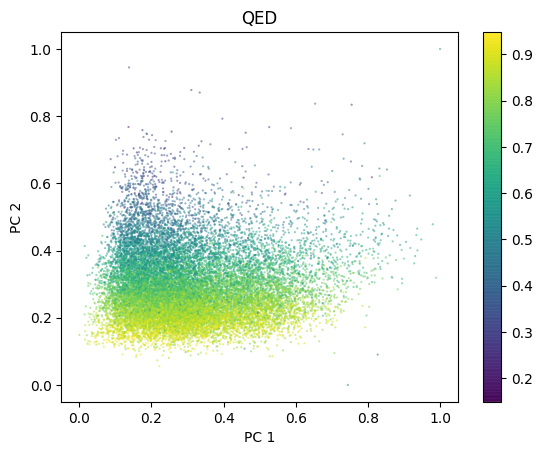

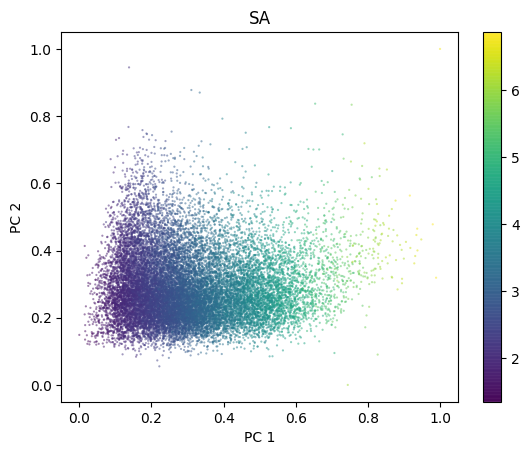

 34%|███▍      | 116/342 [00:18<00:35,  6.39it/s]

Epoch 29: 114/342 | ['loss=0.06029', '(kl=0.00046', 'recon=0.05975)', 'classify=0.00081', 'klw=0.29000 lr=0.00123']


 67%|██████▋   | 230/342 [00:36<00:17,  6.26it/s]

Epoch 29: 228/342 | ['loss=0.11990', '(kl=0.00083', 'recon=0.11892)', 'classify=0.00148', 'klw=0.29000 lr=0.00123']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 393.79it/s]


valid 88.500%  |  unique 88.500%


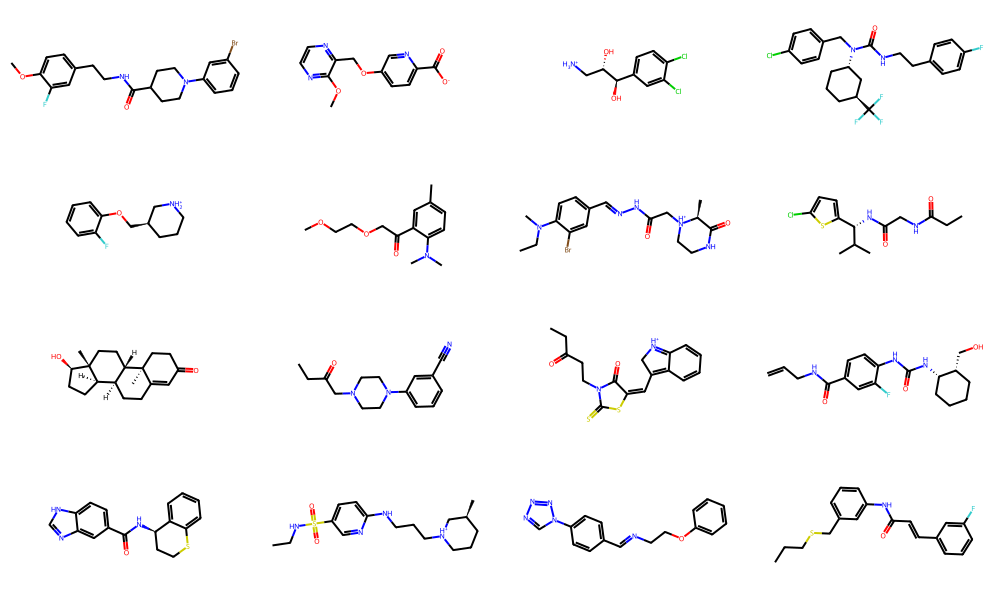

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22CC1ccc((C2)[(=O)(=O)cC(C)(C)C
pred_mu smi: CC1ccc(C22CC2ccc((C2)[C=O)(=O)cC(C)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:50<00:00, 398.45it/s]


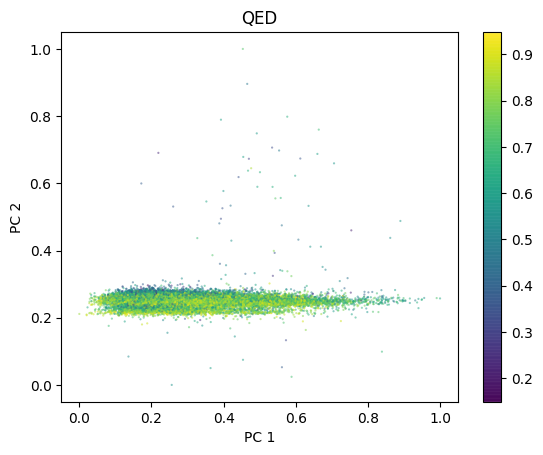

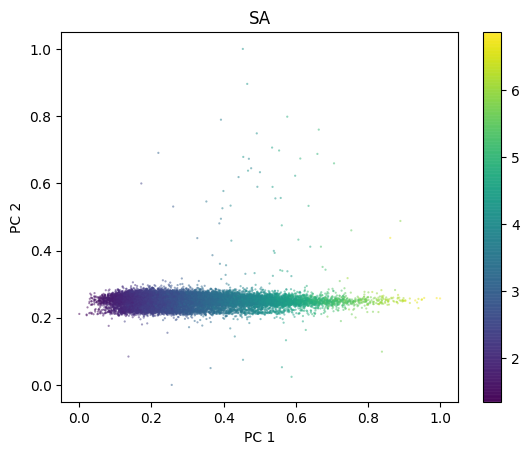

 34%|███▍      | 116/342 [00:18<00:34,  6.49it/s]

Epoch 30: 114/342 | ['loss=0.06007', '(kl=0.00041', 'recon=0.05957)', 'classify=0.00075', 'klw=0.30000 lr=0.00115']


 67%|██████▋   | 230/342 [00:36<00:17,  6.37it/s]

Epoch 30: 228/342 | ['loss=0.11926', '(kl=0.00073', 'recon=0.11834)', 'classify=0.00142', 'klw=0.30000 lr=0.00115']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 398.48it/s]


valid 85.800%  |  unique 85.800%


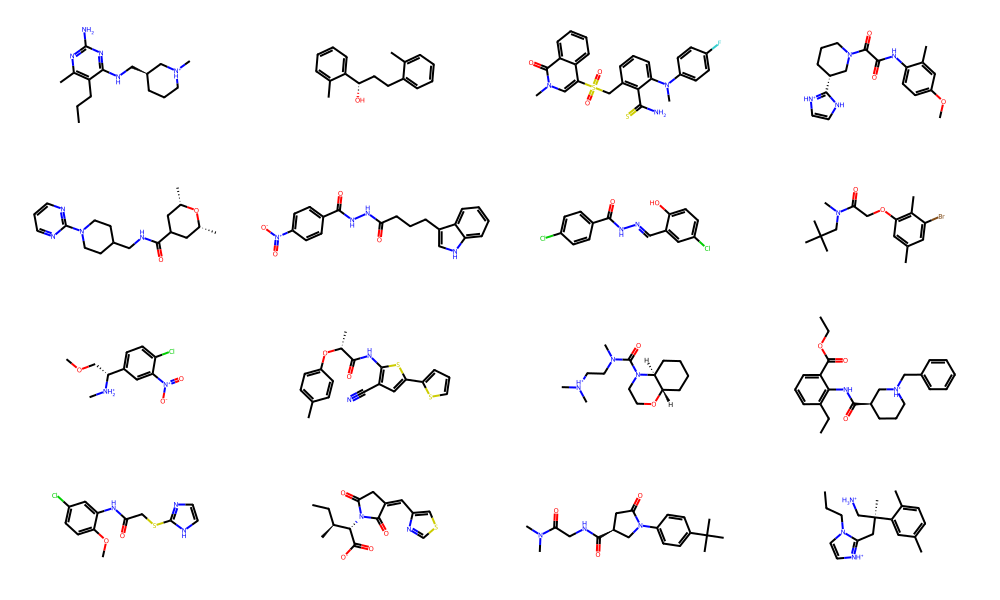

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22CC1ccc((C2)[(=O)(=O)c11C)CC)C
pred_mu smi: CC1ccc(C22CC1ccc((C2)[(CO)(=O)c11C)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:50<00:00, 397.91it/s]


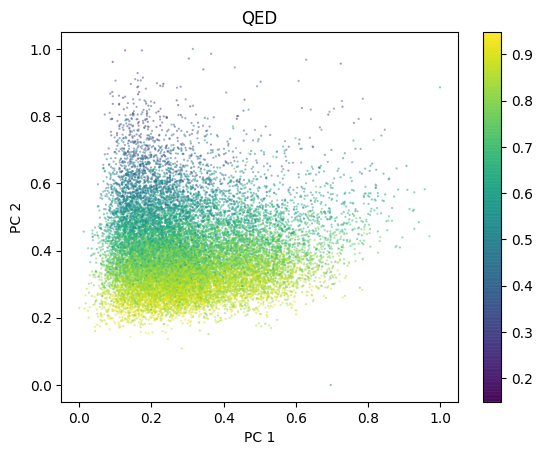

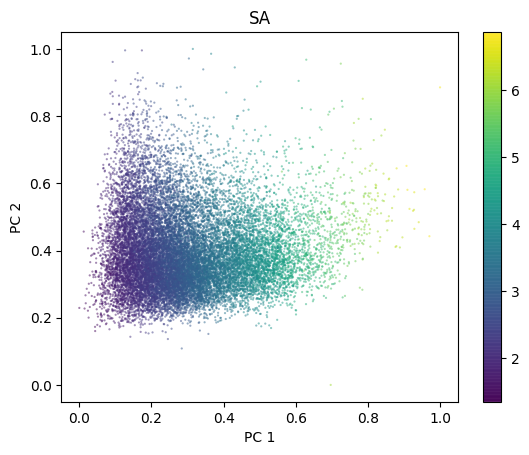

 34%|███▍      | 116/342 [00:18<00:35,  6.32it/s]

Epoch 31: 114/342 | ['loss=0.05986', '(kl=0.00039', 'recon=0.05934)', 'classify=0.00081', 'klw=0.31000 lr=0.00108']


 67%|██████▋   | 230/342 [00:36<00:18,  6.17it/s]

Epoch 31: 228/342 | ['loss=0.11880', '(kl=0.00071', 'recon=0.11787)', 'classify=0.00142', 'klw=0.31000 lr=0.00108']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 397.51it/s]


valid 88.200%  |  unique 88.200%


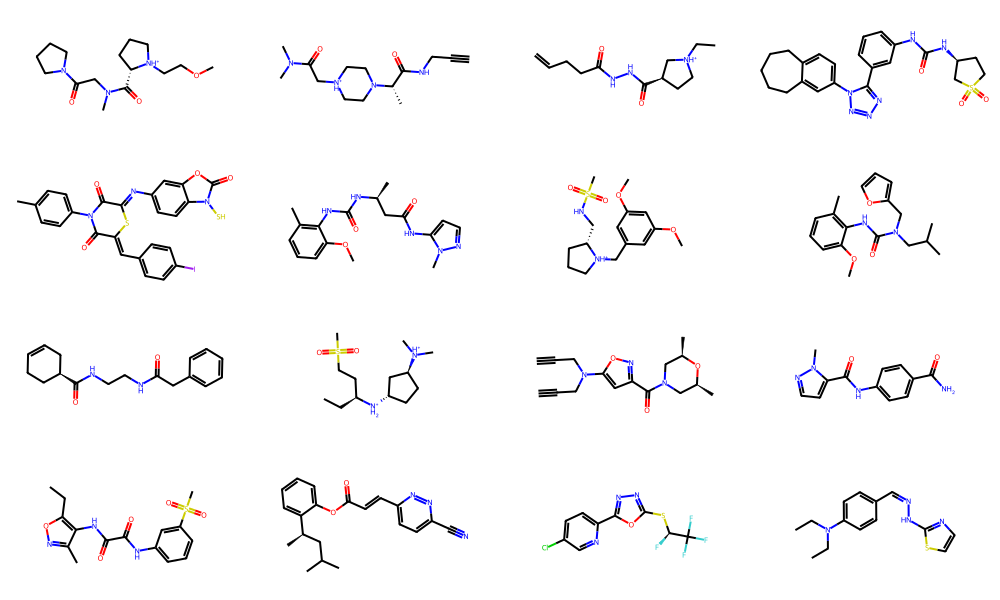

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22CC1ccc((C2)[(=O)(=O)c1(C)CC)C
pred_mu smi: CC1ccc(C22CC1ccc((C2)c(=O)(=O)c1cC)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:50<00:00, 399.60it/s]


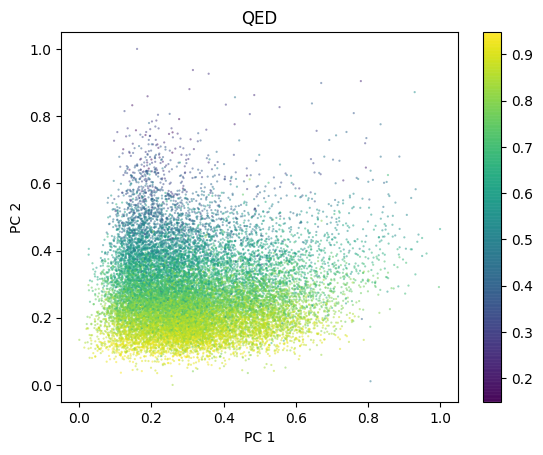

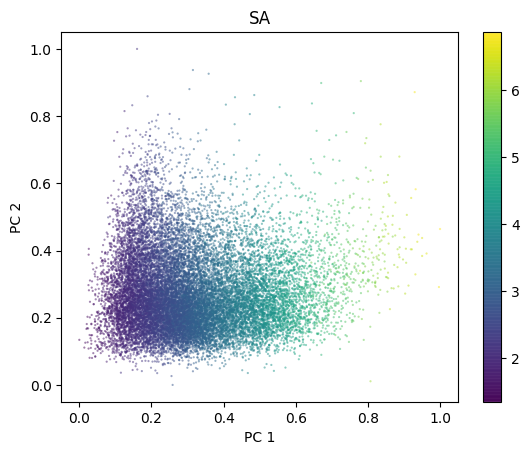

 34%|███▍      | 116/342 [00:18<00:35,  6.28it/s]

Epoch 32: 114/342 | ['loss=0.05904', '(kl=0.00029', 'recon=0.05864)', 'classify=0.00060', 'klw=0.32000 lr=0.00100']


 67%|██████▋   | 230/342 [00:36<00:18,  6.20it/s]

Epoch 32: 228/342 | ['loss=0.11759', '(kl=0.00055', 'recon=0.11682)', 'classify=0.00118', 'klw=0.32000 lr=0.00100']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 400.42it/s]


valid 88.267%  |  unique 88.233%


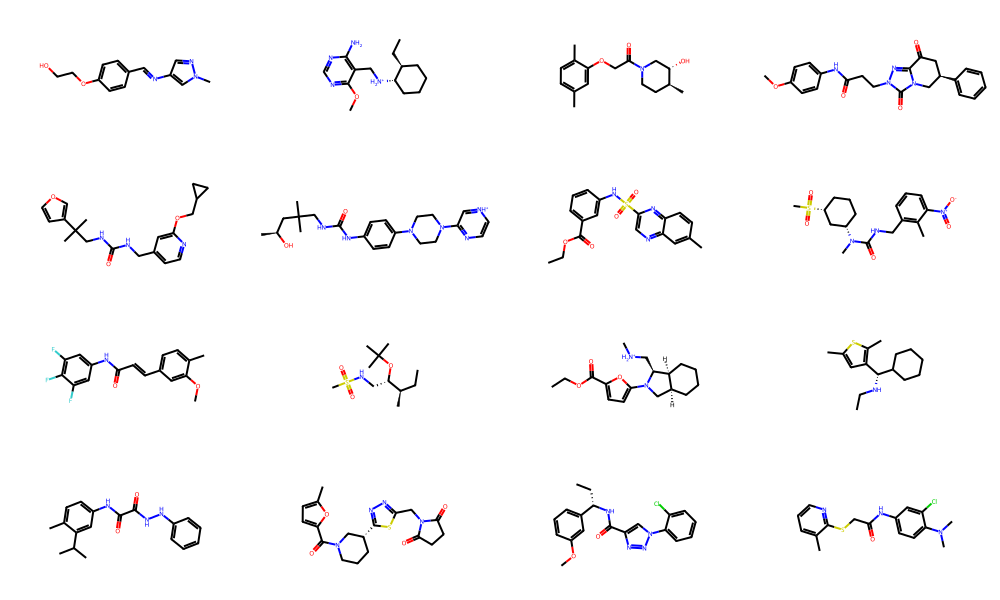

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22[C2ccc((C2)n(=O)(=O)c1(C)CC)C
pred_mu smi: CC1ccc(C22CC1ccc((C2)c(=O)(=O)c1cC)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 401.59it/s]


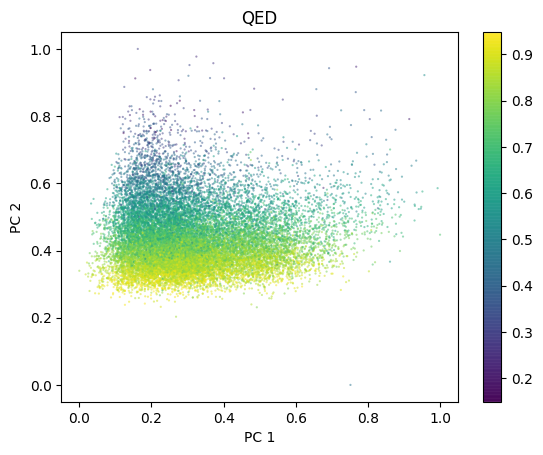

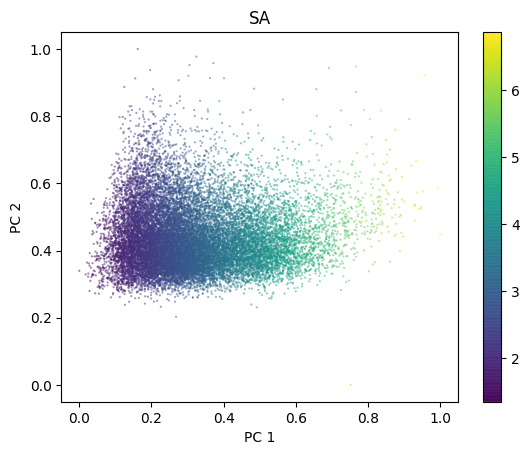

 34%|███▍      | 116/342 [00:18<00:35,  6.28it/s]

Epoch 33: 114/342 | ['loss=0.05895', '(kl=0.00027', 'recon=0.05854)', 'classify=0.00063', 'klw=0.33000 lr=0.00093']


 67%|██████▋   | 230/342 [00:36<00:18,  6.21it/s]

Epoch 33: 228/342 | ['loss=0.11720', '(kl=0.00052', 'recon=0.11642)', 'classify=0.00120', 'klw=0.33000 lr=0.00093']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 400.71it/s]


valid 89.400%  |  unique 89.367%


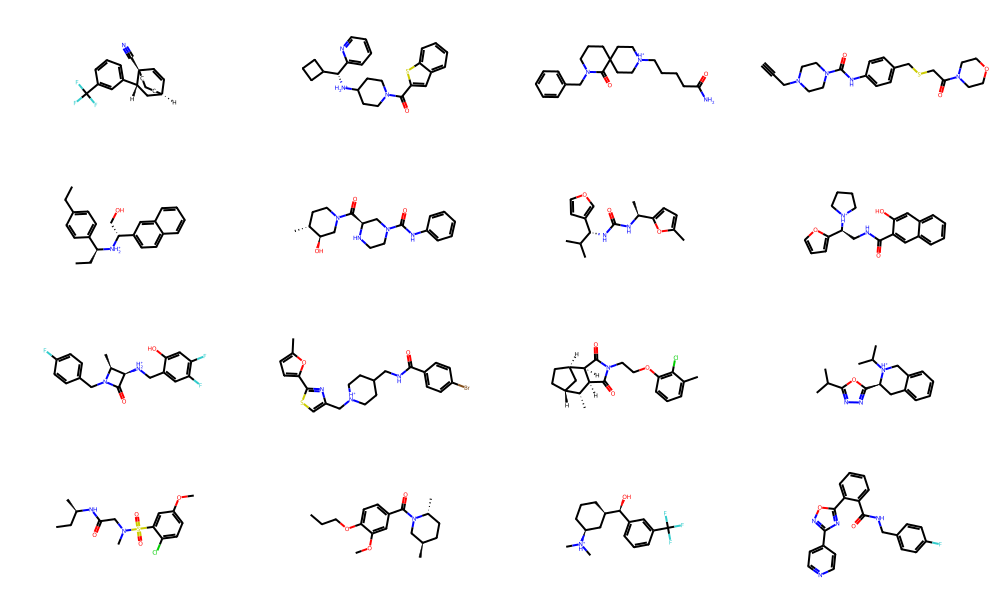

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22[C1ccc((C2=[(=O)(=O)cCcC)CC)C
pred_mu smi: CC1ccc(C22CC1ccc((C2=[(CO)(=O)N1cC)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 400.80it/s]


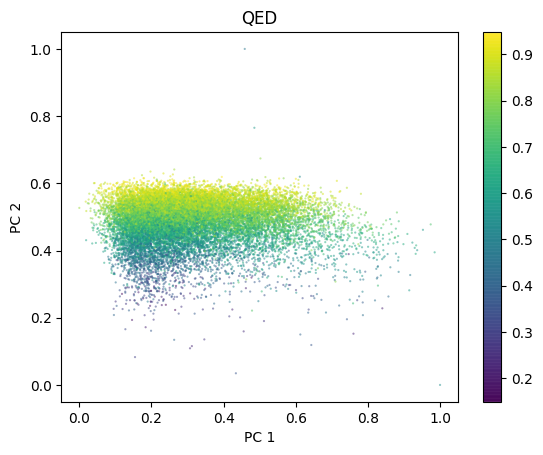

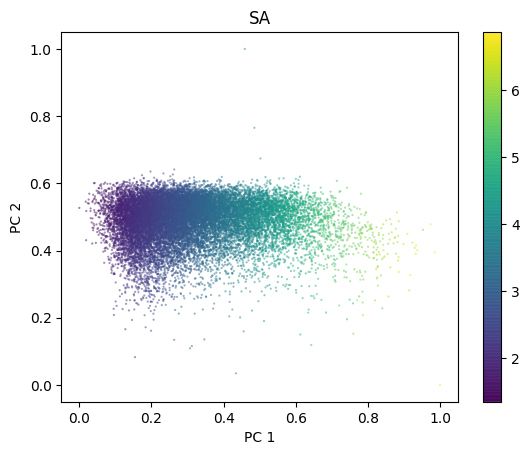

####################
save model ckpt.pt


 34%|███▍      | 116/342 [00:18<00:40,  5.65it/s]

Epoch 34: 114/342 | ['loss=0.05840', '(kl=0.00028', 'recon=0.05799)', 'classify=0.00062', 'klw=0.34000 lr=0.00086']


 67%|██████▋   | 230/342 [00:36<00:18,  6.21it/s]

Epoch 34: 228/342 | ['loss=0.11621', '(kl=0.00051', 'recon=0.11545)', 'classify=0.00117', 'klw=0.34000 lr=0.00086']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 396.94it/s]


valid 90.567%  |  unique 90.567%


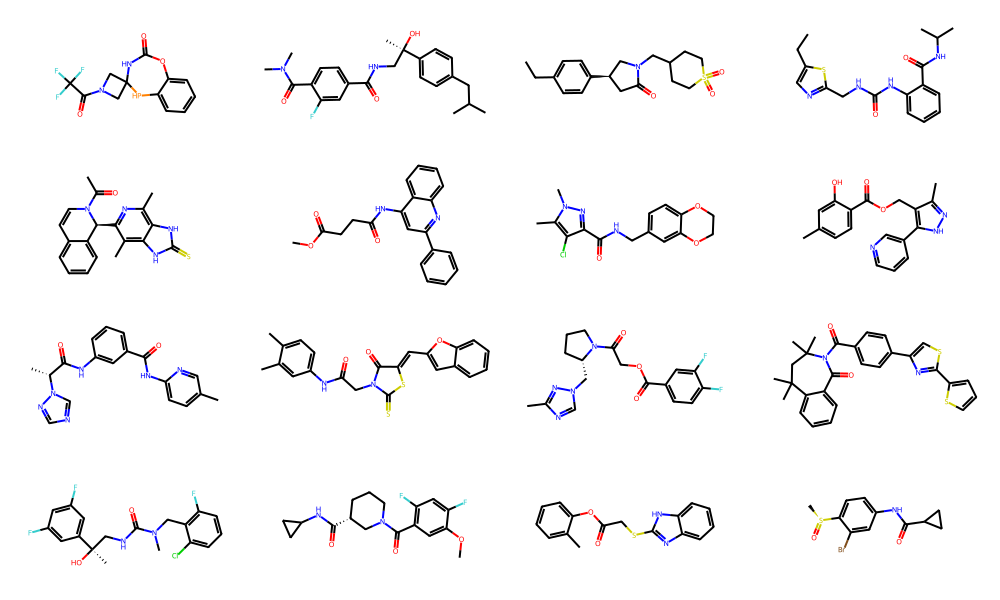

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22CC1ccc((C2)[(=O)(=O)cc(=)(C)C
pred_mu smi: CC1ccc(C22CC1ccc((C2)n(CO)(=O)c11C)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 402.71it/s]


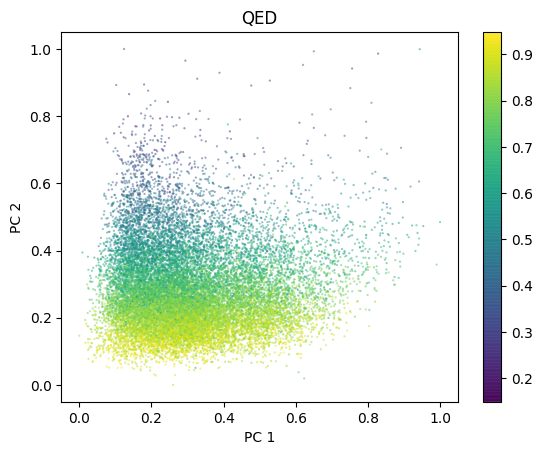

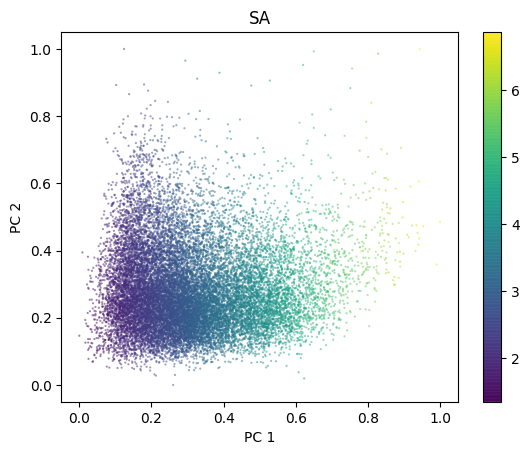

####################
save model ckpt.pt


 34%|███▍      | 116/342 [00:18<00:36,  6.27it/s]

Epoch 35: 114/342 | ['loss=0.05807', '(kl=0.00022', 'recon=0.05772)', 'classify=0.00054', 'klw=0.35000 lr=0.00079']


 67%|██████▋   | 230/342 [00:36<00:17,  6.40it/s]

Epoch 35: 228/342 | ['loss=0.11568', '(kl=0.00044', 'recon=0.11498)', 'classify=0.00108', 'klw=0.35000 lr=0.00079']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 398.87it/s]


valid 90.933%  |  unique 90.933%


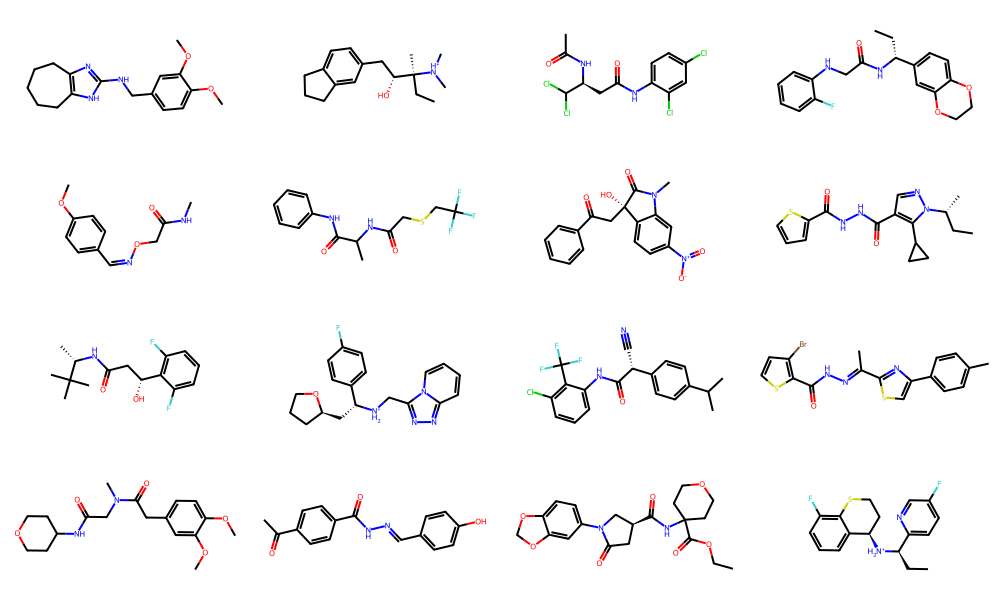

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22CC1ccc((C2)[(CO)(=O)c((C)CC)C
pred_mu smi: CC1ccc(C22CC1ccc((C2)[(=O)(=O)c(1C)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 403.79it/s]


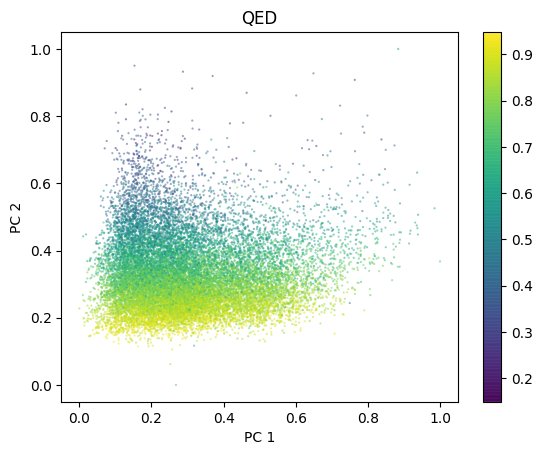

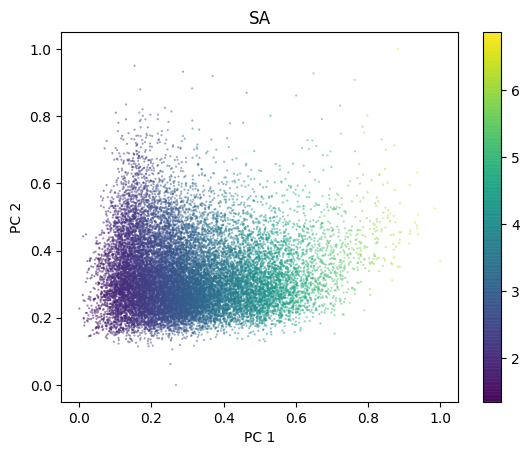

####################
save model ckpt.pt


 34%|███▍      | 116/342 [00:18<00:35,  6.35it/s]

Epoch 36: 114/342 | ['loss=0.05771', '(kl=0.00027', 'recon=0.05729)', 'classify=0.00065', 'klw=0.36000 lr=0.00073']


 67%|██████▋   | 230/342 [00:36<00:17,  6.36it/s]

Epoch 36: 228/342 | ['loss=0.11489', '(kl=0.00047', 'recon=0.11414)', 'classify=0.00117', 'klw=0.36000 lr=0.00073']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 399.32it/s]


valid 90.467%  |  unique 90.467%


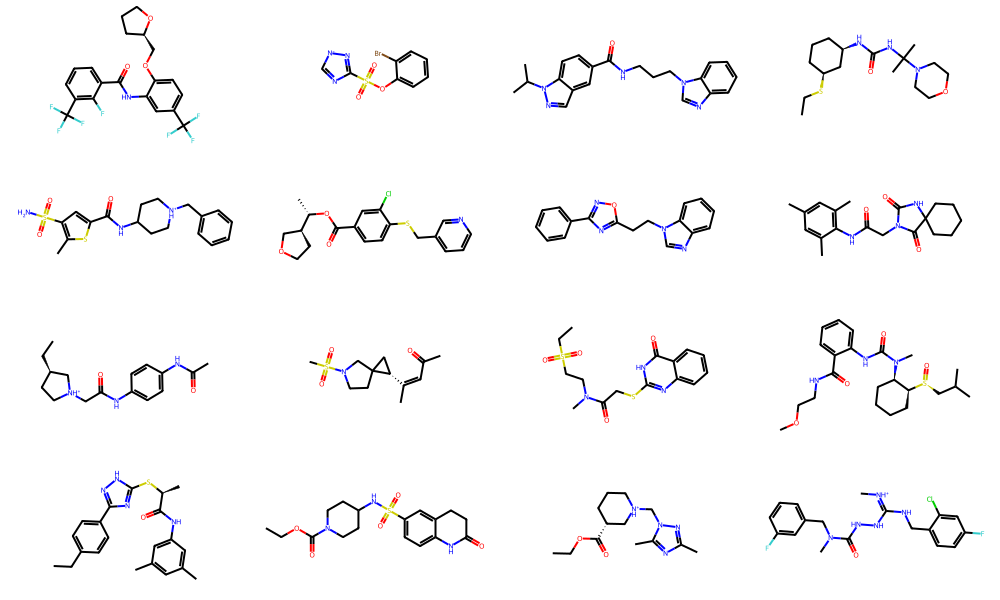

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22CC1ccc((C2)[(=O)(=O)c11C)CC)C
pred_mu smi: CC1ccc(C22CC1ccc((C2)[(=O)(=O)c11C)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 402.02it/s]


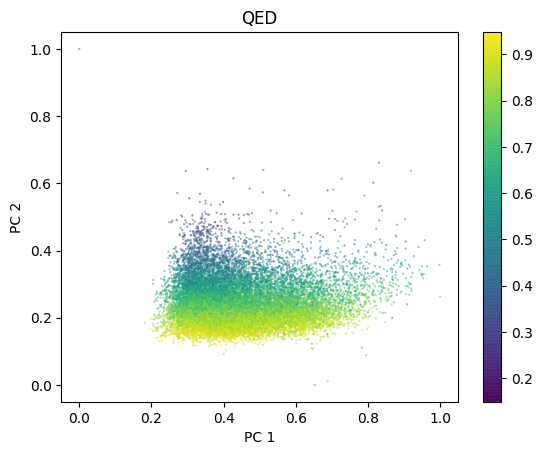

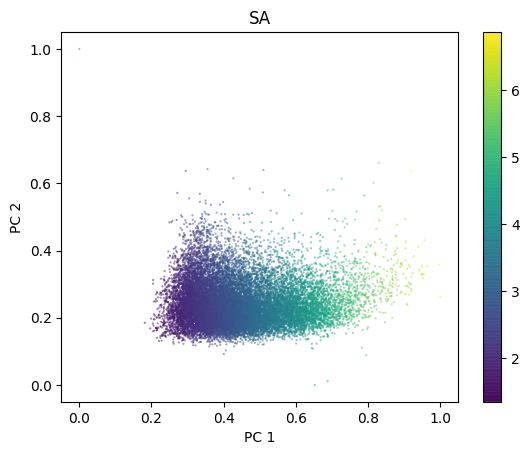

 34%|███▍      | 116/342 [00:18<00:35,  6.42it/s]

Epoch 37: 114/342 | ['loss=0.05732', '(kl=0.00022', 'recon=0.05697)', 'classify=0.00053', 'klw=0.37000 lr=0.00067']


 67%|██████▋   | 230/342 [00:36<00:17,  6.34it/s]

Epoch 37: 228/342 | ['loss=0.11420', '(kl=0.00039', 'recon=0.11355)', 'classify=0.00101', 'klw=0.37000 lr=0.00067']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 402.27it/s]


valid 91.000%  |  unique 91.000%


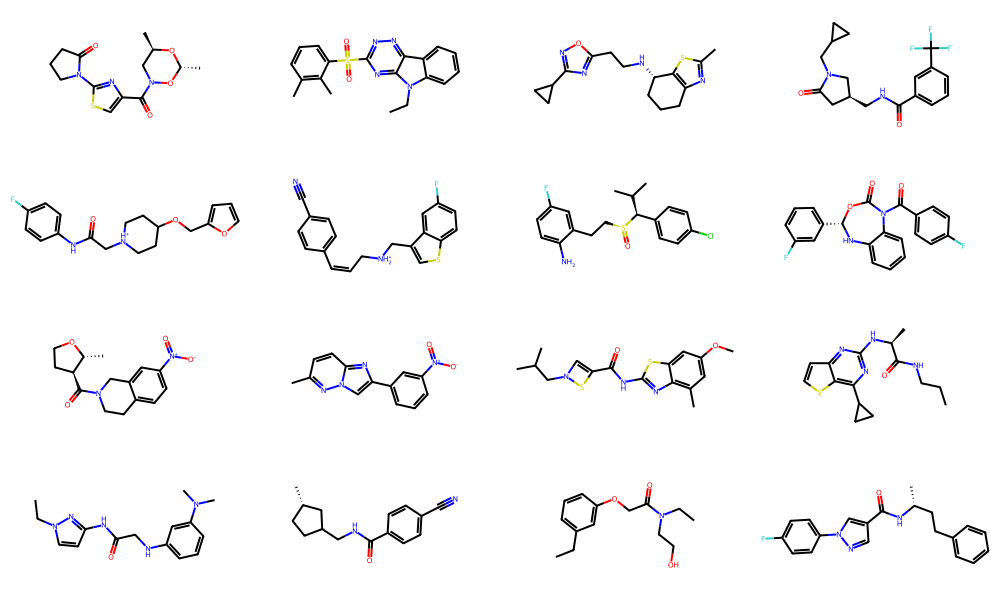

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22CC1ccc((C2)[(=O)(=O)c1(C)CC)C
pred_mu smi: CC1ccc(C22NC1ccc((C2)[(CO)(=O)c11C)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 402.22it/s]


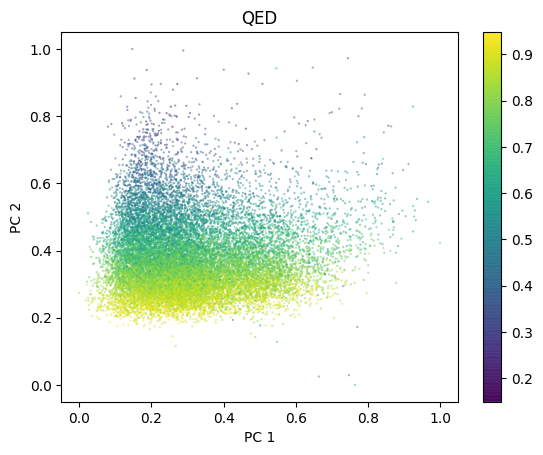

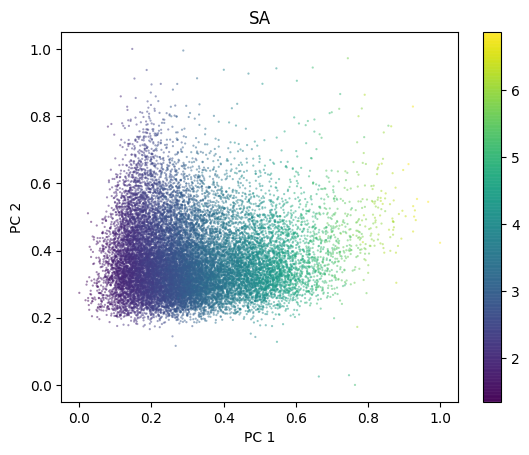

####################
save model ckpt.pt


 34%|███▍      | 116/342 [00:18<00:34,  6.51it/s]

Epoch 38: 114/342 | ['loss=0.05703', '(kl=0.00018', 'recon=0.05671)', 'classify=0.00050', 'klw=0.38000 lr=0.00061']


 67%|██████▋   | 230/342 [00:35<00:17,  6.38it/s]

Epoch 38: 228/342 | ['loss=0.11463', '(kl=0.00046', 'recon=0.11395)', 'classify=0.00100', 'klw=0.38000 lr=0.00061']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 391.78it/s]


valid 91.000%  |  unique 90.967%


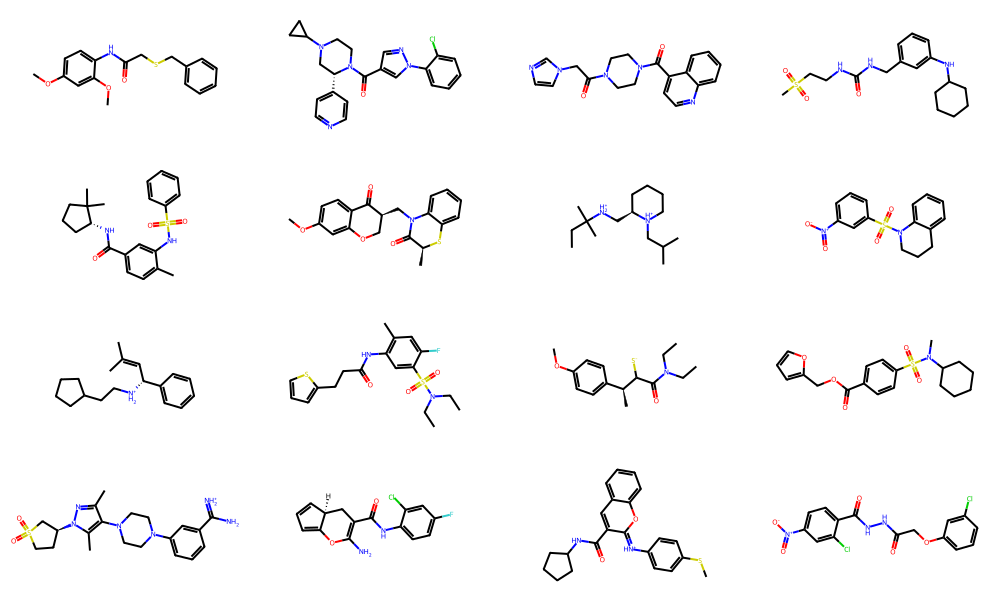

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22[C1ccc((C2)C(=O)(=O)c((C)CC)C
pred_mu smi: CC1ccc(C22CC1ccc((C2)O(=O)(=O)c((C)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 404.76it/s]


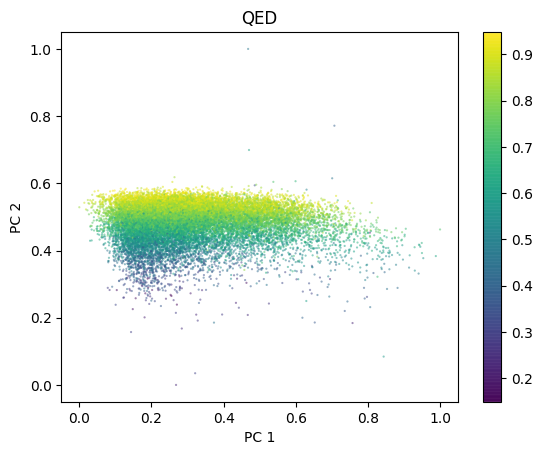

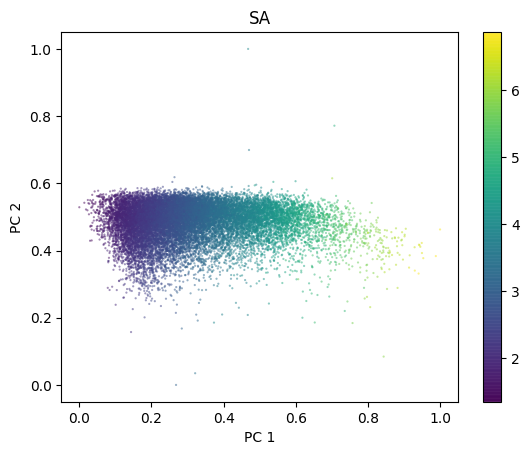

 34%|███▍      | 116/342 [00:18<00:34,  6.53it/s]

Epoch 39: 114/342 | ['loss=0.05697', '(kl=0.00018', 'recon=0.05665)', 'classify=0.00050', 'klw=0.39000 lr=0.00056']


 67%|██████▋   | 230/342 [00:35<00:17,  6.50it/s]

Epoch 39: 228/342 | ['loss=0.11332', '(kl=0.00034', 'recon=0.11271)', 'classify=0.00096', 'klw=0.39000 lr=0.00056']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 383.38it/s]


valid 91.067%  |  unique 91.067%


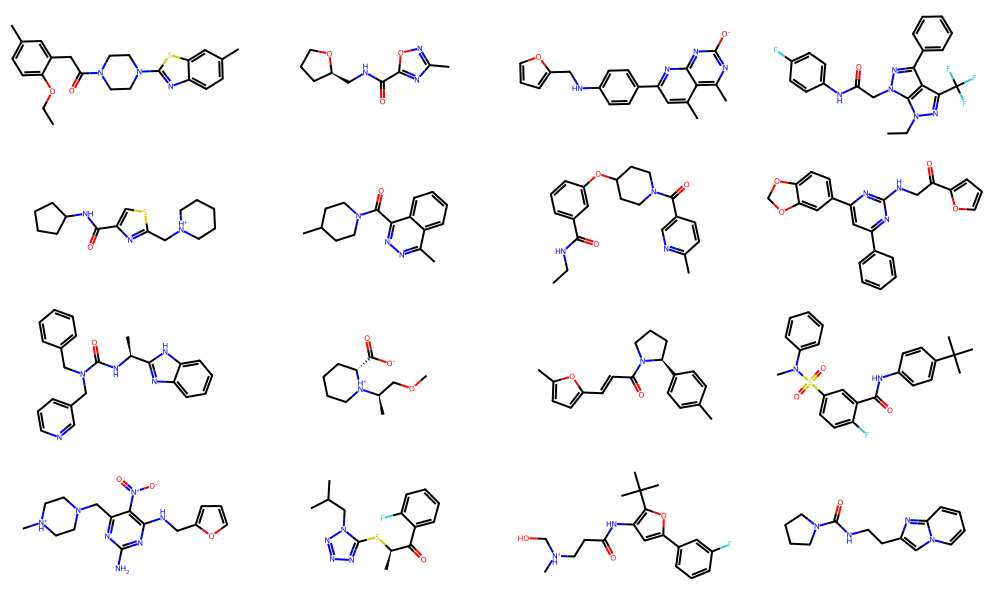

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22CC1ccc((C2)[(CO)(=O)c1cC)CC)C
pred_mu smi: CC1ccc(C22CC1ccc((C2)[(=O)(=O)c1cC)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 405.57it/s]


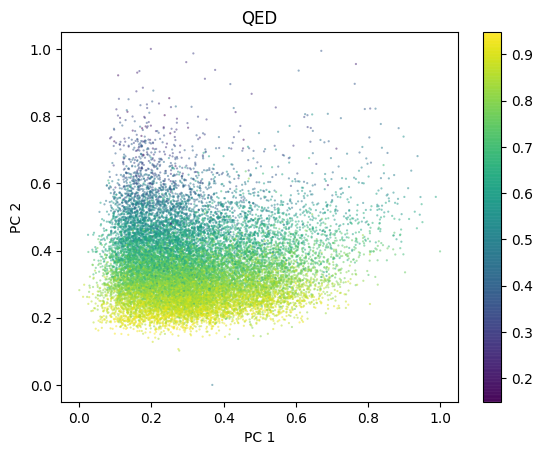

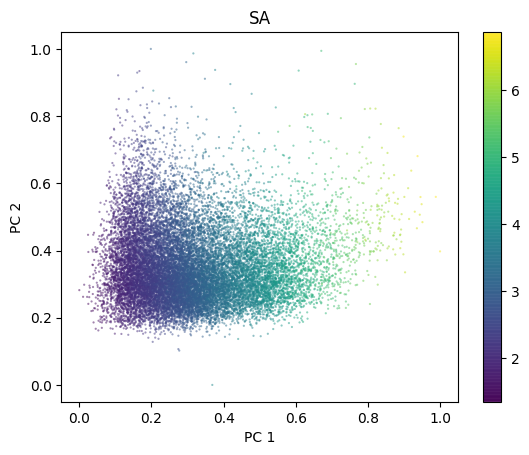

####################
save model ckpt.pt


 34%|███▍      | 116/342 [00:18<00:35,  6.41it/s]

Epoch 40: 114/342 | ['loss=0.05654', '(kl=0.00021', 'recon=0.05615)', 'classify=0.00061', 'klw=0.40000 lr=0.00051']


 67%|██████▋   | 230/342 [00:36<00:17,  6.49it/s]

Epoch 40: 228/342 | ['loss=0.11262', '(kl=0.00037', 'recon=0.11194)', 'classify=0.00105', 'klw=0.40000 lr=0.00051']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 380.80it/s]


valid 91.167%  |  unique 91.167%


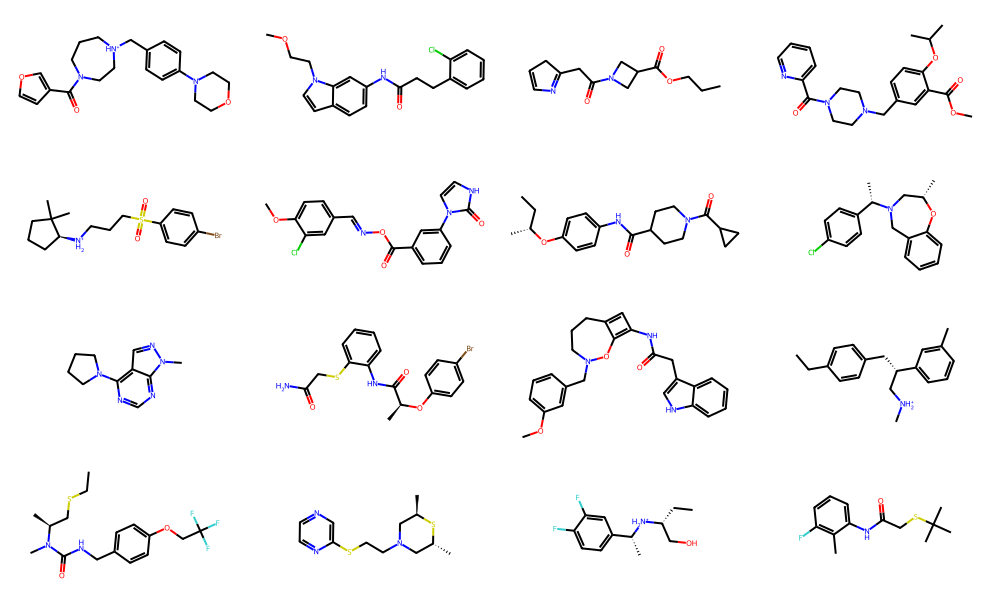

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22CC1ccc((C2)O(=O)(=O)c11C)CC)C
pred_mu smi: CC1ccc(C22CC1ccc((C2)c(=O)(=O)c1cC)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 400.92it/s]


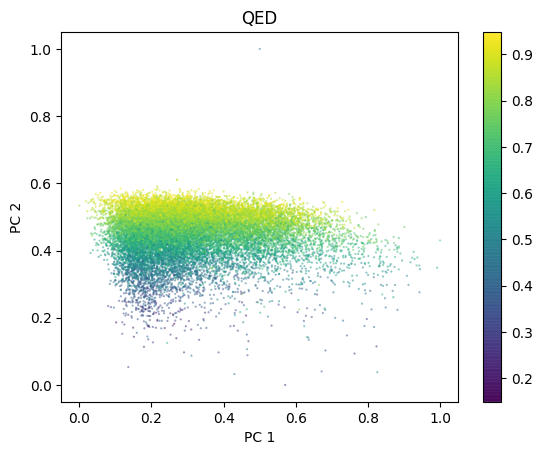

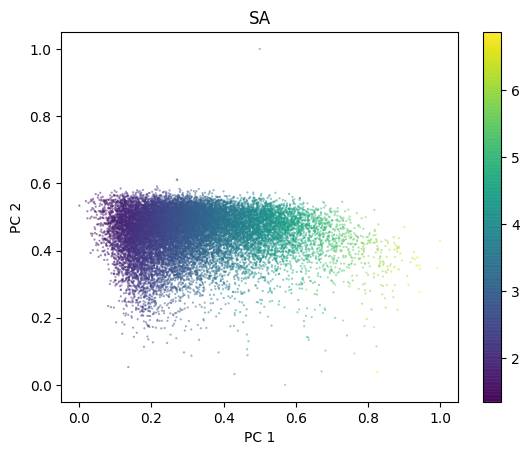

####################
save model ckpt.pt


 34%|███▍      | 116/342 [00:18<00:35,  6.37it/s]

Epoch 41: 114/342 | ['loss=0.05630', '(kl=0.00016', 'recon=0.05599)', 'classify=0.00048', 'klw=0.41000 lr=0.00047']


 67%|██████▋   | 230/342 [00:36<00:17,  6.47it/s]

Epoch 41: 228/342 | ['loss=0.11200', '(kl=0.00030', 'recon=0.11143)', 'classify=0.00090', 'klw=0.41000 lr=0.00047']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 390.12it/s]


valid 91.433%  |  unique 91.433%


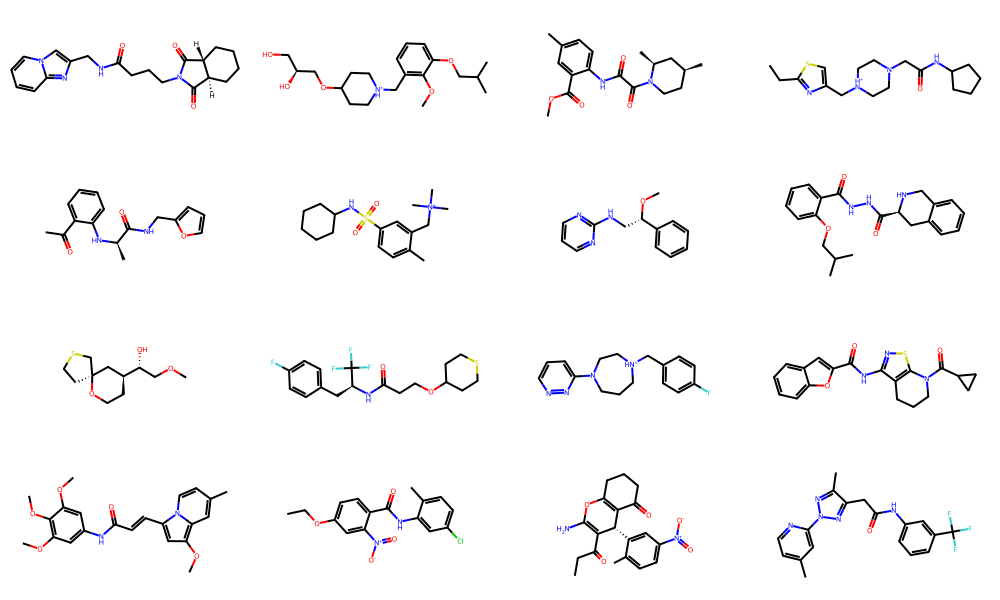

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22CC1ccc((C2)n(CO)(=O)c11C)CC)C
pred_mu smi: CC1ccc(C22CC1ccc((C2)n(=O)(=O)c1cC)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 403.14it/s]


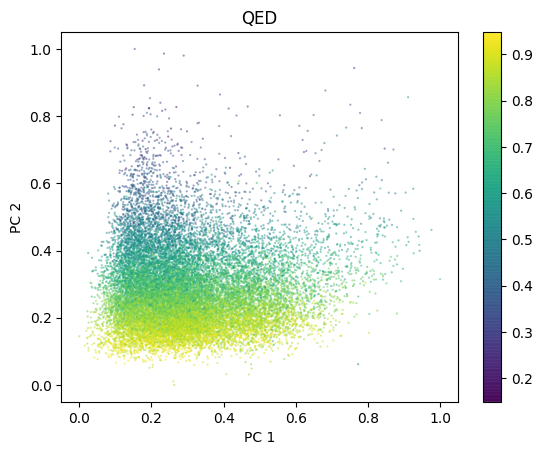

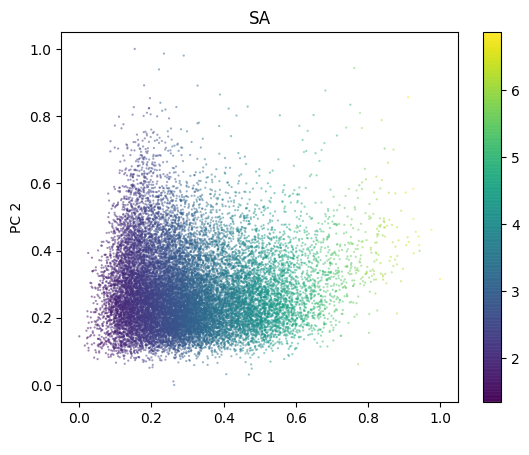

####################
save model ckpt.pt


 34%|███▍      | 116/342 [00:18<00:35,  6.39it/s]

Epoch 42: 114/342 | ['loss=0.05595', '(kl=0.00016', 'recon=0.05563)', 'classify=0.00051', 'klw=0.42000 lr=0.00043']


 67%|██████▋   | 230/342 [00:36<00:17,  6.50it/s]

Epoch 42: 228/342 | ['loss=0.11145', '(kl=0.00030', 'recon=0.11085)', 'classify=0.00095', 'klw=0.42000 lr=0.00043']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 399.08it/s]


valid 92.000%  |  unique 92.000%


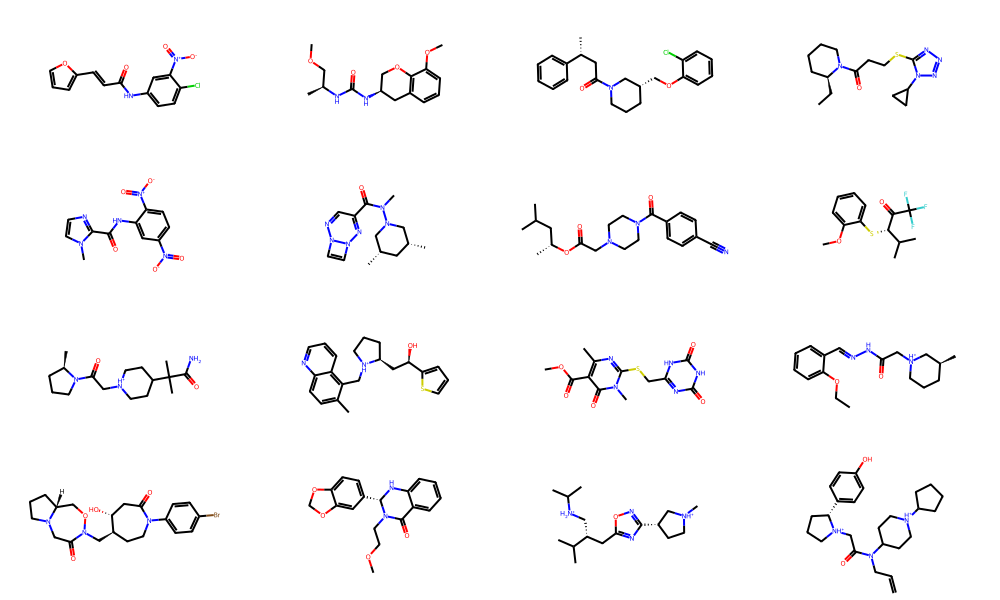

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22CC1ccc((C2)n(CO)(=O)c1cC)CC)C
pred_mu smi: CC1ccc(C22CC1ccc((C2)n(=O)(=O)c1cC)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 403.23it/s]


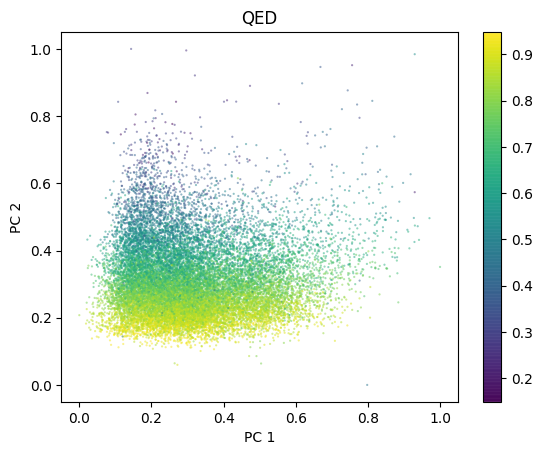

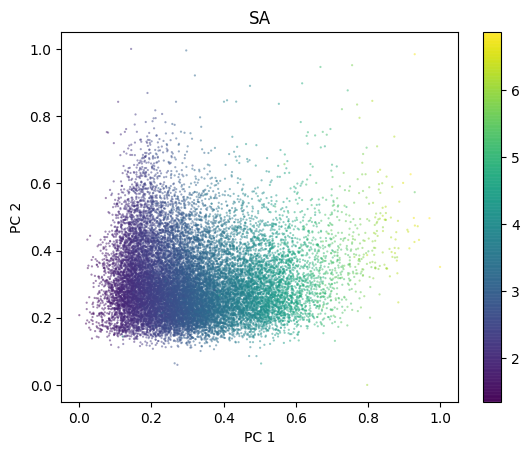

####################
save model ckpt.pt


 34%|███▍      | 116/342 [00:18<00:35,  6.45it/s]

Epoch 43: 114/342 | ['loss=0.05573', '(kl=0.00014', 'recon=0.05544)', 'classify=0.00045', 'klw=0.43000 lr=0.00039']


 67%|██████▋   | 230/342 [00:35<00:17,  6.32it/s]

Epoch 43: 228/342 | ['loss=0.11104', '(kl=0.00027', 'recon=0.11049)', 'classify=0.00086', 'klw=0.43000 lr=0.00039']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 402.62it/s]


valid 91.333%  |  unique 91.333%


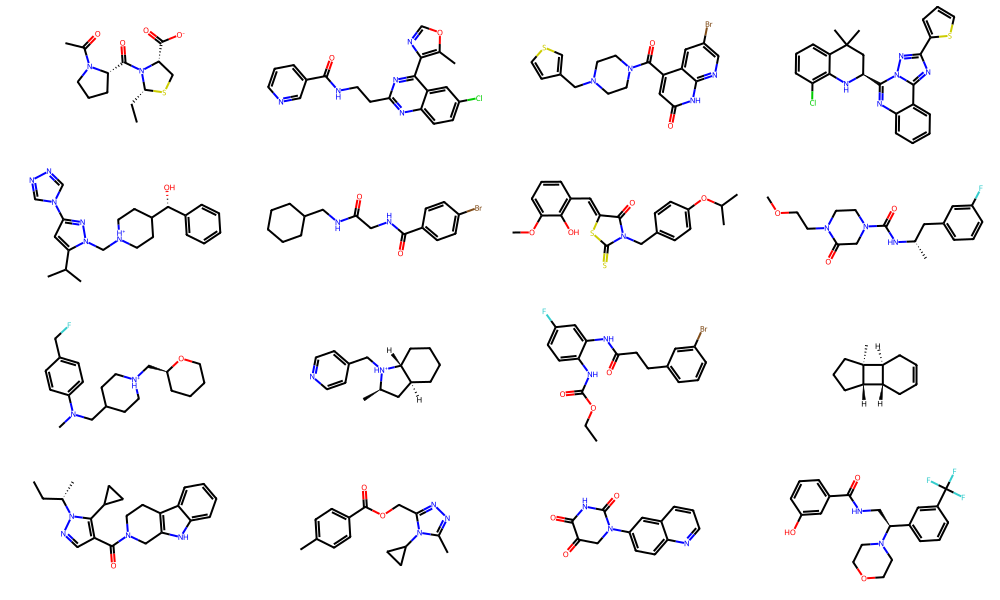

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22CC1ccc((C2)[(=O)(=O)c(1C)CC)C
pred_mu smi: CC1ccc(C22CC1ccc((C2)n(=O)(=O)c(cC)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 402.16it/s]


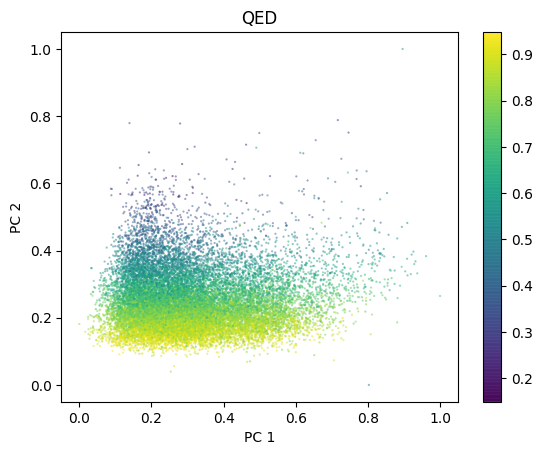

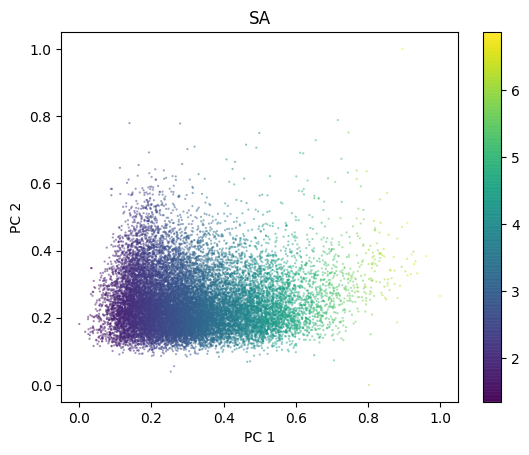

 34%|███▍      | 116/342 [00:18<00:37,  6.07it/s]

Epoch 44: 114/342 | ['loss=0.05556', '(kl=0.00013', 'recon=0.05529)', 'classify=0.00044', 'klw=0.44000 lr=0.00037']


 67%|██████▋   | 230/342 [00:36<00:17,  6.43it/s]

Epoch 44: 228/342 | ['loss=0.11064', '(kl=0.00025', 'recon=0.11012)', 'classify=0.00082', 'klw=0.44000 lr=0.00037']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 400.75it/s]


valid 92.000%  |  unique 92.000%


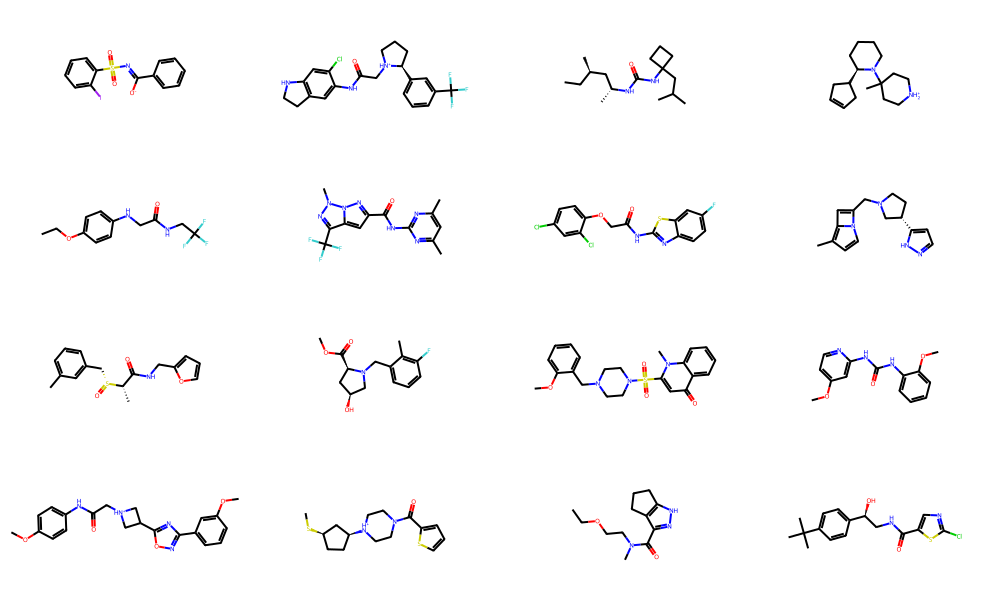

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22CC1ccc((C2=n(CO)(=O)c1cC)CC)C
pred_mu smi: CC1ccc(C22CC1ccc((C2)n(=O)(=O)c(cC)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 402.12it/s]


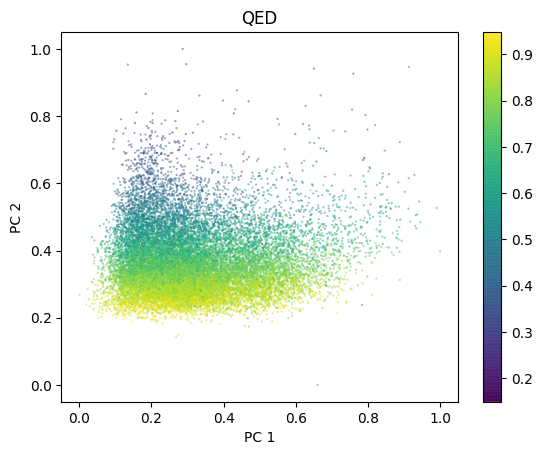

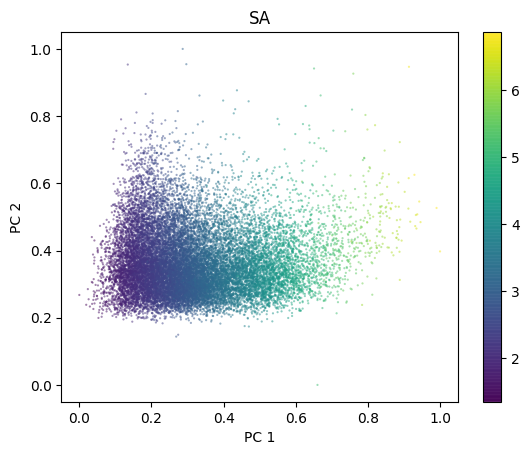

 34%|███▍      | 116/342 [00:18<00:35,  6.35it/s]

Epoch 45: 114/342 | ['loss=0.05527', '(kl=0.00013', 'recon=0.05501)', 'classify=0.00040', 'klw=0.45000 lr=0.00034']


 67%|██████▋   | 230/342 [00:36<00:17,  6.40it/s]

Epoch 45: 228/342 | ['loss=0.11017', '(kl=0.00024', 'recon=0.10967)', 'classify=0.00078', 'klw=0.45000 lr=0.00034']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 402.12it/s]


valid 92.100%  |  unique 92.100%


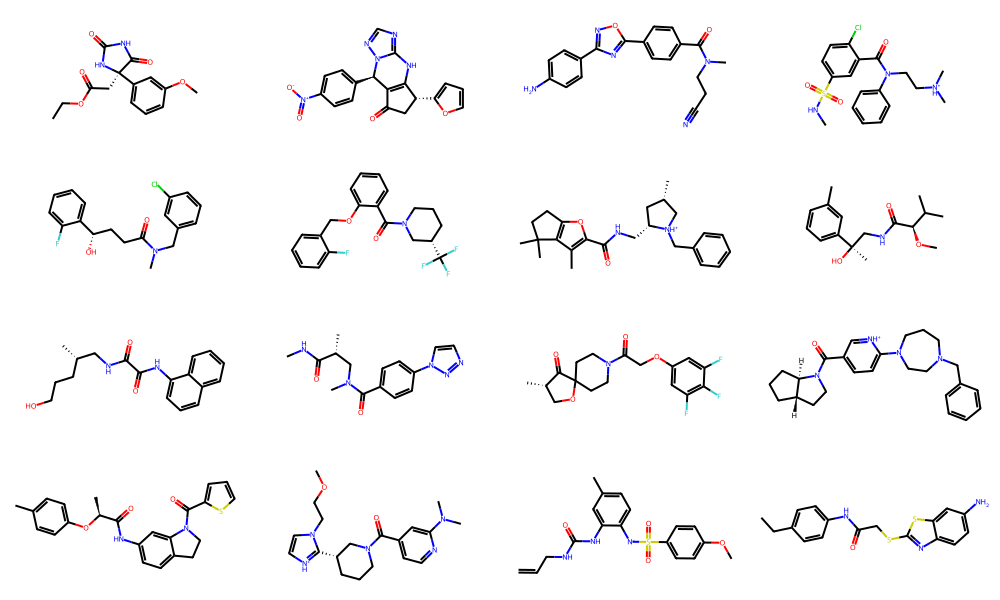

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22CC1ccc((C2)O(=O)(=O)c1cC)CC)C
pred_mu smi: CC1ccc(C22CC1ccc((C2)n(=O)(=O)c((C)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid: 100%|██████████| 20000/20000 [00:49<00:00, 403.72it/s]


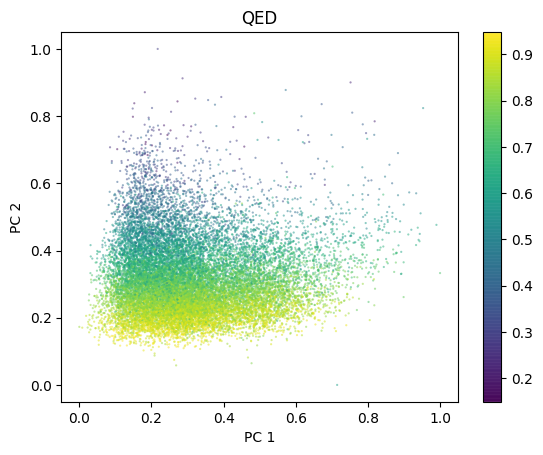

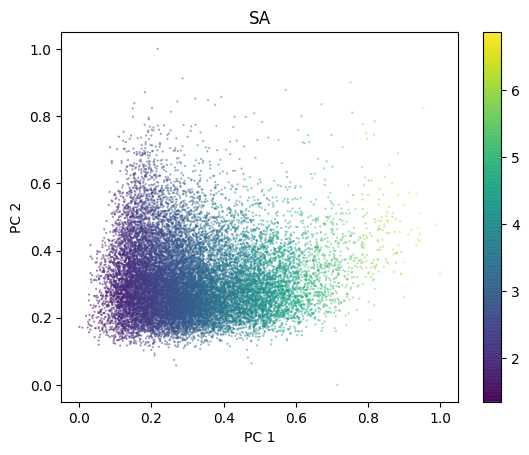

####################
save model ckpt.pt


 34%|███▍      | 116/342 [00:18<00:36,  6.17it/s]

Epoch 46: 114/342 | ['loss=0.05510', '(kl=0.00011', 'recon=0.05486)', 'classify=0.00038', 'klw=0.46000 lr=0.00032']


 67%|██████▋   | 230/342 [00:36<00:17,  6.57it/s]

Epoch 46: 228/342 | ['loss=0.10985', '(kl=0.00021', 'recon=0.10938)', 'classify=0.00075', 'klw=0.46000 lr=0.00032']


Generating samples: 100%|██████████| 3000/3000 [00:07<00:00, 401.72it/s]


valid 92.167%  |  unique 92.167%


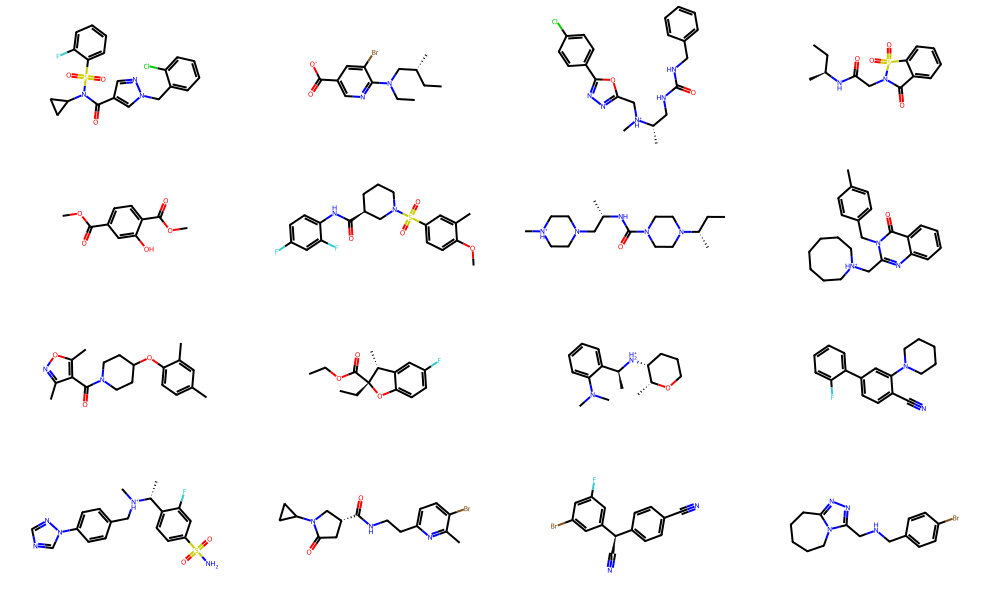

fed smi    : Cc1cnc(nc1Nc1cccc(c1)S(=O)(=O)NC(C)(C)C)Nc1ccc(cc1)OCCN1CCCC1
pred_z  smi: CC1ccc(C22CC1ccc((C2)O(CO)(=O)c1cC)CC)C
pred_mu smi: CC1ccc(C22CC1ccc((C2)n(=O)(=O)c(1C)CC)C
pred_z  mol is none, cannot recon
pred_mu mol is none, cannot recon


cal QED/SA, delete invalid:  43%|████▎     | 8531/20000 [00:21<00:29, 392.65it/s]

In [ ]:

# fit(model, train['smiles'])  # train without classifier

# train_loader = get_dataloader(model, test['smiles'], shuffle=True) # previous loader
# fit(model, train['smiles'], val_data=None, classifier=None) # no classifier thus no need label
model = VAE(vocab,vector).to(device)


# could use loader = gen_loader(test[:50000]), need to set classifier=True because this loader have labels
# train_loader = gen_loader(train)

fit(model, train_loader, val_data=None, classifier=True)


In [12]:
import shutil
model_path = "/content/drive/MyDrive/A_MODEL/LSTM_VAE_char2id/ckpt_no_classifier.pt"
# shutil.move("/content/ckpt.pt", model_path)


# import pandas as pd

# def gen_loader(train):

#     from torch.nn.utils.rnn import pad_sequence
#     from torch.utils.data import DataLoader
#     def my_collate(batch):
#         # batch contains a list of tuples of structure (sequence, target)
#         data = [item[0] for item in batch]
#         data = pad_sequence(data, batch_first=True, padding_value=c2i['<pad>'])
#         # targets = [item[1] for item in batch]
#         targets = [item[1] for item in batch]
#         targets = torch.stack(targets)
#         return (data, targets)
#     df = convert_with_qed_sa(train)
#     loader = DataLoader(dataset(df, device=device), batch_size=n_batch,
#                         shuffle=True, num_workers=n_workers,
#                         collate_fn=my_collate)

#     print('loader finished')
#     return loader

In [13]:
best_model_path = model_path

def load_model(model, path):
    cuda = torch.cuda.is_available()
    if cuda: device = 'cuda'
    else: device = 'cpu'
    model.load_state_dict(torch.load(path, map_location=device))

model = VAE(vocab, vector).to(device)
load_model(model, best_model_path)

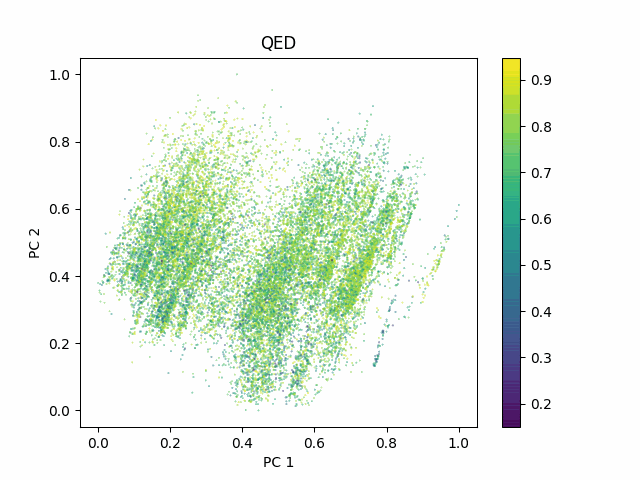

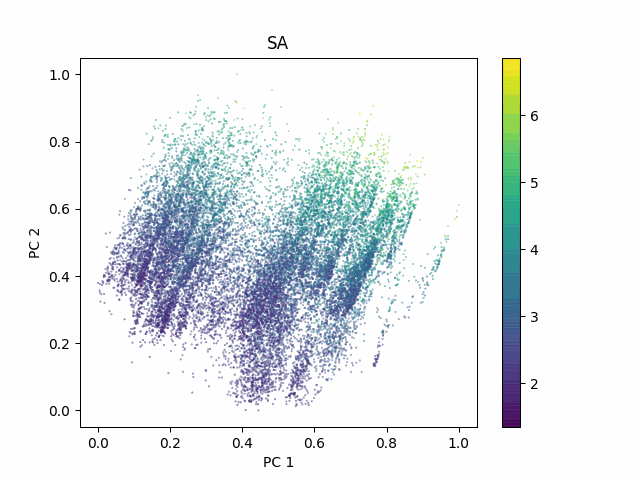

In [30]:
import imageio

path = 'QED'
from os import walk
# files = next(walk(path), (None, None, []))[2]
# files
for path in ['QED', 'SA']:
    images = []
    for i in range(9):
        file_name = path + f'/{i}.png'
        images.append(imageio.imread(file_name))
    imageio.mimsave(f'{path}.gif', images, duration=.001)
    from IPython.display import Image
    gif_path = f'{path}.gif'
    display(Image(data=open(gif_path,'rb').read(), format='png'))

$z \sim \mathcal{N}(0, I)$

In [ ]:
from sklearn.manifold import TSNE

Z_tsne = TSNE(n_components=2).fit_transform(new_mu.cpu().detach().numpy())
Z_tsne = MinMaxScaler().fit_transform(Z_tsne)
df = pd.DataFrame(np.transpose((Z_tsne[:,0],Z_tsne[:,1])))
df.columns = ['x','y']
for prop_opt in ['QED', 'SA']:
    df[prop_opt]= props[prop_opt]

    plt.scatter(x=df['x'], y=df['y'], c=df[prop_opt],
                cmap= 'viridis', marker='.',
                s=10,alpha=0.5, edgecolors='none')
    cbar = plt.colorbar()
    cbar.solids.set_edgecolor("face")
    # draw()
    plt.title(prop_opt)
    plt.show()


NameError: ignored

Since PCA is not ideal, sample from latent space and visualize

In [ ]:
# def sample_z_prior(self,n_batch):
z_sam = model.sample_z_prior(n_batch)

sample_smis = model.sample(n_batch, max_len=100, z=z_sam)

valid 88.672%  |  unique 88.672%


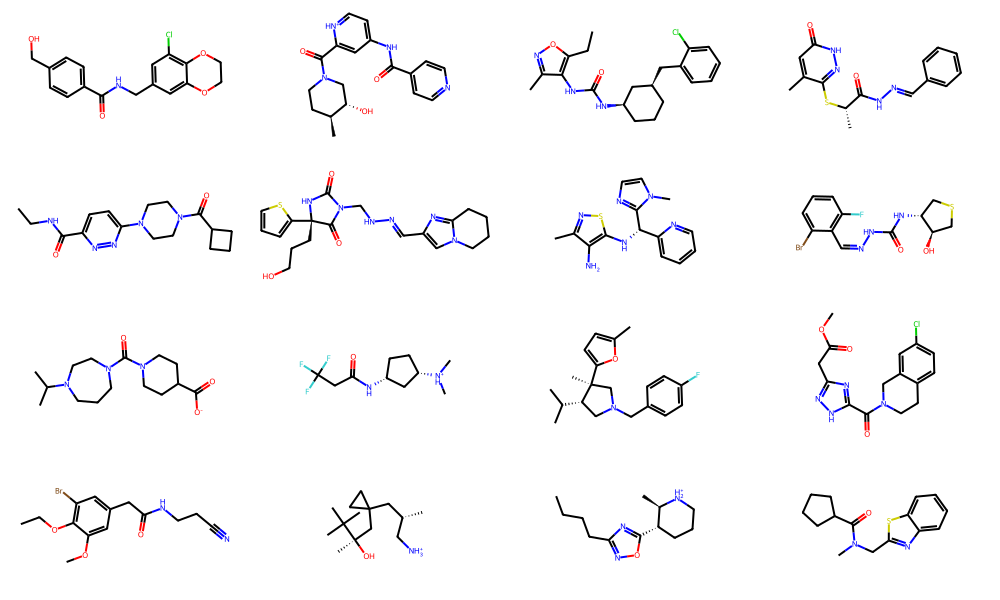

In [ ]:
len(sample_smis)
samples = pd.DataFrame(sample_smis, columns=['SMILES'])
valid_smis_df = visual_mols(samples, return_valid_rate=False)

In [ ]:
valid_smis_df

,smiles
0,OCc1ccc(C(=O)NCc2cc(Cl)c3c(c2)OCCO3)cc1
1,C[C@H]1CCN(C(=O)c2cc(NC(=O)c3ccncc3)cc[nH+]2)C...
2,CCc1onc(C)c1NC(=O)N[C@@H]1CCC[C@H](Cc2ccccc2Cl)C1
3,Cc1cc(=O)[nH]nc1S[C@@H](C)C(=O)N/N=C/c1ccccc1
4,CCNC(=O)c1ccc(N2CCN(C(=O)C3CCC3)CC2)nn1
...,...
449,C[C@@H](NC(=O)N[C@@H](C)c1ccccc1O)c1ccc2c(c1)O...
450,CC1(C)c2nc(C(=O)Nc3ccc4c(c3)OCCO4)ccc2N1S(C)(=...
451,C[S@](=O)c1cccc(NC(=O)[C@@H]2CN(CCCO)CCO2)c1
452,Cc1ccc2ncc([C@@H](C)[NH2+]C(c3ccco3)Cc3cccs3)n2c1


In [ ]:
model.eval()

#  def sample(self,n_batch, max_len=100, z=None, temp=1.0):

class sample():
    def take_samples(model,n_batch, max_len=max_len, n_samples=n_samples):
        n = n_samples
        samples = []
        with tqdm(total=n_samples, desc='Generating samples') as T:
            while n > 0:
                current_samples = model.sample(min(n, n_batch), max_len)
                samples.extend(current_samples)
                n -= len(current_samples)
                T.update(len(current_samples))
        samples = pd.DataFrame(samples, columns=['SMILES'])
        return samples

sample_smis = sample.take_samples(model, n_batch, max_len=100, n_samples=50000)
valid_smis_df = visual_mols(sample_smis, return_valid_rate=False)

In [ ]:
valid_smis = []
for i in sample_smis['SMILES']:
    try:
        mol = m(i)
        if mol != None: valid_smis.append(i)
    except: pass
len(valid_smis)

In [ ]:
def convert_with_qed_sa(train):
    smi_list = train['smiles'].tolist()
    smile_list = []
    qed_list = []
    sa_list = []
    for i, smi in tqdm(enumerate(smi_list), total=len(smi_list)):
        try:
            qed_ = qed(smi)
            sa_ = sa(smi)
            smile_list.append(smi)
            qed_list.append(qed_)
            sa_list.append(sa_)
        except: pass

    df = pd.DataFrame()
    df['smiles'] = pd.DataFrame(smile_list)
    df['qed'] = pd.DataFrame(qed_list)
    df['sa'] = pd.DataFrame(sa_list)
    df = df.reset_index(drop=True)
    return df

def gen_loader(train):

    from torch.nn.utils.rnn import pad_sequence
    from torch.utils.data import DataLoader
    def my_collate(batch):
        # batch contains a list of tuples of structure (sequence, target)
        data = [item[0] for item in batch]
        data = pad_sequence(data, batch_first=True, padding_value=c2i['<pad>'])
        # targets = [item[1] for item in batch]
        targets = [item[1] for item in batch]
        targets = torch.stack(targets)
        return (data, targets)
    df = convert_with_qed_sa(train)
    loader = DataLoader(dataset(df, device=device), batch_size=n_batch,
                        shuffle=True, num_workers=n_workers,
                        collate_fn=my_collate)

    print('loader finished')
    return loader

In [ ]:
# loader = gen_loader(pd.DataFrame(valid_smis_df, columns=['smiles']))
def load_model(model, path):
    cuda = torch.cuda.is_available()
    if cuda: device = 'cuda'
    else: device = 'cpu'
    model.load_state_dict(torch.load(path, map_location=device))

model = VAE(vocab, vector).to(device)
load_model(model, 'cpkt.pt')



In [ ]:

for idx, (i, j) in enumerate(loader):
    z, mu, _ = model.forward_encoder(i)
    if idx == 0:
        new_mu = mu
        new_label = j
    else:
        new_mu = torch.cat([new_mu, mu], dim=0)
        new_label = torch.cat([new_label, j], dim=0)

print(new_mu.shape, new_label.shape)

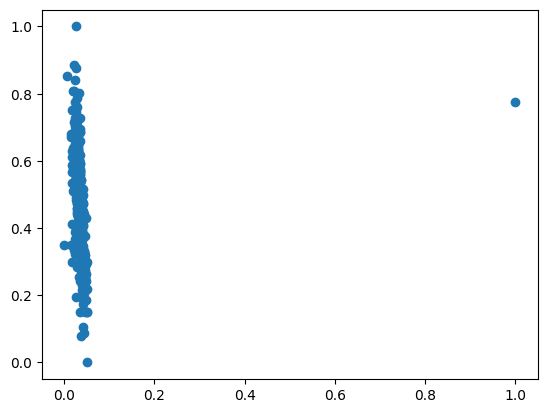

In [ ]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt

Z_pca = PCA(n_components=2).fit_transform(new_mu.cpu().detach().numpy())
Z_pca = MinMaxScaler().fit_transform(Z_pca)
df = pd.DataFrame(np.transpose((Z_pca[:,0],Z_pca[:,1])))
df.columns = ['x','y']
# props = pd.DataFrame(new_label.cpu().detach().numpy(), columns=['QED', 'SA'])
# df['QED'] = props['QED']
# df['SA'] = props['SA']
# for prop_opt in ['QED', 'SA']:
#     df[prop_opt]= props[prop_opt]

plt.scatter(x=df['x'], y=df['y'])

# plt.scatter(x=df['x'], y=df['y'], c=pd.DataFrame([1]*len(z_sam), columns=['test']),
#             cmap= 'viridis', marker='.',
#             s=10,alpha=0.5, edgecolors='none')
# cbar = plt.colorbar()
# cbar.solids.set_edgecolor("face")
# # draw()
# plt.title(prop_opt)
# plt.show()


cal QED/SA, delete invalid: 100%|██████████| 49891/49891 [02:07<00:00, 392.25it/s]


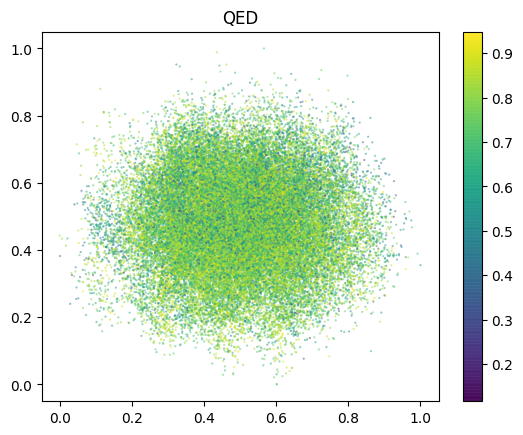

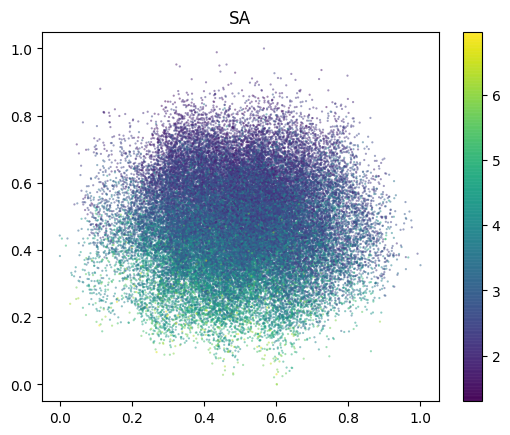

In [19]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt

# do pca and normalize
Z_pca = PCA(n_components=2).fit_transform(mus)
Z_pca = MinMaxScaler().fit_transform(Z_pca)
df = pd.DataFrame(np.transpose((Z_pca[:,0],Z_pca[:,1])))
df.columns = ['x','y']
props = pd.DataFrame(labels, columns=['QED', 'SA'])
df['QED'] = props['QED']
df['SA'] = props['SA']
for prop_opt in ['QED', 'SA']:
    df[prop_opt]= props[prop_opt]

    plt.scatter(x=df['x'], y=df['y'], c=df[prop_opt],
                cmap= 'viridis', marker='.',
                s=10,alpha=0.5, edgecolors='none')
    cbar = plt.colorbar()
    cbar.solids.set_edgecolor("face")
    # draw()
    plt.title(prop_opt)
    plt.show()


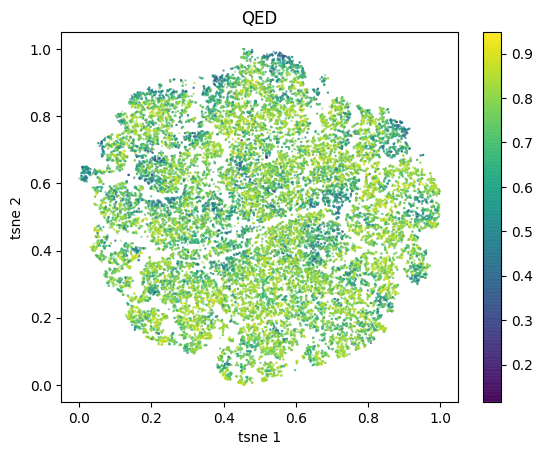

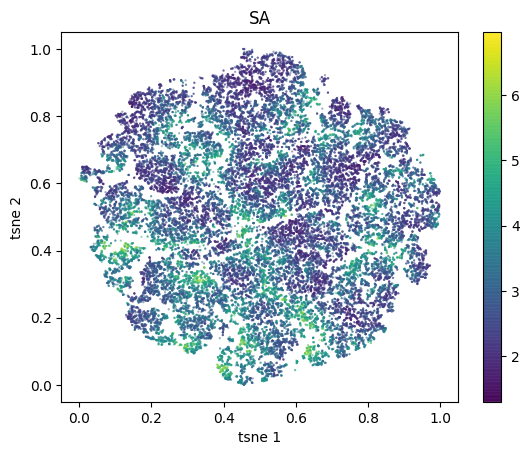

In [20]:
from sklearn.manifold import TSNE

Z_tsne = TSNE(n_components=2).fit_transform(mus)
Z_tsne = MinMaxScaler().fit_transform(Z_tsne)
df = pd.DataFrame(np.transpose((Z_tsne[:,0],Z_tsne[:,1])))
df.columns = ['x','y']
for prop_opt in ['QED', 'SA']:
    df[prop_opt]= props[prop_opt]

    plt.scatter(x=df['x'], y=df['y'], c=df[prop_opt],
                cmap= 'viridis', marker='.',
                s=10,alpha=0.5, edgecolors='none')
    cbar = plt.colorbar()
    cbar.solids.set_edgecolor("face")
    # draw()
    plt.xlabel('tsne 1')
    plt.ylabel('tsne 2')
    plt.title(prop_opt)
    plt.show()

In [34]:
import shutil
model_path = "/content/drive/MyDrive/A_MODEL/LSTM_VAE_char2id/ckpt_classifier_08_31.pt"
shutil.move("/content/ckpt.pt", model_path)


'/content/drive/MyDrive/A_MODEL/LSTM_VAE_char2id/ckpt_classifier_08_31.pt'

In [17]:
def load_model(model, path):
    cuda = torch.cuda.is_available()
    if cuda: device = 'cuda'
    else: device = 'cpu'
    model.load_state_dict(torch.load(path, map_location=device))

model = VAE(vocab, vector).to(device)
model_path = "/content/drive/MyDrive/A_MODEL/LSTM_VAE_char2id/ckpt_classifier_08_31.pt"

load_model(model, model_path)


In [15]:
mol_num = 50000
if mol_num > len(test): loader = gen_loader(test)
else: loader = gen_loader(test.sample(n=mol_num, random_state=1))

cal QED/SA, delete invalid: 100%|██████████| 49891/49891 [02:03<00:00, 404.90it/s]


In [18]:
model = model.cpu()
model.eval()
for idx, (i, j) in tqdm(enumerate(loader), total=len(loader)):
    i, j = i.cpu(), j.cpu()
    _,  mu, _ = model.forward_encoder(i)
    mu_cpu = mu.cpu()
    j_cpu = j.cpu()
    del i
    del j
    del mu
    if idx == 0:
        new_mu = mu_cpu
        new_label = j_cpu
    else:
        new_mu = torch.cat([new_mu, mu_cpu], dim=0)
        new_label = torch.cat([new_label, j_cpu], dim=0)

mus = new_mu.cpu().detach().numpy()
labels = new_label.cpu().detach().numpy()

100%|██████████| 98/98 [00:39<00:00,  2.48it/s]


In [17]:
i.shape

torch.Size([227, 87])

In [19]:
model.forward_encoder(i)

AttributeError: ignored